<span style='font-size: 30px;'><b><br>Мастерская - 2. Мэтчинг товаров.</b><span><br>
<span style='font-size: 14px;'>Выполнил: Евгений Побежимовский, telegram: @epobezhimovskiy</span>

<br>

**Дано:**<br>
Два множества объектов: A и B. Каждый объект множества описывается какими-то признаками.

**Желаемый результат:**<br>
Для каждого объекта из множества A найти один или несколько объектов из B, которые близки к нему по некоторой заданной метрике.<br>
 \* A и B могут быть одним и тем же множеством<br>
 ** Можем и не найти ни одного соответствия
<br><br>


<span style='font-size: 18px;'><b>Цель исследования</b><span>

- разработать алгоритм, который для всех товаров из validation.csv предложит несколько вариантов наиболее похожих товаров из base;
- оценить качество алгоритма по метрике accuracy@5:<br><br>
    $accuracy@5 = 100 * \frac{n}{5}$<br><br>
    где n - количество верно определённых похожих объектов из 5 возможных.
<br><br>  


<span style='font-size: 18px;'><b>Описание данных</b><span>

Предоставлены данные в 4 файлах:

- `base.csv` - анонимизированный набор товаров. Каждый товар представлен как уникальный id (0-base, 1-base, 2-base) и вектор признаков размерностью 72.
- `train.csv` - обучающий датасет. Каждая строчка - один товар, для которого известен уникальный id (0-query, 1-query, …), вектор признаков И id товара из base.csv, который максимально похож на него (по мнению экспертов).
- `validation.csv` - датасет с товарами (уникальный id и вектор признаков), для которых надо найти наиболее близкие товары из base.csv
- `validation_answer.csv` - правильные ответы к предыдущему файлу 'validation.csv'.

<br><br>


<span style='font-size: 18px;'><b>Ход выполнения</b><span>

Шаг 1. Загрузка файла с данными<br>
Шаг 2. Предобработка данных<br>
&emsp;&emsp;2.1. Наименование столбцов<br>
&emsp;&emsp;2.2. Пропуски<br>
&emsp;&emsp;2.3. Типы данных<br>
&emsp;&emsp;2.4. Дубликаты<br>
&emsp;&emsp;2.5. Неявные дубликаты и аномалии<br>
Шаг 3. Исследовательский анализ данных<br>
&emsp;&emsp;3.1. Индивидуальный анализ признаков<br>
&emsp;&emsp;3.2. Добавление новых столбцов<br>
&emsp;&emsp;3.3. Анализ корреляции признаков<br>
Шаг 4. Подготовка данных<br>
Шаг 5. Обучение моделей<br>
Шаг 6. Анализ моделей<br>
Шаг 7. Общий вывод<br>
Шаг 8. Баг-репорт<br>

<span style='font-size: 24px;'><b>Импорт библиотек, настройки, константы, объявление функций</b><span>
<br>

Выполним установку необходимых библиотек.<br>

In [1]:
# выполняю установку библиотек в "тихом" режиме
! pip install -q phik
! pip install -q sweetviz
! pip install -q kneed
! pip install -q faiss-cpu==1.7.4

Импортируем библиотеки используемые в проекте.

In [2]:
# импортирую библиотеки
import numpy as np
import pandas as pd
import os
import time
import math
import matplotlib.pyplot as plt
import statsmodels.api as sm
import seaborn as sns
from scipy import stats as st
from IPython.display import display
import warnings

import phik
import sweetviz as sv
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.neighbors import NearestNeighbors
from kneed import KneeLocator
from scipy.cluster.hierarchy import dendrogram, linkage
import faiss

Выполним настройки и зададим константы.

In [3]:
# задаю настройки
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
pd.options.display.float_format ='{:,.3f}'.format
sns.set_theme(style='whitegrid', palette='pastel')
sns.set_context(
    'notebook', 
    rc={
        'font.size':12,
        'axes.titlesize':16,
        'axes.labelsize':12,
        'legend.fontsize':12,
        'figure.figsize':(14, 7)
    }
)
warnings.simplefilter(action='ignore', category=FutureWarning)
pd.options.mode.chained_assignment = None

# задаю класс для стилизации вывода метода .print()
class color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

# создаю константу для фиксации объектов тренировочной и тестовой выборок
RANDOM_STATE = 42

Создадим функцию для исследовательского анализа данных, что оптимизирует процесс описания данных.

In [4]:
# создаю функцию для описания данных
def describe_data(d_fr, d_col):

    """
    describe_data(d_fr, d_col)
    
    Функция для статического и графического описания данных признака датасета.
    
    Для числовых колонок (не дискретных: с числом уникальных значений > 25) 
    представлен набор из 15 характеристик - расширенная версия метода .describe().
    Графики: гистограмма (bins=30), квантильный-квантильный, диаграмма размаха.
    
    Для числовых дискретных колонок (с числом уникальных значений <= 25)
    выводятся стандартные характеристики метода .describe() с кол-вом пропусков.
    Графики: горизонтальный столбчатый график, круговая диаграмма.
    
    Для категориальных и числовых дискретных колонок
    выводятся стандартные характеристики метода .describe() с кол-вом пропусков.
    Графики: горизонтальный столбчатый график, круговая диаграмма.
    
    Для столбцов с датами выводятся характеристики метода .describe(),
    также количество уникальных значений, пропусков, доли топ-10 по частоте значений.
    График: гистограмма по году
    
    Аргументы функции:
        d_fr - датафрейм
        d_col - наименование колонки
    
    Пример использования:
        data = pd.read_csv('my_file.csv')
        describe_data(data, 'my_column')
    """


# в зависимости от типа данных в столбце строю разные типы графиков

# ЧИСЛОВОЙ столбец (с количеством уникальных значений больше 25)
    if  d_fr[d_col].dtypes != "object" and \
        d_fr[d_col].dtypes != "datetime64[ns]" and \
        len(d_fr[d_col].unique()) > 25:
        
        # описываю статистические параметры столбца данных
        print('\n' + color.BOLD + color.BLUE + \
              f'Описание столбца (числовой, type: {d_fr[d_col].dtypes}):' + \
              color.END)
        display(
            pd.DataFrame(
                data={
                    'Значения': 
                    [
                        d_fr[d_col].describe()[0],
                        d_fr[d_col].isna().sum(),
                        len(d_fr[d_col].unique()),
                        d_fr[d_col].mode()[0],
                        d_fr[d_col].describe()[1],
                        d_fr[d_col].var(),
                        d_fr[d_col].describe()[2],
                        d_fr[d_col].std() / math.sqrt(len(d_fr[d_col])),
                        d_fr[d_col].describe()[3],
                        d_fr[d_col].describe()[4],
                        d_fr[d_col].describe()[5],
                        d_fr[d_col].describe()[6],
                        d_fr[d_col].describe()[7],
                        d_fr[d_col].max() - d_fr[d_col].min(),
                        st.shapiro(d_fr[d_col]).statistic
                      ]}, 
                index=[
                        'Количество',
                        'Пропуски',
                        'Уникальных',
                        'Мода',
                        'Среднее арифметическое',
                        'Дисперсия',
                        'Стандартное отклонение',
                        'Ошибка выборочного среднего',
                        'Минимум',
                        'Квартиль 25%',
                        'Медиана',
                        'Квартиль 75%',
                        'Максимум',
                        'Размах',
                        'Тест Шапиро-Вилка'
                    ]
            )
        )
        print()
        
        # делаю сетку для 3 графиков методом subplots
        fig, axs = plt.subplots(1, 3, sharex=False, sharey=False, figsize=(15, 5))
    
        # гистограмма
        sns.histplot(
            d_fr[d_col], 
            bins=30, 
            # kde=True, 
            ax=axs[0]
        )
        axs[0].ticklabel_format(axis='x')
        axs[0].set_xlabel('\n ' + d_col.capitalize())
        axs[0].set_ylabel('Количество \n')
        axs[0].set_title('Гистограмма \n для ' + d_col.capitalize() + '\n', 
                         color='black', fontweight ='bold')
        axs[0].grid(linestyle='--')

        # QQ plot
        sm.qqplot(
            d_fr[d_col], 
            line='s', 
            ax=axs[1]
        )
        axs[1].set_xlabel('\n Theoretical Quantiles')
        axs[1].set_ylabel('Sample Quantiles \n')
        axs[1].set_title('«Квантильный-квантильный»\n график \n', color='black', fontweight='bold')
        axs[1].grid(linestyle='--')
        
        # диаграмма размаха
        sns.boxplot(
            y=d_fr[d_col], 
            ax=axs[2]
        )
        axs[2].ticklabel_format(axis='y')
        axs[2].set_xlabel('\n ' + d_col.capitalize())
        axs[2].set_ylabel('Значение \n')
        axs[2].set_title('Диаграмма размаха \n для ' + d_col.capitalize() + '\n', 
                         color='black', fontweight ='bold')
        axs[2].grid(linestyle='--')
    
    
    
# ЧИСЛОВОЙ ДИСКРЕТНЫЙ столбец (с количеством уникальных значений меньше или равно 25)
    elif d_fr[d_col].dtypes != "object" and \
        d_fr[d_col].dtypes != "datetime64[ns]" and \
        len(d_fr[d_col].unique()) <= 25:
    
        # описываю статистические параметры столбца данных
        print('\n' + color.BOLD + color.BLUE + \
              f'Описание столбца (числовой дискретный, type: {d_fr[d_col].dtypes}):' + \
              color.END)
        display(
            pd.DataFrame(
                data={
                    'Значения': 
                    [
                        d_fr[d_col].describe()[0],
                        d_fr[d_col].isna().sum(),
                        len(d_fr[d_col].unique()),
                        d_fr[d_col].describe()[1],
                        d_fr[d_col].describe()[2],
                        d_fr[d_col].describe()[3],
                        d_fr[d_col].describe()[4],
                        d_fr[d_col].describe()[5],
                        d_fr[d_col].describe()[6],
                        d_fr[d_col].describe()[7]
                      ]}, 
                index=[
                        'Количество',
                        'Пропуски',
                        'Уникальных',
                        'Среднее арифметическое',
                        'Стандартное отклонение',
                        'Минимум',
                        '25%',
                        '50% (медиана)',
                        '75%',
                        'Максимум'
                    ])
        )
        
        print('\n' + color.BOLD + color.BLUE + \
              'Доля уникальных значений (max 15 кат.)' + \
              color.END)
        display(d_fr[d_col].value_counts(normalize=True).reset_index().head(15))
        
        print()
        
        # делаю сетку для 2 графиков методом subplots
        fig, axs = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(12, 5))
        
        # строю столбчатый график
        plt.subplot(1, 2, 1)
        sns.barplot(
            x=d_fr[d_col].value_counts().head(15).index,
            y=d_fr[d_col].value_counts().head(15),
            ).set_title('Частота встречаемости ' + d_col.capitalize() + '\n', 
                  color='black', fontweight ='bold')
        plt.xlabel(d_col.capitalize() + '\n')
        plt.ylabel('\n Количество')
        plt.xticks(rotation=45)
        plt.grid(axis='x', linestyle='--')

        # строю круговую диаграмму
        plt.subplot(1, 2, 2)
        plt.pie(
                d_fr[d_col].value_counts().head(15), 
                autopct='%.1f%%', 
                wedgeprops= {'linewidth':3, 'edgecolor':'white'}, 
                startangle=90, 
                counterclock=False
                )
        plt.title('Доля ' + d_col.capitalize() + '\n', 
                  color='black', fontweight ="bold")
        plt.legend(d_fr[d_col].value_counts().index, bbox_to_anchor=(1, 1))



# КАТЕГОРИАЛЬНЫЙ столбец
    elif d_fr[d_col].dtypes == "object" or \
        (d_fr[d_col].dtypes != "datetime64[ns]" and len(d_fr[d_col].unique()) <= 25):
    
        # описываю статистические параметры столбца данных
        print('\n' + color.BOLD + color.BLUE + \
              f'Описание столбца (категориальный, type: {d_fr[d_col].dtypes}):' + \
              color.END)
        display(
            pd.DataFrame(
                data={
                    'Значения': 
                    [
                        d_fr[d_col].describe()[0],
                        d_fr[d_col].isna().sum(),
                        d_fr[d_col].describe()[1],
                        d_fr[d_col].describe()[2],
                        d_fr[d_col].describe()[3],
                      ]}, 
                index=[
                        'Количество',
                        'Пропуски',
                        'Уникальных',
                        'Самое частое (знач.)',
                        'Самое частое (кол-во)'
                    ])
        )
        
        print('\n' + color.BOLD + color.BLUE + \
              'Доля уникальных значений (max 15 кат.)' + \
              color.END)
        display(d_fr[d_col].value_counts(normalize=True).reset_index().head(15))
        
        print()
        
        # делаю сетку для 2 графиков методом subplots
        fig, axs = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(12, 5))
        
        # строю столбчатый график
        plt.subplot(1, 2, 1)
        sns.barplot(
            x=d_fr[d_col].value_counts().head(15),
            y=d_fr[d_col].value_counts().head(15).index,
            ).set_title('Частота встречаемости ' + d_col.capitalize() + '\n', 
                  color='black', fontweight ='bold')
        plt.xlabel('\n Количество')
        plt.ylabel(d_col.capitalize() + '\n')
        plt.grid(axis='x', linestyle='--')

        # строю круговую диаграмму
        plt.subplot(1, 2, 2)
        plt.pie(
                d_fr[d_col].value_counts().head(15), 
                autopct='%.1f%%', 
                wedgeprops= {'linewidth':3, 'edgecolor':'white'}, 
                startangle=90, 
                counterclock=False
                )
        plt.title('Доля ' + d_col.capitalize() + '\n', 
                  color='black', fontweight ="bold")
        plt.legend(d_fr[d_col].value_counts().index, bbox_to_anchor=(1, 1))
    
    
    
# ДАТЫ
    elif d_fr[d_col].dtypes == "datetime64[ns]":
        print('\n' + color.BOLD + color.BLUE + \
              f'Описание столбца (даты, type: {d_fr[d_col].dtypes}):' + \
              color.END)
        display(
            pd.DataFrame(
                data={
                    'Значения': 
                    [
                        d_fr[d_col].describe()[0],
                        d_fr[d_col].isna().sum(),
                        len(d_fr[d_col].unique()),
                        d_fr[d_col].describe()[1],
                        d_fr[d_col].describe()[2],
                        d_fr[d_col].describe()[3],
                        d_fr[d_col].describe()[4],
                        d_fr[d_col].describe()[5],
                        d_fr[d_col].describe()[6]
                      ]}, 
                index=[
                        'Количество',
                        'Пропуски',
                        'Уникальных',
                        'Среднее арифметическое',
                        'Минимум',
                        '25%',
                        '50% (медиана)',
                        '75%',
                        'Максимум'
                    ])
        )
        print('\n' + color.BOLD + color.BLUE + \
              'Доля уникальных значений (max 10 кат.)' + \
              color.END)
        display(d_fr[d_col].value_counts(normalize=True).reset_index().head(10))
        
        print()
        
        # гистограмма
        sns.histplot(d_fr[d_col].dt.year)
        plt.ticklabel_format(axis='x')
        plt.xlabel('\n ' + d_col.capitalize())
        plt.ylabel('Количество \n')
        plt.xticks(rotation=45)
        plt.title('Гистограмма \n для ' + d_col.capitalize() + '\n', 
                         color='black', fontweight ='bold')
        plt.grid(linestyle='--')
    
    
    
    # ДРУГИЕ типы данных
    else:
        print('\n' + color.BOLD + color.BLUE + \
              f'Описание столбца (другой тип, type: {d_fr[d_col].dtypes}):' + \
              color.END)
        display(
            pd.DataFrame(
                data={
                    'Значения': 
                    [
                        d_fr[d_col].describe()[0],
                        d_fr[d_col].isna().sum(),
                        d_fr[d_col].describe()[1],
                        d_fr[d_col].describe()[2],
                        d_fr[d_col].describe()[3],
                      ]}, 
                index=[
                        'Количество',
                        'Пропуски',
                        'Уникальных',
                        'Самое частое (знач.)',
                        'Самое частое (кол-во)'
                    ])
        )
        print('\n' + color.BOLD + color.BLUE + \
              'Доля уникальных значений (max 15 кат.)' + \
              color.END)
        display(d_fr[d_col].value_counts(normalize=True).reset_index().head(15))
        

    # делаю настройку для отступа между графиками и вывожу их на экран
    plt.subplots_adjust(wspace=0.4, hspace=0.4)
    plt.show()

## Загрузка файлов с данными

Загрузим имеющиеся файлы в проект. Зададим имена датафреймам.

In [5]:
# задаю пути к файлам
path1 = 'data/base.csv'
path2 = 'data/train.csv'
path3 = 'data/validation.csv'
path4 = 'data/validation_answer.csv'

# загружаю файлы
if os.path.exists(path1) and os.path.exists(path2) and os.path.exists(path3) and os.path.exists(path4):
    df_base = pd.read_csv(path1, parse_dates=True)
    df_train = pd.read_csv(path2, parse_dates=True)
    df_validation = pd.read_csv(path3, parse_dates=True)
    df_validation_answer = pd.read_csv(path4, parse_dates=True)
else:
    print('Something is wrong!')

# задаю имена датафреймам
df_base.columns.name = 'df_base'
df_train.columns.name = 'df_train'
df_validation.columns.name = 'df_validation'
df_validation_answer.columns.name = 'df_validation_answer'

# создаю кортеж из имеющихся наименований датафреймов
df_list = [df_base, df_train, df_validation, df_validation_answer]

Удостоверимся, что данные прочитаны верно, выведем на экран и изучим датафреймы.

In [6]:
# вывожу при помощи цикла первичные данные о датафреймах
print()
for df in df_list:
    print(color.BLUE + color.BOLD + f'Ознакомление с датафреймом "{df.columns.name}":' + color.END)
    display(df.sample(5))
    print()
    print(df.info())
    display(df.describe().reset_index())
    print('=' * 105, end='\n' * 3)


Ознакомление с датафреймом "df_base":


df_base,Id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
103272,1380106-base,-75.313,8.156,-104.662,-154.370,147.121,-36.345,-695.004,-40.373,115.247,95.131,-129.487,-4.339,27.144,17.500,167.540,-33.421,1.929,-27.164,-182.442,-78.401,-48.400,"1,507.231",-74.362,26.367,-3.053,813.770,-85.290,18.197,-109.086,146.917,40.993,-149.172,70.863,-349.545,40.833,54.179,12.790,-137.164,-111.180,-46.450,-2.834,3.321,-119.432,198.570,-19.661,99.166,-63.191,-172.786,-0.168,-53.509,45.269,24.304,69.092,-146.233,98.352,47.401,-130.209,-105.559,-160.217,-609.588,7.087,-130.299,-86.495,59.361,-187.673,-84.895,65.490,57.004,27.289,137.085,-617.691,-21.639
225457,3818164-base,-43.560,5.353,-68.170,-179.837,226.924,-85.594,-601.764,-21.385,111.412,-20.304,-90.153,-191.305,17.251,7.199,92.704,-29.557,-2.623,-117.169,-99.858,-78.660,-144.376,352.272,87.564,28.498,13.714,813.770,-132.801,12.785,-52.013,152.227,-8.293,-222.576,36.190,-529.295,111.230,40.292,10.789,-154.573,-101.568,-64.423,5.591,8.728,-245.797,96.314,-38.823,28.646,-186.125,-128.909,9.317,-42.833,-56.613,-26.979,79.267,-93.533,83.547,65.653,-127.199,-4.636,-109.468,-311.909,-127.345,-108.361,-149.726,55.131,-137.145,-116.205,65.490,106.577,157.136,89.108,"-1,074.465",28.782
267235,1828539-base,-92.501,10.380,-23.572,-185.917,66.831,-50.682,-289.334,54.059,128.375,114.596,-127.645,-33.358,-67.847,54.763,200.073,-16.018,7.097,12.270,-103.061,-79.169,-57.431,590.927,-42.476,81.261,75.326,813.770,-104.186,16.876,-107.535,159.727,-3.339,-91.864,110.694,-282.601,-18.108,54.056,-61.722,-147.592,-122.614,-36.277,-5.472,1.857,-69.571,129.836,-49.252,38.313,-159.728,-49.760,44.117,-52.370,108.423,-43.898,98.505,-136.926,93.986,57.945,-111.933,5.950,-60.183,-106.866,-132.412,-129.534,-74.461,78.512,-108.384,9.091,68.373,-0.806,119.782,114.059,-556.642,-15.787
85010,3680739-base,-85.900,5.762,50.498,-152.815,150.436,-46.453,-530.125,84.100,124.269,169.697,-168.001,-13.432,-4.840,75.043,166.972,-41.202,5.470,36.134,-168.605,-80.900,-92.557,"1,250.132",-56.231,25.674,35.064,813.770,-104.450,19.936,-67.487,133.578,-7.510,-113.244,58.959,"-1,006.749",-31.230,74.236,-16.352,-141.742,-103.440,-53.285,-5.754,12.721,-157.880,162.313,-24.735,87.298,-73.153,-205.016,40.625,-61.820,-10.086,16.724,67.033,-38.017,86.413,91.285,-129.650,7.314,-97.714,-145.585,-17.766,-125.457,-55.029,48.109,-130.651,-66.122,69.880,-103.518,121.719,121.725,-441.775,-35.957
115675,4361998-base,-100.024,9.264,-14.176,-122.410,101.328,-59.087,-397.241,-99.594,124.408,161.647,-125.077,-39.910,-69.661,-6.423,148.754,-23.648,-32.159,-132.862,-16.996,-77.616,-64.015,"1,248.126",31.689,142.357,45.893,813.770,-221.202,24.405,12.700,138.661,22.986,-174.746,81.512,-529.295,39.141,43.701,7.365,-148.330,-126.485,-62.958,-20.219,7.252,7.353,71.713,-23.287,116.322,-72.434,-109.428,5.867,-30.893,-50.351,-16.599,62.996,-64.600,90.682,82.640,-141.127,-59.087,-16.010,-544.478,-118.356,-133.527,-38.242,19.656,-233.952,-157.483,68.543,-58.646,67.961,143.972,-112.519,16.340



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291813 entries, 0 to 291812
Data columns (total 73 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Id      291813 non-null  object 
 1   0       291813 non-null  float64
 2   1       291813 non-null  float64
 3   2       291813 non-null  float64
 4   3       291813 non-null  float64
 5   4       291813 non-null  float64
 6   5       291813 non-null  float64
 7   6       291813 non-null  float64
 8   7       291813 non-null  float64
 9   8       291813 non-null  float64
 10  9       291813 non-null  float64
 11  10      291813 non-null  float64
 12  11      291813 non-null  float64
 13  12      291813 non-null  float64
 14  13      291813 non-null  float64
 15  14      291813 non-null  float64
 16  15      291813 non-null  float64
 17  16      291813 non-null  float64
 18  17      291813 non-null  float64
 19  18      291813 non-null  float64
 20  19      291813 non-null  float64
 21  20      2

df_base,index,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
0,count,"291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000","291,813.000"
1,mean,-86.275,8.078,-44.613,-146.606,111.261,-71.875,-393.430,20.392,123.677,124.427,-143.242,-69.944,-41.181,7.608,148.940,-23.195,-0.940,-19.231,-137.381,-79.190,-98.277,"1,257.120",-6.817,56.738,26.645,726.540,-66.000,16.298,-86.280,151.737,-11.569,-144.234,87.271,-555.030,36.355,75.165,-16.451,-146.667,-118.525,-41.903,-9.506,4.069,-112.667,120.821,-39.789,58.962,-85.103,-138.543,47.963,-32.597,26.592,-21.809,67.033,-117.973,88.033,69.207,-132.892,13.105,-119.628,-315.824,-64.894,-130.688,-79.075,33.245,-154.720,13.699,67.793,23.543,74.890,115.611,-798.355,-47.701
2,std,24.919,4.949,38.546,19.843,46.350,28.190,272.085,64.297,6.353,64.367,41.828,51.194,38.943,36.576,33.623,13.079,20.826,52.953,46.676,0.758,28.156,400.140,51.985,34.383,38.963,206.010,61.552,4.657,48.329,10.094,28.934,34.905,27.781,260.729,39.895,21.457,25.832,9.953,13.125,19.209,8.188,5.830,56.950,46.781,14.736,32.027,63.265,57.718,45.199,58.255,59.067,51.779,13.064,54.775,4.773,11.955,7.820,51.070,55.163,210.632,62.525,9.573,30.485,28.896,41.218,98.996,1.825,55.353,61.320,21.219,385.414,41.731
3,min,-189.356,-12.595,-231.786,-224.881,-95.241,-188.473,-791.469,-296.171,93.685,-143.500,-321.523,-367.131,-215.224,-175.624,-9.158,-84.724,-96.368,-237.019,-348.336,-82.660,-230.840,136.856,-219.016,-83.705,-143.183,-61.967,-327.226,-7.297,-302.772,107.650,-146.495,-288.614,-25.103,"-1,045.312",-126.766,-8.801,-125.227,-190.386,-168.637,-130.044,-44.640,-19.546,-335.376,-78.077,-63.102,-71.692,-334.214,-389.027,-133.092,-322.812,-245.635,-264.633,16.127,-361.489,66.851,18.997,-165.421,-196.184,-328.829,-681.042,-400.791,-169.028,-214.821,-85.826,-346.239,-157.594,59.836,-213.492,-190.483,18.601,"-1,297.925",-209.936
4,25%,-103.154,4.709,-69.536,-159.883,80.368,-91.228,-631.938,-22.086,119.474,81.686,-170.579,-103.998,-66.560,-16.890,126.043,-31.800,-15.135,-55.463,-167.724,-79.680,-116.912,"1,086.241",-42.277,33.352,0.419,813.770,-107.549,13.251,-118.421,144.899,-30.691,-167.123,68.438,-771.297,9.454,60.935,-34.118,-153.287,-127.444,-54.868,-15.001,0.063,-151.589,88.175,-52.854,37.099,-128.601,-176.601,17.887,-70.013,-12.432,-56.357,58.475,-154.605,84.714,61.308,-138.082,-22.556,-157.466,-497.719,-106.710,-137.430,-98.824,16.953,-180.696,-71.764,66.583,-12.501,33.785,101.676,"-1,074.465",-75.621
5,50%,-86.308,8.040,-43.838,-146.717,111.777,-71.752,-424.307,20.850,123.882,123.456,-141.832,-70.377,-40.307,8.158,149.268,-22.943,-1.027,-19.779,-136.877,-79.180,-97.536,"1,507.231",-6.457,57.078,27.025,813.770,-65.847,16.362,-85.432,151.636,-11.121,-144.202,86.898,-529.295,35.477,74.534,-16.169,-146.750,-118.588,-42.066,-9.497,4.083,-112.995,119.890,-39.989,59.020,-85.374,-137.508,46.958,-29.367,27.534,-22.228,67.248,-117.658,88.017,69.344,-132.809,13.011,-



Ознакомление с датафреймом "df_train":


df_train,Id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,Target
8248,17560-query,-65.270,7.765,-21.842,-137.573,108.113,-105.839,-57.670,41.694,135.465,141.098,-121.614,-39.224,-42.610,-1.269,141.437,-21.932,19.789,11.395,-116.026,-79.164,-79.408,"1,507.231",23.146,59.247,74.598,813.770,-94.134,18.590,-91.259,153.446,-30.648,-143.769,83.315,-366.139,22.083,73.869,-1.446,-146.970,-118.079,-48.741,-18.289,-7.513,-145.305,129.625,-51.294,109.506,-60.274,-113.384,46.778,-5.516,93.174,-54.167,84.829,-223.568,82.944,67.615,-127.126,31.724,-59.276,-109.095,-67.497,-135.617,-85.645,67.214,-188.972,-116.786,67.373,3.655,85.312,107.725,"-1,074.465",-82.052,132892-base
2137,29665-query,-32.953,9.025,-47.274,-156.284,136.704,-75.601,-495.631,-2.730,126.295,102.497,-224.415,16.480,-96.842,-4.912,193.578,-59.465,1.584,39.302,-136.835,-78.662,-115.037,"1,464.009",-3.938,56.991,-55.435,813.770,-25.832,13.138,-100.022,161.804,-77.919,-141.668,52.802,-289.045,50.114,43.932,-19.988,-149.602,-99.135,-55.256,-10.069,5.640,-163.718,7.114,-58.516,57.330,-138.025,-34.743,113.724,-93.344,102.807,32.613,72.057,-63.255,90.555,46.903,-137.577,24.838,-194.736,-534.591,21.419,-132.473,-66.203,30.086,-145.819,184.565,66.072,45.117,62.306,150.365,"-1,074.465",-17.197,3064644-base
2217,17440-query,-64.045,0.033,-29.513,-123.488,130.329,-71.462,-396.798,-56.068,119.294,97.298,-110.826,-68.911,10.524,-9.889,198.807,-0.295,-3.509,4.227,-149.672,-78.078,-122.638,"1,507.231",89.340,126.411,-48.066,813.770,-160.757,15.331,-57.114,150.556,-22.110,-246.225,55.411,-156.250,33.452,77.089,-39.351,-148.394,-126.505,-63.790,1.158,1.143,-132.156,38.050,-52.874,96.208,-32.389,-156.494,36.894,-67.407,157.327,36.141,65.617,-36.196,90.710,84.895,-134.369,-15.699,-96.408,-502.798,-57.114,-128.598,-121.450,33.478,-191.717,35.003,71.171,25.208,27.009,92.745,-277.743,-77.978,3193037-base
2577,93086-query,-26.704,11.373,-35.510,-137.379,96.737,-48.182,-259.907,44.760,119.387,45.148,-30.867,-110.336,-5.048,67.601,142.973,-15.983,-35.204,93.422,-124.358,-79.098,-80.327,"1,373.035",32.450,95.722,32.854,813.770,-122.938,17.503,-152.356,163.935,-15.772,-152.087,71.463,-611.390,60.949,64.311,-6.115,-154.377,-116.776,-64.087,-12.573,-2.892,-106.059,223.483,-39.210,61.876,-50.888,-166.236,93.134,3.325,85.865,83.333,42.583,16.776,98.111,65.095,-132.940,-43.014,-71.001,-440.058,-119.309,-146.209,-79.830,8.811,-104.818,22.732,68.199,-52.529,38.852,110.421,"-1,074.465",-52.152,821691-base
3992,81630-query,-54.248,17.155,-20.486,-176.970,96.234,-70.409,-420.763,-84.673,123.408,135.303,-158.485,-137.690,-50.719,8.414,140.151,-26.360,12.259,0.607,-144.254,-80.856,-121.269,"1,195.188",-18.981,85.574,77.889,813.770,-50.050,22.732,16.997,159.392,-5.358,-137.545,106.266,-701.606,70.177,47.081,27.603,-128.143,-114.247,-32.803,-14.200,13.696,-129.861,84.358,-56.917,52.040,-32.836,-44.841,39.172,21.666,10.422,-144.650,60.894,-60.015,90.334,72.165,-132.698,29.587,-65.639,-210.462,58.575,-147.741,-82.705,7.443,-130.777,-52.265,67.143,-40.193,153.028,129.018,-85.760,-65.208,620757-base



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9999 entries, 0 to 9998
Data columns (total 74 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Id      9999 non-null   object 
 1   0       9999 non-null   float64
 2   1       9999 non-null   float64
 3   2       9999 non-null   float64
 4   3       9999 non-null   float64
 5   4       9999 non-null   float64
 6   5       9999 non-null   float64
 7   6       9999 non-null   float64
 8   7       9999 non-null   float64
 9   8       9999 non-null   float64
 10  9       9999 non-null   float64
 11  10      9999 non-null   float64
 12  11      9999 non-null   float64
 13  12      9999 non-null   float64
 14  13      9999 non-null   float64
 15  14      9999 non-null   float64
 16  15      9999 non-null   float64
 17  16      9999 non-null   float64
 18  17      9999 non-null   float64
 19  18      9999 non-null   float64
 20  19      9999 non-null   float64
 21  20      9999 non-null   float64
 22 

df_train,index,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
0,count,"9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000","9,999.000"
1,mean,-85.470,7.608,-43.886,-146.204,111.980,-73.679,-443.891,21.821,123.107,126.418,-140.639,-69.335,-42.287,5.943,149.113,-23.937,-1.953,-13.266,-138.189,-79.180,-97.465,"1,299.002",-3.538,56.512,23.048,741.741,-64.888,16.298,-86.455,152.170,-13.677,-144.462,89.452,-585.523,36.489,73.109,-13.967,-146.521,-118.313,-41.206,-9.363,4.184,-104.603,122.199,-40.441,59.494,-83.718,-141.372,45.602,-34.662,30.470,-23.010,67.467,-120.630,88.182,69.499,-132.557,14.618,-119.978,-314.115,-66.975,-130.516,-81.374,37.137,-152.474,16.534,67.804,23.750,73.255,115.411,-708.825,-48.325
2,std,25.986,4.986,39.319,20.310,47.600,28.744,281.494,66.450,6.419,64.858,41.385,51.226,40.947,37.525,34.055,13.016,20.951,54.944,48.968,0.778,28.254,371.743,50.213,35.452,41.190,193.164,63.594,4.813,48.752,10.352,29.425,36.344,28.545,273.877,39.165,19.798,25.525,10.250,13.653,19.885,8.330,5.937,55.887,48.254,14.846,30.872,66.195,59.716,45.974,59.540,60.658,55.722,13.077,56.004,4.769,12.431,7.979,49.141,55.662,209.603,64.483,9.370,30.629,25.392,41.110,98.956,1.876,54.838,61.459,21.641,405.687,40.900
3,min,-173.033,-11.561,-187.293,-219.725,-71.243,-184.962,-791.444,-250.681,99.002,-113.105,-287.203,-344.521,-201.855,-128.040,21.577,-77.179,-70.051,-222.328,-329.598,-82.253,-228.986,136.900,-174.593,-75.980,-120.501,-61.641,-318.193,-4.306,-269.042,114.099,-125.440,-261.523,-12.177,"-1,043.160",-112.780,-1.459,-108.400,-188.974,-163.110,-123.062,-43.014,-16.524,-307.126,-73.530,-63.099,-40.430,-297.295,-364.509,-108.377,-251.945,-217.258,-216.835,21.089,-321.384,70.049,22.669,-161.125,-134.082,-318.880,-681.033,-301.453,-167.331,-191.308,-60.515,-306.838,-157.579,61.340,-165.361,-127.018,34.696,"-1,297.872",-208.277
4,25%,-103.446,4.179,-69.991,-160.033,79.712,-93.620,-757.629,-21.344,118.788,81.960,-168.316,-103.138,-70.147,-19.432,126.442,-32.289,-16.294,-49.631,-171.157,-79.682,-115.317,"1,248.126",-37.117,32.634,-5.999,813.770,-106.627,13.132,-119.624,145.391,-32.951,-169.026,69.573,-803.391,9.817,60.199,-31.081,-153.293,-127.523,-54.565,-14.942,0.084,-141.943,88.564,-54.118,38.388,-129.638,-181.844,14.723,-73.511,-9.890,-60.959,58.273,-158.783,84.935,61.168,-137.984,-19.463,-158.366,-495.741,-111.154,-136.764,-101.776,20.369,-179.337,-67.498,66.535,-12.361,32.034,100.510,"-1,074.465",-75.271
5,50%,-85.177,7.592,-43.010,-146.576,112.233,-74.031,-517.673,22.234,123.003,126.280,-140.114,-68.799,-41.110,6.031,150.225,-23.807,-2.042,-12.336,-138.570,-79.155,-96.681,"1,507.231",-3.494,56.087,23.236,813.770,-65.237,16.367,-87.253,152.007,-13.045,-145.153,89.687,-579.590,36.210,72.962,-13.700,-146.426,-118.221,-41.423,-9.275,4.277,-105.948,122.184,-39.736,59.610,-84.515,-141.210,44.618,-32.288,31.698,-23.760,67.151,-120.672,88.198,69.473,-132.528,14.172,-120.550,-309.590,-66.140,-130.572,-81.767,36.944,-151.395,16.008,67.820,24.146,73.178,115.813,-800.297,-49.027
6,75%,-67.438,10.990,-17.224,-



Ознакомление с датафреймом "df_validation":


df_validation,Id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
339,61918-query,-73.454,8.530,20.226,-120.405,81.140,-36.064,-199.911,-7.378,127.074,68.459,-136.900,-44.789,-56.831,8.284,170.090,-23.414,-23.447,34.496,-150.238,-78.499,-110.064,"1,507.231",-27.682,10.984,21.026,813.770,-141.002,20.883,-57.844,154.556,13.419,-124.980,149.196,-771.297,-41.150,51.945,-12.795,-141.205,-95.870,-65.639,-5.316,5.678,-135.817,85.078,-53.074,44.948,-7.935,-118.332,18.447,6.056,-39.367,26.920,78.777,-104.619,78.300,83.782,-142.746,24.383,-104.021,-334.808,-126.750,-127.113,-80.852,32.839,-196.464,67.481,66.228,-72.209,78.631,65.990,61.523,-36.663
6229,50635-query,-62.635,4.251,-54.596,-139.429,73.505,-110.185,-449.106,28.992,129.464,67.217,-195.118,-28.678,-100.390,24.943,131.443,-43.038,5.802,9.006,-140.733,-79.767,-88.335,"1,507.231",55.754,69.125,-9.352,813.770,-148.616,26.121,-71.729,144.711,-19.493,-71.834,112.791,-481.587,-21.307,75.411,-7.240,-155.047,-111.323,-34.120,-2.614,3.737,-87.773,83.432,-56.160,15.030,-22.710,-204.287,152.832,-82.570,-104.173,-123.269,63.087,-227.416,90.073,49.557,-117.115,-4.524,-94.201,-192.449,39.595,-143.077,-141.619,64.732,-181.902,110.267,67.578,92.113,27.984,159.248,-3.103,-29.130
3519,94608-query,-42.733,-2.749,-41.518,-139.497,64.696,-47.372,-530.125,57.761,120.136,110.892,-78.687,-23.144,-68.922,32.013,158.796,-50.172,-13.827,-90.626,-186.546,-77.908,-106.392,317.726,-73.049,27.701,-13.210,813.770,72.349,13.995,-70.534,133.657,-10.840,-142.026,85.247,-354.269,31.288,71.206,-56.478,-173.594,-127.063,-11.055,-0.180,12.279,-116.637,146.368,-42.804,63.560,-26.178,-75.097,52.965,19.574,73.350,19.887,80.971,-127.340,87.604,53.486,-144.936,107.919,-176.447,-670.505,-76.562,-123.151,-84.401,3.172,-119.673,-131.719,69.124,2.839,38.252,117.816,-180.798,16.872
5947,138744-query,-71.377,8.536,-61.799,-162.223,108.997,-62.616,-431.791,0.486,141.974,171.383,-141.152,-111.116,-4.399,-13.572,136.503,4.610,62.588,22.783,-186.808,-77.608,-67.034,"1,507.231",9.258,104.019,81.010,813.770,-89.263,9.081,-106.984,140.619,-60.924,-89.567,90.728,-929.142,0.938,70.732,0.014,-147.067,-118.470,-37.226,-1.249,7.812,-61.008,77.579,-36.043,89.080,-36.187,-208.623,118.119,-64.473,-4.695,-10.824,77.249,-153.872,89.662,83.124,-140.928,28.069,-112.067,-4.338,-56.564,-130.559,-84.055,31.250,-157.927,167.050,71.482,47.183,113.766,153.741,-415.010,-52.664
2615,182290-query,-61.532,7.449,-98.968,-160.898,177.487,-49.592,-446.881,-65.609,129.290,167.054,-128.811,-36.703,16.065,-61.278,156.730,-10.407,1.305,27.600,-239.113,-78.941,-87.854,"1,507.231",4.033,-18.326,-28.425,813.770,-128.589,20.298,-101.642,154.128,-9.534,-192.442,115.923,-481.587,19.391,91.399,-15.292,-138.684,-124.395,-49.905,-18.406,3.793,-62.016,166.662,-60.341,72.625,10.543,-76.432,56.980,-23.367,57.981,37.998,86.506,-114.573,97.669,65.130,-134.394,37.523,-266.156,-333.419,-61.129,-137.238,-60.174,66.422,-110.901,15.864,68.950,82.340,84.855,128.569,"-1,074.465",-49.375



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 73 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Id      10000 non-null  object 
 1   0       10000 non-null  float64
 2   1       10000 non-null  float64
 3   2       10000 non-null  float64
 4   3       10000 non-null  float64
 5   4       10000 non-null  float64
 6   5       10000 non-null  float64
 7   6       10000 non-null  float64
 8   7       10000 non-null  float64
 9   8       10000 non-null  float64
 10  9       10000 non-null  float64
 11  10      10000 non-null  float64
 12  11      10000 non-null  float64
 13  12      10000 non-null  float64
 14  13      10000 non-null  float64
 15  14      10000 non-null  float64
 16  15      10000 non-null  float64
 17  16      10000 non-null  float64
 18  17      10000 non-null  float64
 19  18      10000 non-null  float64
 20  19      10000 non-null  float64
 21  20      10000 non-null  float64
 22

df_validation,index,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
0,count,"10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000","10,000.000"
1,mean,-85.307,7.634,-43.687,-146.039,111.210,-72.768,-440.587,21.835,123.052,124.663,-141.482,-68.589,-41.738,6.561,148.073,-24.059,-2.178,-12.917,-138.844,-79.158,-97.415,"1,302.933",-3.685,56.047,23.547,743.140,-64.003,16.311,-85.622,152.076,-13.375,-144.978,89.863,-590.264,37.510,72.748,-14.285,-146.485,-118.606,-41.158,-9.415,4.133,-104.775,122.324,-40.259,58.765,-84.758,-141.543,46.642,-35.720,28.361,-22.682,67.744,-120.171,88.213,69.557,-132.530,13.596,-120.581,-317.137,-67.402,-130.673,-81.250,36.957,-152.123,14.886,67.792,22.858,72.524,115.421,-709.333,-49.022
2,std,25.912,4.950,38.805,20.543,47.779,28.618,278.954,66.327,6.523,65.459,42.228,51.211,41.205,37.254,34.129,13.111,20.928,55.072,49.210,0.775,28.868,370.700,50.499,35.780,40.806,189.109,63.430,4.848,49.085,10.286,29.108,36.105,28.307,273.634,39.558,20.363,25.616,10.509,13.651,19.717,8.327,5.893,56.858,48.362,14.874,31.034,65.733,59.602,46.193,59.039,60.875,54.327,12.876,55.947,4.816,12.415,7.979,49.068,56.084,209.824,64.786,9.300,30.618,25.251,40.945,99.384,1.851,55.658,62.595,21.491,405.917,41.160
3,min,-167.551,-10.584,-205.797,-219.721,-76.423,-170.868,-791.444,-277.984,97.361,-118.701,-330.571,-319.487,-186.662,-127.035,14.175,-76.104,-73.360,-213.805,-325.562,-82.637,-214.845,136.900,-203.144,-71.251,-111.530,-61.373,-320.391,-3.172,-285.669,114.074,-129.808,-279.023,-15.432,"-1,044.136",-106.804,4.487,-124.312,-182.331,-163.759,-117.975,-38.138,-17.022,-312.003,-67.570,-63.093,-76.792,-290.236,-353.775,-111.037,-254.934,-279.886,-224.566,24.656,-338.533,69.422,19.095,-160.989,-172.998,-308.605,-680.890,-312.654,-160.060,-189.231,-47.206,-308.200,-157.581,61.086,-174.799,-159.841,27.747,"-1,297.690",-209.936
4,25%,-103.254,4.246,-69.607,-159.973,78.593,-92.371,-739.549,-22.113,118.624,81.168,-169.089,-102.594,-69.316,-18.882,125.939,-32.655,-16.598,-50.583,-171.701,-79.649,-115.485,"1,248.126",-37.692,31.307,-5.255,813.770,-106.164,13.122,-118.743,145.391,-32.779,-169.410,70.188,-803.391,10.673,59.523,-31.545,-153.473,-127.932,-54.545,-14.899,0.088,-144.952,89.418,-54.027,37.442,-130.342,-182.099,15.050,-74.449,-12.599,-59.567,58.775,-158.149,84.949,61.175,-137.824,-20.904,-159.969,-498.182,-111.450,-137.160,-101.935,19.951,-178.986,-71.482,66.546,-14.035,31.120,100.431,"-1,074.465",-76.835
5,50%,-85.495,7.605,-43.152,-146.100,111.399,-72.734,-512.601,22.597,123.106,124.588,-140.897,-67.880,-41.438,6.831,148.382,-23.920,-2.394,-12.187,-139.717,-79.128,-96.704,"1,507.231",-3.598,55.277,23.725,813.770,-64.178,16.421,-85.619,151.812,-12.954,-145.126,90.233,-588.098,37.122,72.548,-13.451,-146.292,-118.517,-41.330,-9.399,4.213,-105.979,122.205,-39.728,59.166,-86.423,-142.013,46.255,-33.038,29.179,-23.420,67.531,-120.460,88.199,69.631,-132.437,12.612,-120.586,-315.548,-66.940,-130.914,-80.640,36.343,-151.159,16.49



Ознакомление с датафреймом "df_validation_answer":


df_validation_answer,Id,Expected
9760,172581-query,840193-base
2782,85246-query,2416140-base
1279,126917-query,1627732-base
1911,64640-query,708444-base
6078,41101-query,958761-base



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Id        10000 non-null  object
 1   Expected  10000 non-null  object
dtypes: object(2)
memory usage: 156.4+ KB
None


df_validation_answer,index,Id,Expected
0,count,10000,10000
1,unique,9735,9640
2,top,195658-query,935520-base
3,freq,3,3


Выведенные произвольные строки для всех датафреймов показывают, что данные загружены верно и значения корректно распределены по столбцам:
- `df_base` состоит из 291 813 строк и 73 столбцов, не имеет пропусков, все колонки кроме id типа float64.<br>
- `df_train` состоит из 9 999 строк и 74 столбцов, не имеет пропусков, все колонки кроме id и target типа float64.<br>
- `df_validation` состоит из 10 000 строк и 73 столбцов, не имеет пропусков, все колонки кроме id типа float64.<br>
- `df_validation_answer` состоит из 10 000 строк и 2 столбцов, не имеет пропусков, все колонки типа object.<br>

Для дальнейшей оценки размера обработанных данных, сохраним первоначальные значения формы датафреймов в переменные.

In [7]:
# создаю переменные и сохраняю размер датафреймов
for df in df_list:
    globals()[df.columns.name + '_shape'] = df.shape

# валидирую результат
print('Размер датафрейма "df_base":', df_base_shape)
print('Размер датафрейма "df_train":', df_train_shape)
print('Размер датафрейма "df_validation":', df_validation_shape)
print('Размер датафрейма "df_validation_answer":', df_validation_answer_shape)

Размер датафрейма "df_base": (291813, 73)
Размер датафрейма "df_train": (9999, 74)
Размер датафрейма "df_validation": (10000, 73)
Размер датафрейма "df_validation_answer": (10000, 2)


## Предобработка данных

### Наименование столбцов

Так как все данные анонимизированы, то наименования колонок имеют числовые значения и не требуют правок.

### Пропуски

Первичное ознакомление с данными не выявило наличие пропусков.<br>
Для наглядности отобразим ситуацию с отсутствующими значениями.

In [8]:
# 
for df in df_list:
    print(f'Общее количество пропусков в датафрейме {df.columns.name}: {df.isna().sum().sum()}')

Общее количество пропусков в датафрейме df_base: 0
Общее количество пропусков в датафрейме df_train: 0
Общее количество пропусков в датафрейме df_validation: 0
Общее количество пропусков в датафрейме df_validation_answer: 0


### Типы данных

Типы данных заданы верно после загрузки данных.<br>
С целью оптимизации использования памяти переведём все колонки с 64-битными числовыми значениями в 32-битные.

In [9]:
# циклом перебираю все датафреймы
for df in df_list:
    # преобразую тип данных 64 бит в 32 бит
    int_col_list = df.select_dtypes(include='float64').columns
    df[int_col_list] = df[int_col_list].astype('float32')

    # валидирую результат выводом на экран
    print(color.BLUE + color.BOLD + f'Типы данных датафрейма "{df.columns.name}":' + color.END)
    temp_df = df.dtypes.reset_index()
    print(temp_df[0].unique(), '\n')

Типы данных датафрейма "df_base":
[dtype('O') dtype('float32')] 

Типы данных датафрейма "df_train":
[dtype('O') dtype('float32')] 

Типы данных датафрейма "df_validation":
[dtype('O') dtype('float32')] 

Типы данных датафрейма "df_validation_answer":
[dtype('O')] 



Типы данных успешно преобразованы.

### Дубликаты

Определим наличие явных дубликатов в датафреймах.

In [10]:
# вывожу на экран явные дубликаты для каждого датафрейма
for df in df_list:
      print(color.BLUE + color.BOLD + 
            f'Количество явных дубликатов в датафрейме "{df.columns.name}": {df.duplicated().sum()}'
      + color.END)

Количество явных дубликатов в датафрейме "df_base": 11278
Количество явных дубликатов в датафрейме "df_train": 243
Количество явных дубликатов в датафрейме "df_validation": 265
Количество явных дубликатов в датафрейме "df_validation_answer": 265


Найдены явные дубликаты во всех датафреймах.<br>
Повторяющиеся значения могли появиться из-за ошибке в БД, или товары отличаются по признакам, которых нет в датафрейме. В любом случае это абсолютно одинаковые записи, которые в задачи мэтчинга иметь 0 расстояние и не принесут пользы в исследовании. Исключим дубликаты в датафреймах df_base и df_train. Валидационные (как и тестовые) данные не трогаем, т.к. они имитируют реальные данные, где могут быть повторяющиеся значения.

In [11]:
# удаляю явные дубликаты
df_base = df_base.drop_duplicates().reset_index(drop=True)
df_train = df_train.drop_duplicates().reset_index(drop=True)

Проверим наличие повторяющихся значений среди id и для всех остальных признаков кроме id.

In [12]:
# вывожу на экран дубликаты в колоке Id и других колонок (исключая Id)
print(
        f'Количество дубликатов в "{df_base.columns.name}" ', 
        f'для Id:', df_base.duplicated(subset=['Id']).sum(),
        f'и кроме Id:', df_base.duplicated(subset=df_base.columns[1:]).sum()
)

print(
        f'Количество дубликатов в "{df_train.columns.name}" ', 
        f'для Id:', df_train.duplicated(subset=['Id']).sum(),
        f'и кроме Id:', df_train.duplicated(subset=df_train.columns[1:]).sum()
)

print(
        f'Количество дубликатов в "{df_validation.columns.name}" ', 
        f'для Id:', df_validation.duplicated(subset=['Id']).sum(),
        f'и кроме Id:', df_validation.duplicated(subset=df_validation.columns[1:]).sum()
)

print(
        f'Количество дубликатов в "{df_validation_answer.columns.name}" ', 
        f'для Id:', df_validation_answer.duplicated(subset=['Id']).sum(),
        f'и кроме Id:', df_validation_answer.duplicated(subset=df_validation_answer.columns[1:]).sum()
)

Количество дубликатов в "df_base"  для Id: 0 и кроме Id: 0
Количество дубликатов в "df_train"  для Id: 0 и кроме Id: 0
Количество дубликатов в "df_validation"  для Id: 265 и кроме Id: 265
Количество дубликатов в "df_validation_answer"  для Id: 265 и кроме Id: 360


Дополнительная проверка данных не показала дубликатов.<br>
В датафрейме "df_validation_answer" возможны повторения в колонке `Expected` (кроме 'Id'), т.к. она содержит похожие значения для соответствующих id.

### Неявные дубликаты и аномалии

Проверка категориальных данных на неявные дубликаты и аномалии не требуется, т.к. подобные колонки содержат только Id.

### Добавление новых столбцов

На данном этапе проекта добавление новых столбцов не требуется.

Перед началом исследовательского анализа оценим какая часть данных доступна после предобработки.

In [13]:
# вывожу на экран долю оставшихся строк от их количества в исходном датасете
print(f'{round(df_base.shape[0] / df_base_shape[0] * 100, 2)}% - \
доля данных после предобработки в датасете "df_base"')
print(f'{round(df_train.shape[0] / df_train_shape[0] * 100, 2)}% - \
доля данных после предобработки в датасете "df_train"')
print(f'{round(df_validation.shape[0] / df_validation_shape[0] * 100, 2)}% - \
доля данных после предобработки в датасете "df_validation"')
print(f'{round(df_validation_answer.shape[0] / df_validation_answer_shape[0] * 100, 2)}% - \
доля данных после предобработки в датасете "df_validation_answer"')

96.14% - доля данных после предобработки в датасете "df_base"
97.57% - доля данных после предобработки в датасете "df_train"
100.0% - доля данных после предобработки в датасете "df_validation"
100.0% - доля данных после предобработки в датасете "df_validation_answer"


Предобработка успешно завершена.<br>
Более 96% изначальных данных представлено к дальнейшему анализу.

## Исследовательский анализ данных

### Индивидуальный анализ признаков

Проанализируем каждую колонку датафрейма "df_base".

Датафрейм "df_base", колонка "Id"

Описание столбца (категориальный, type: object):


,Значения
Количество,280535
Пропуски,0
Уникальных,280535
Самое частое (знач.),4207931-base
Самое частое (кол-во),1



Доля уникальных значений (max 15 кат.)


,Id,proportion
0,4207931-base,0.000
1,757409-base,0.000
2,4284920-base,0.000
3,2512755-base,0.000
4,1559156-base,0.000
5,501197-base,0.000
6,4098938-base,0.000
7,4590745-base,0.000
8,1796456-base,0.000
9,1862420-base,0.000


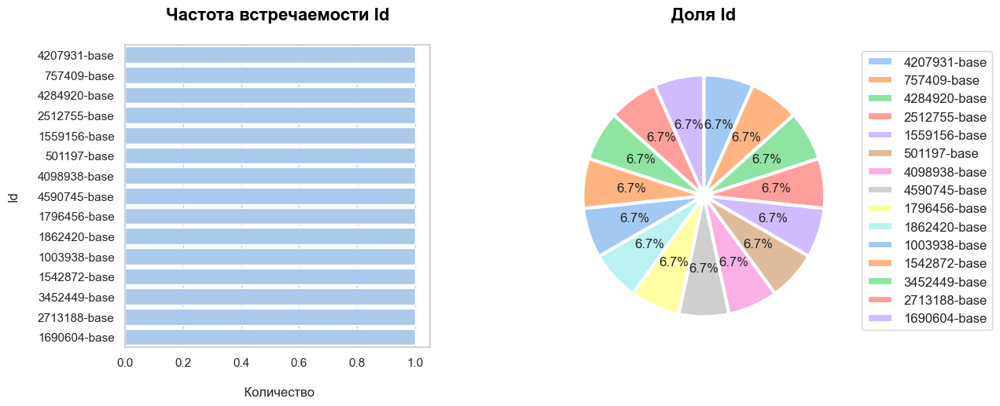

Датафрейм "df_base", колонка "0"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,118.000"
Мода,-85.798
Среднее арифметическое,-86.263
Дисперсия,621.294
Стандартное отклонение,24.926
Ошибка выборочного среднего,0.047
Минимум,-189.356
Квартиль 25%,-103.150


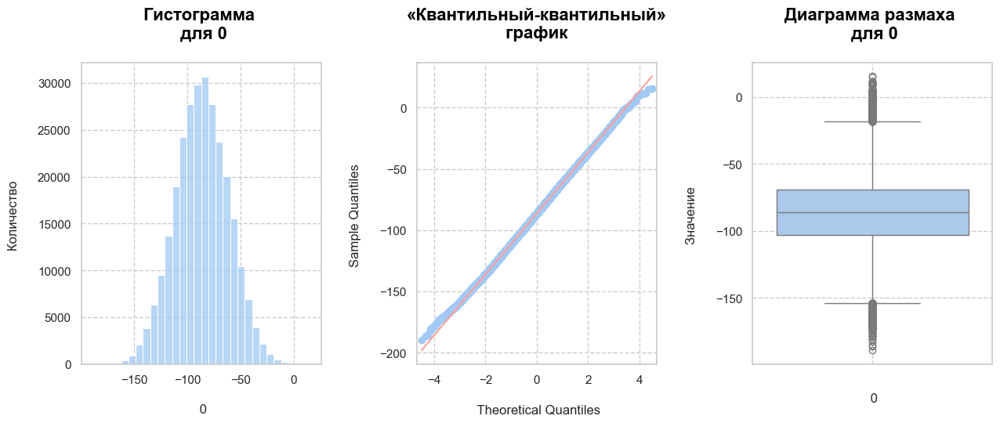

Датафрейм "df_base", колонка "1"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,296.000"
Мода,13.568
Среднее арифметическое,8.076
Дисперсия,24.506
Стандартное отклонение,4.950
Ошибка выборочного среднего,0.009
Минимум,-12.594
Квартиль 25%,4.706


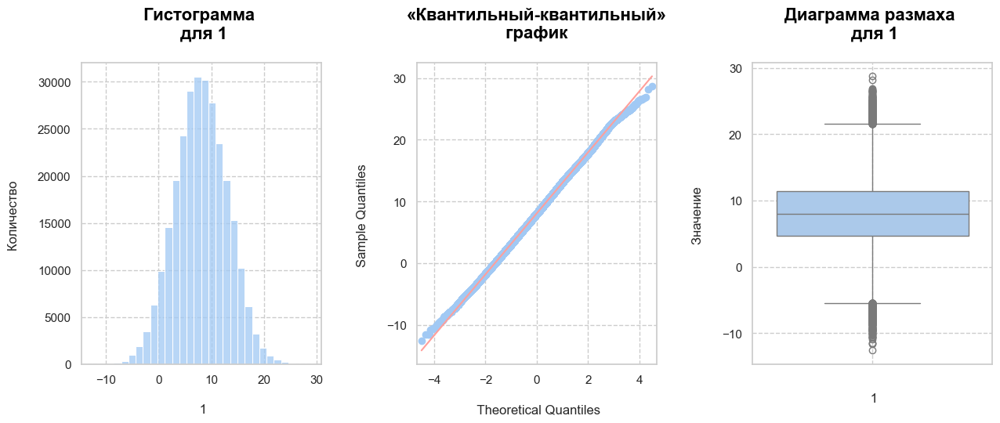

Датафрейм "df_base", колонка "2"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,709.000"
Мода,-53.607
Среднее арифметическое,-44.603
Дисперсия,"1,485.567"
Стандартное отклонение,38.543
Ошибка выборочного среднего,0.073
Минимум,-231.786
Квартиль 25%,-69.525


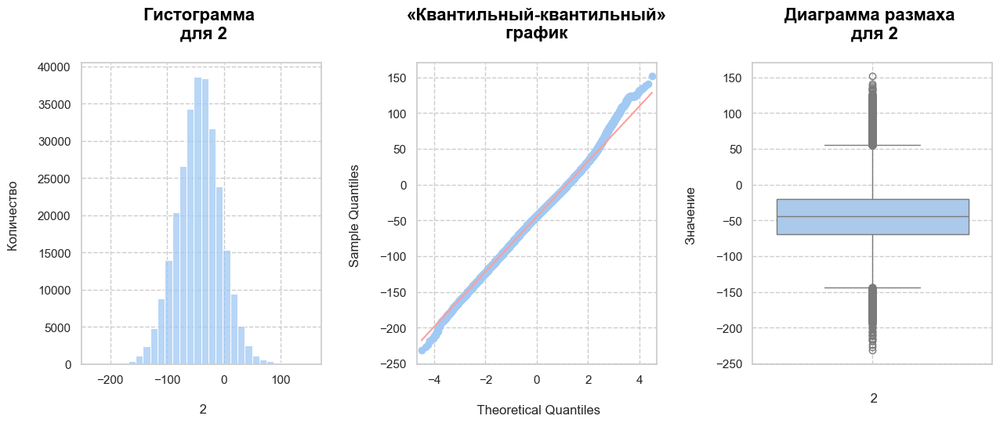

Датафрейм "df_base", колонка "3"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"252,056.000"
Мода,-149.433
Среднее арифметическое,-146.608
Дисперсия,394.074
Стандартное отклонение,19.851
Ошибка выборочного среднего,0.037
Минимум,-224.880
Квартиль 25%,-159.889


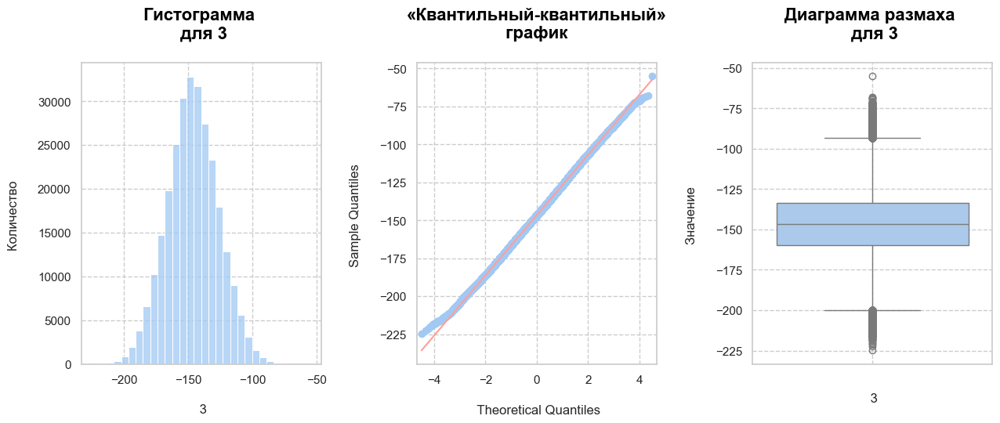

Датафрейм "df_base", колонка "4"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,764.000"
Мода,138.078
Среднее арифметическое,111.259
Дисперсия,"2,149.002"
Стандартное отклонение,46.357
Ошибка выборочного среднего,0.088
Минимум,-95.241
Квартиль 25%,80.357


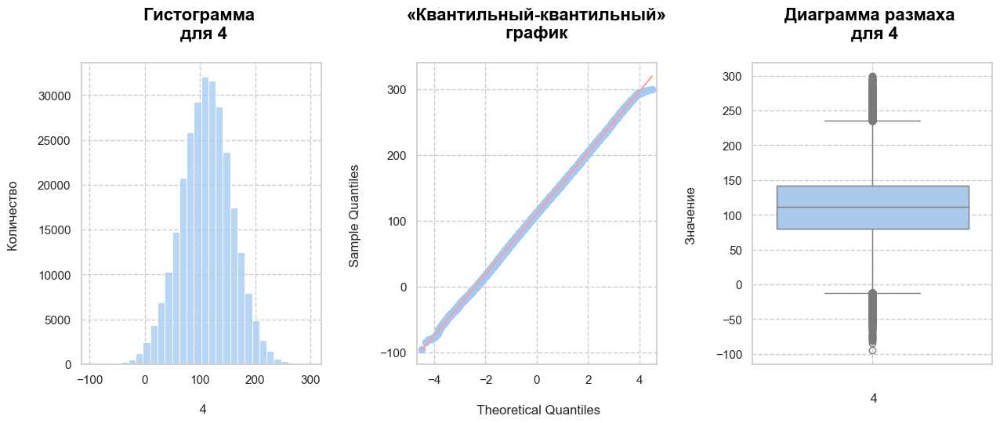

Датафрейм "df_base", колонка "5"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,652.000"
Мода,-72.410
Среднее арифметическое,-71.881
Дисперсия,794.567
Стандартное отклонение,28.188
Ошибка выборочного среднего,0.053
Минимум,-188.473
Квартиль 25%,-91.244


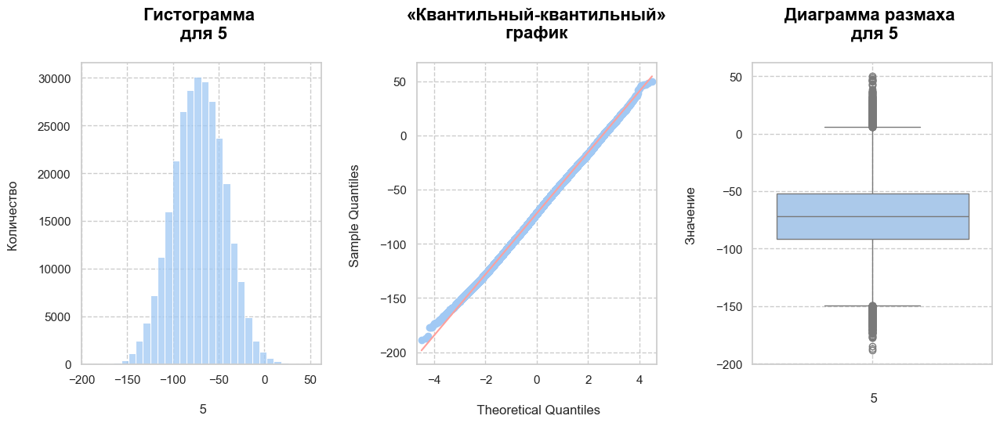

Датафрейм "df_base", колонка "6"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"218,228.000"
Мода,-759.626
Среднее арифметическое,-393.454
Дисперсия,"74,012.898"
Стандартное отклонение,272.053
Ошибка выборочного среднего,0.514
Минимум,-791.469
Квартиль 25%,-631.741


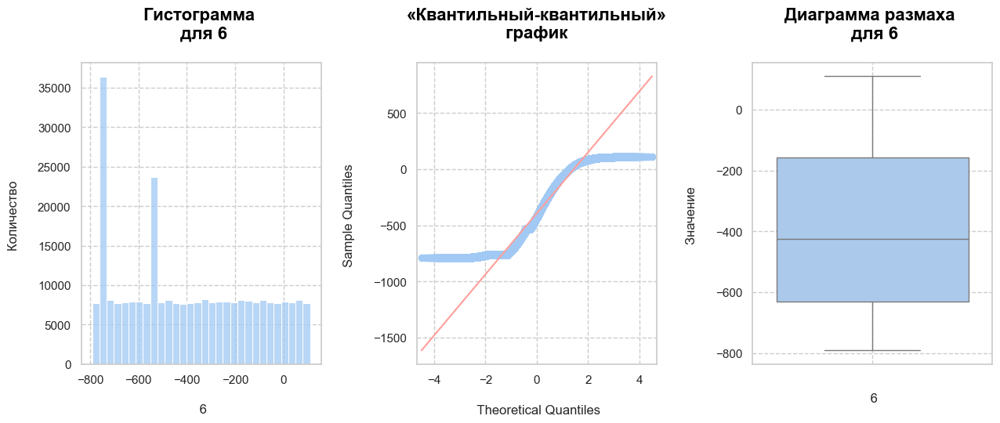

Датафрейм "df_base", колонка "7"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"258,032.000"
Мода,44.749
Среднее арифметическое,20.400
Дисперсия,"4,130.795"
Стандартное отклонение,64.271
Ошибка выборочного среднего,0.121
Минимум,-296.171
Квартиль 25%,-22.075


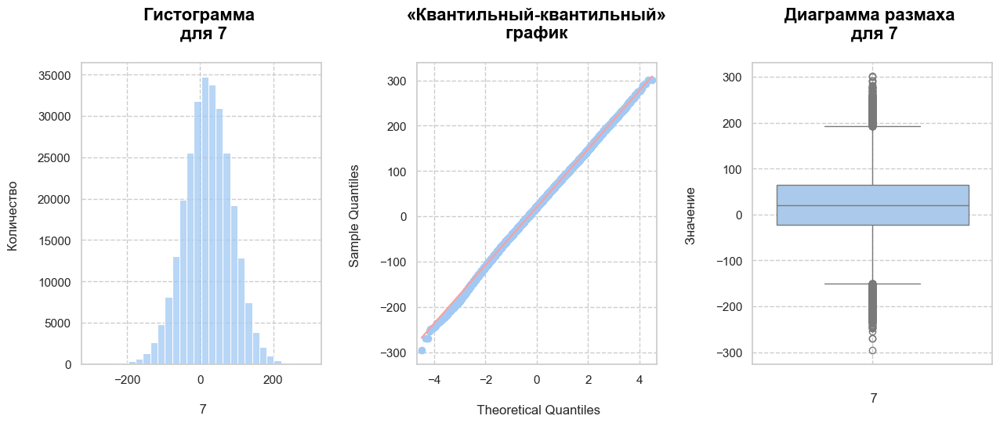

Датафрейм "df_base", колонка "8"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"246,236.000"
Мода,125.561
Среднее арифметическое,123.673
Дисперсия,40.370
Стандартное отклонение,6.354
Ошибка выборочного среднего,0.012
Минимум,93.685
Квартиль 25%,119.468


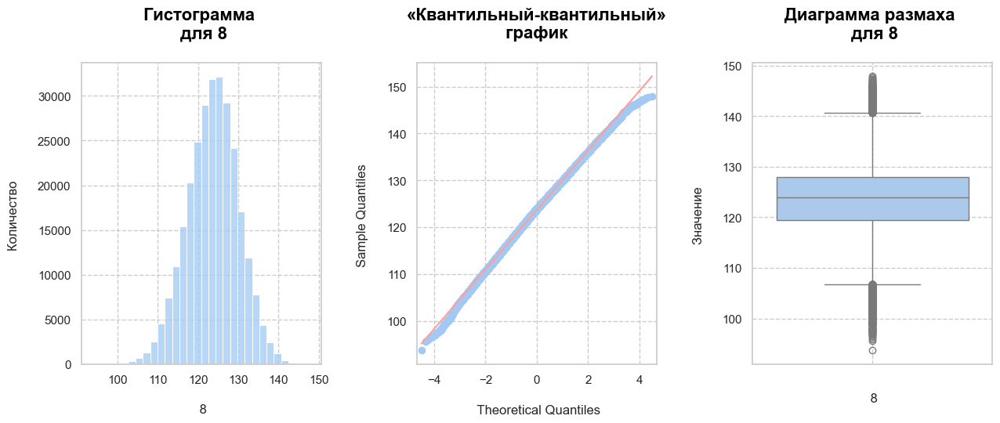

Датафрейм "df_base", колонка "9"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,077.000"
Мода,143.460
Среднее арифметическое,124.408
Дисперсия,"4,143.957"
Стандартное отклонение,64.374
Ошибка выборочного среднего,0.122
Минимум,-143.500
Квартиль 25%,81.645


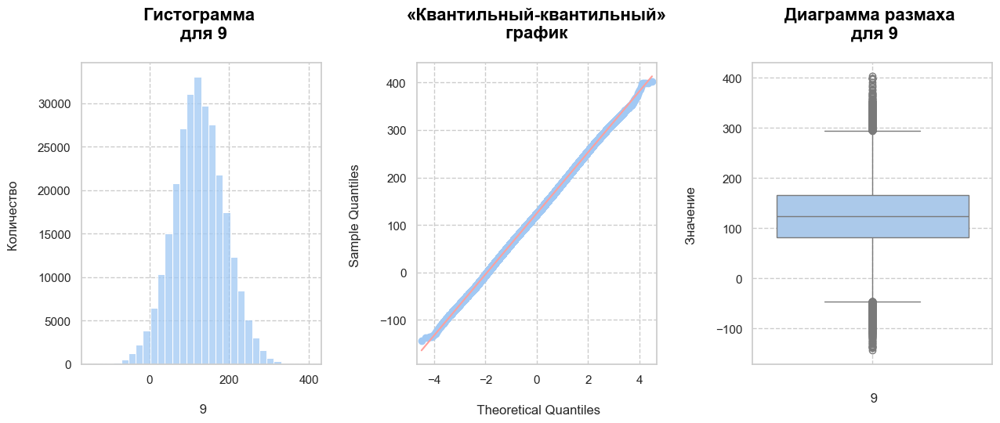

Датафрейм "df_base", колонка "10"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"255,954.000"
Мода,-129.204
Среднее арифметическое,-143.247
Дисперсия,"1,749.619"
Стандартное отклонение,41.828
Ошибка выборочного среднего,0.079
Минимум,-321.523
Квартиль 25%,-170.582


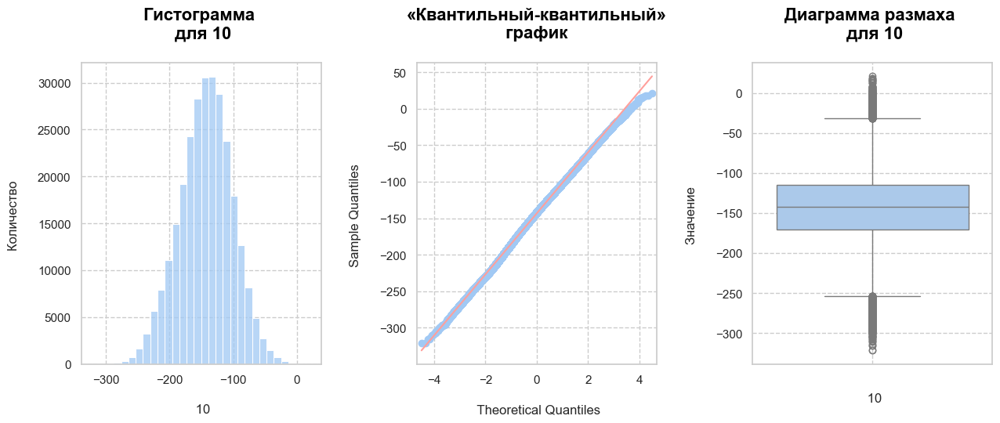

Датафрейм "df_base", колонка "11"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,407.000"
Мода,-40.861
Среднее арифметическое,-69.927
Дисперсия,"2,619.803"
Стандартное отклонение,51.184
Ошибка выборочного среднего,0.097
Минимум,-367.131
Квартиль 25%,-103.977


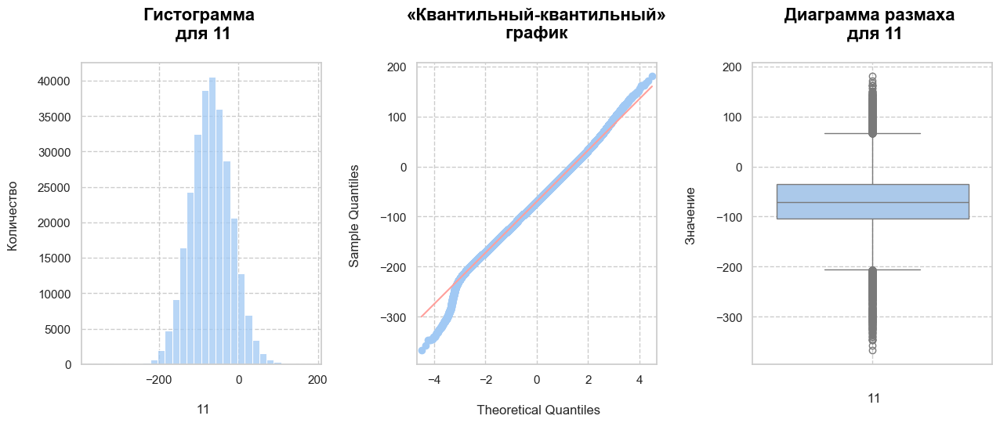

Датафрейм "df_base", колонка "12"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,680.000"
Мода,-12.130
Среднее арифметическое,-41.181
Дисперсия,"1,518.488"
Стандартное отклонение,38.968
Ошибка выборочного среднего,0.074
Минимум,-215.224
Квартиль 25%,-66.600


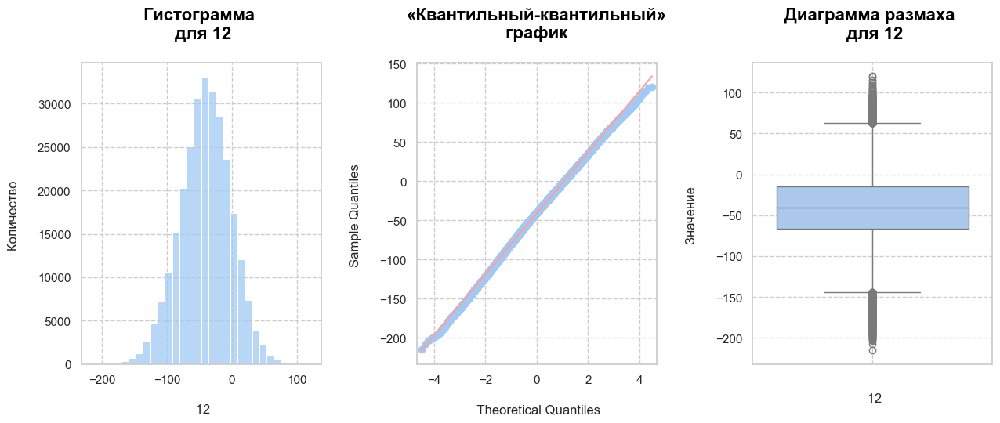

Датафрейм "df_base", колонка "13"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,968.000"
Мода,-37.533
Среднее арифметическое,7.631
Дисперсия,"1,337.615"
Стандартное отклонение,36.573
Ошибка выборочного среднего,0.069
Минимум,-175.624
Квартиль 25%,-16.864


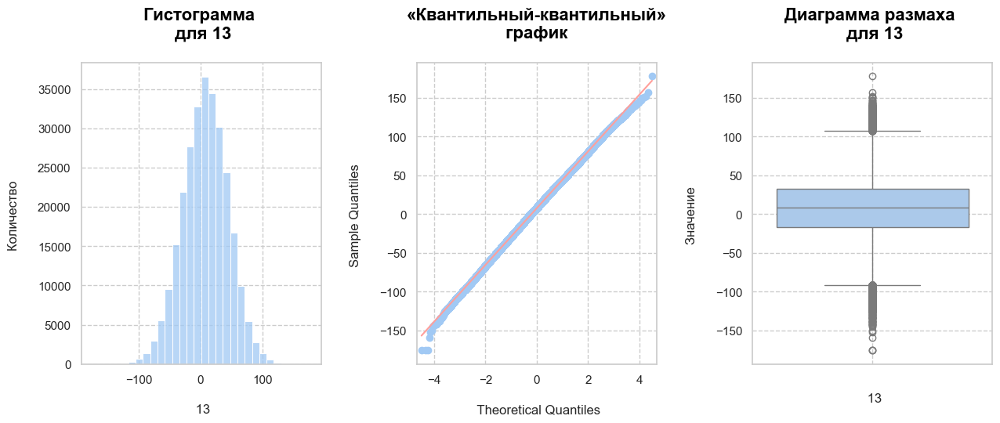

Датафрейм "df_base", колонка "14"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"255,065.000"
Мода,120.426
Среднее арифметическое,148.937
Дисперсия,"1,131.317"
Стандартное отклонение,33.635
Ошибка выборочного среднего,0.064
Минимум,-9.158
Квартиль 25%,126.034


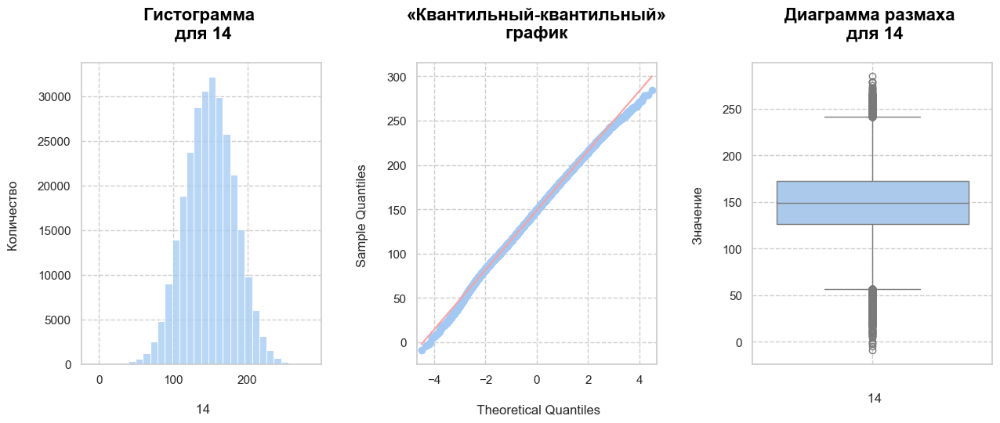

Датафрейм "df_base", колонка "15"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,172.000"
Мода,-0.401
Среднее арифметическое,-23.199
Дисперсия,170.946
Стандартное отклонение,13.075
Ошибка выборочного среднего,0.025
Минимум,-84.724
Квартиль 25%,-31.798


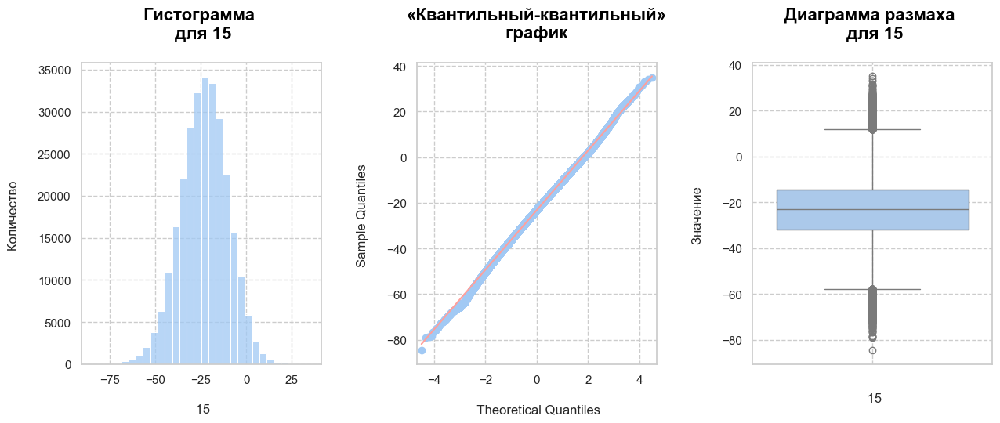

Датафрейм "df_base", колонка "16"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,988.000"
Мода,23.796
Среднее арифметическое,-0.946
Дисперсия,433.677
Стандартное отклонение,20.825
Ошибка выборочного среднего,0.039
Минимум,-96.368
Квартиль 25%,-15.132


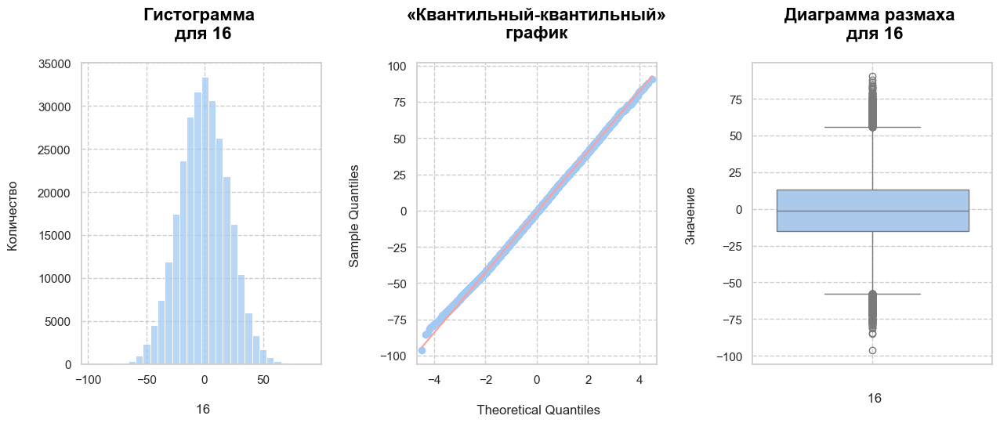

Датафрейм "df_base", колонка "17"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,788.000"
Мода,-71.802
Среднее арифметическое,-19.240
Дисперсия,"2,805.833"
Стандартное отклонение,52.970
Ошибка выборочного среднего,0.100
Минимум,-237.019
Квартиль 25%,-55.494


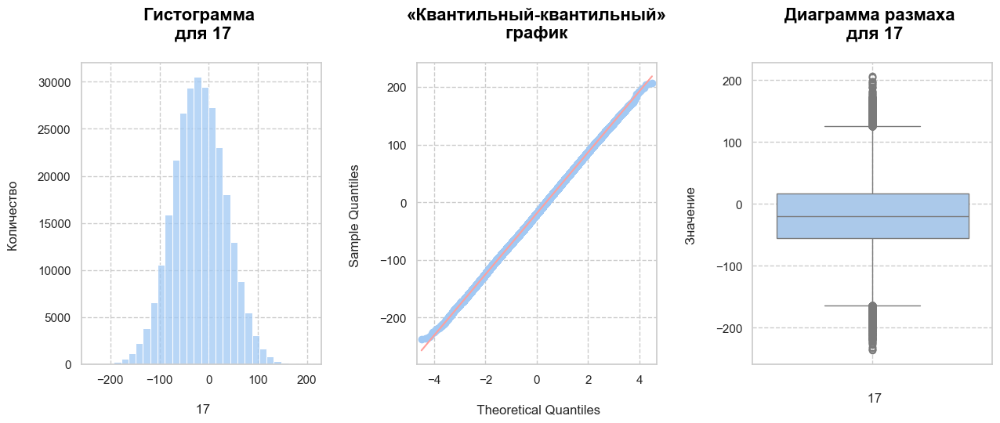

Датафрейм "df_base", колонка "18"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,180.000"
Мода,-169.091
Среднее арифметическое,-137.369
Дисперсия,"2,177.767"
Стандартное отклонение,46.667
Ошибка выборочного среднего,0.088
Минимум,-348.336
Квартиль 25%,-167.707


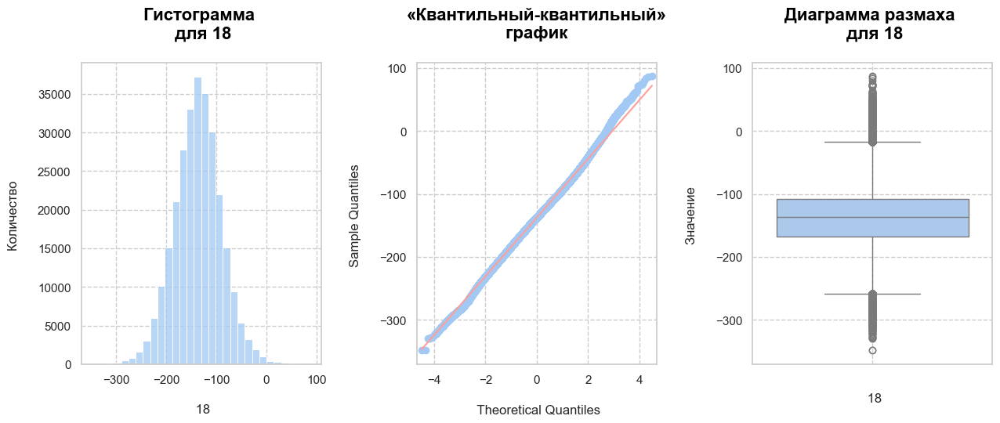

Датафрейм "df_base", колонка "19"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"186,446.000"
Мода,-78.888
Среднее арифметическое,-79.190
Дисперсия,0.574
Стандартное отклонение,0.758
Ошибка выборочного среднего,0.001
Минимум,-82.660
Квартиль 25%,-79.680


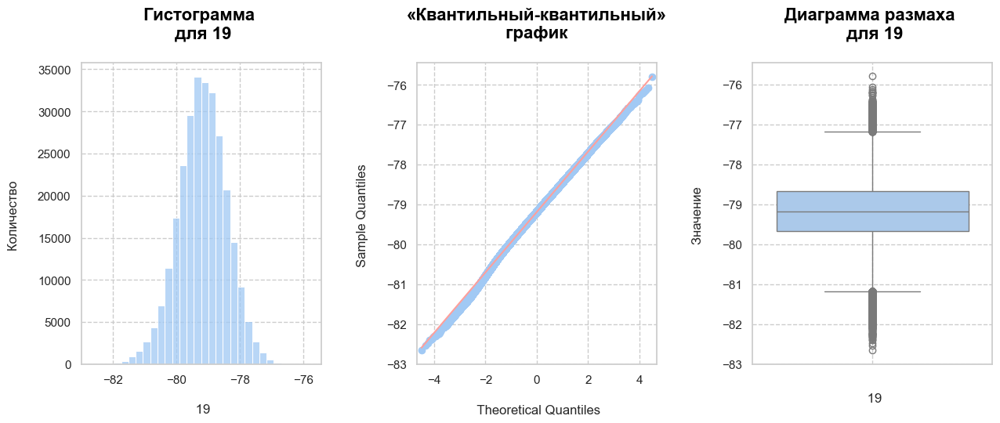

Датафрейм "df_base", колонка "20"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,170.000"
Мода,-69.883
Среднее арифметическое,-98.265
Дисперсия,792.277
Стандартное отклонение,28.147
Ошибка выборочного среднего,0.053
Минимум,-230.840
Квартиль 25%,-116.893


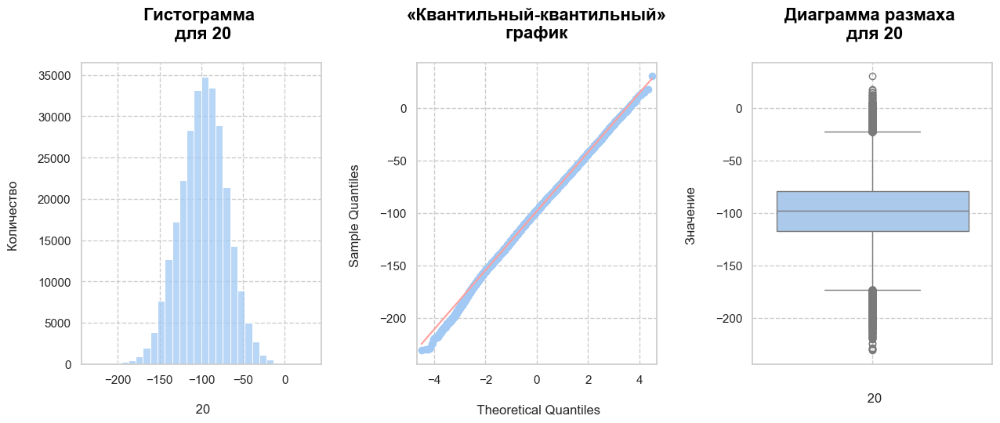

Датафрейм "df_base", колонка "21"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"77,106.000"
Мода,"1,507.231"
Среднее арифметическое,"1,257.294"
Дисперсия,"159,773.109"
Стандартное отклонение,399.716
Ошибка выборочного среднего,0.755
Минимум,136.856
Квартиль 25%,"1,086.612"


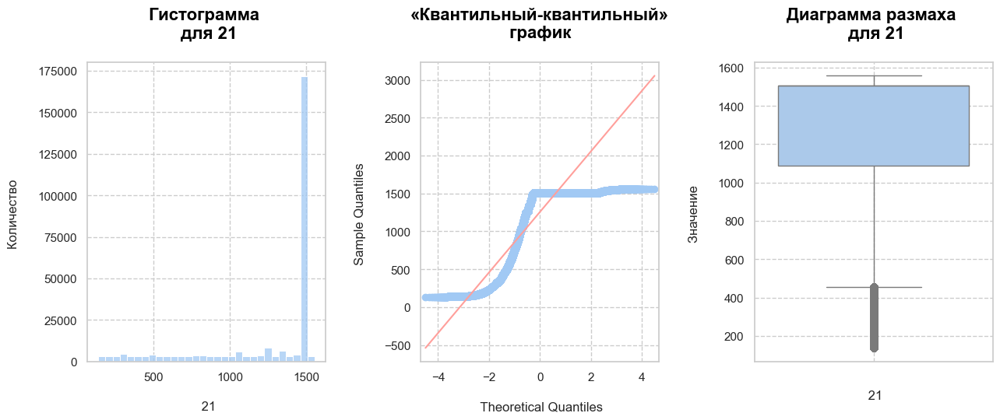

Датафрейм "df_base", колонка "22"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,956.000"
Мода,33.322
Среднее арифметическое,-6.797
Дисперсия,"2,702.841"
Стандартное отклонение,51.989
Ошибка выборочного среднего,0.098
Минимум,-219.016
Квартиль 25%,-42.251


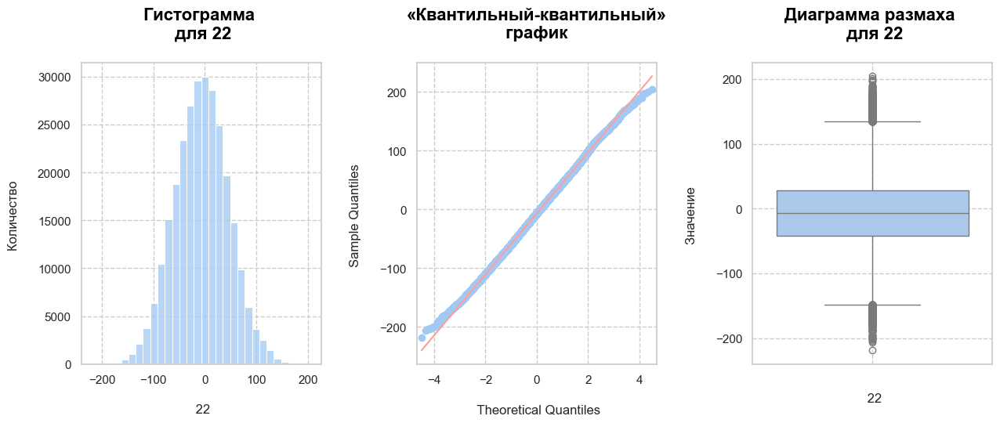

Датафрейм "df_base", колонка "23"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,137.000"
Мода,80.073
Среднее арифметическое,56.727
Дисперсия,"1,182.215"
Стандартное отклонение,34.383
Ошибка выборочного среднего,0.065
Минимум,-83.705
Квартиль 25%,33.343


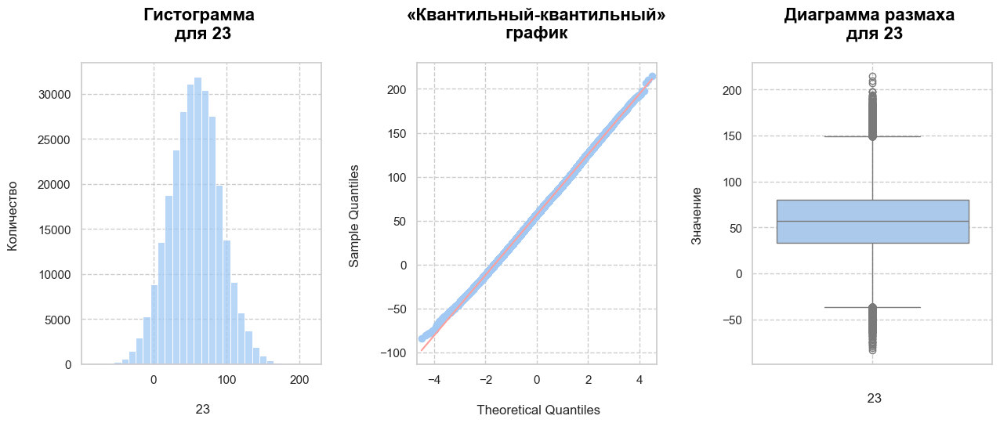

Датафрейм "df_base", колонка "24"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,823.000"
Мода,76.384
Среднее арифметическое,26.625
Дисперсия,"1,518.457"
Стандартное отклонение,38.967
Ошибка выборочного среднего,0.074
Минимум,-143.183
Квартиль 25%,0.401


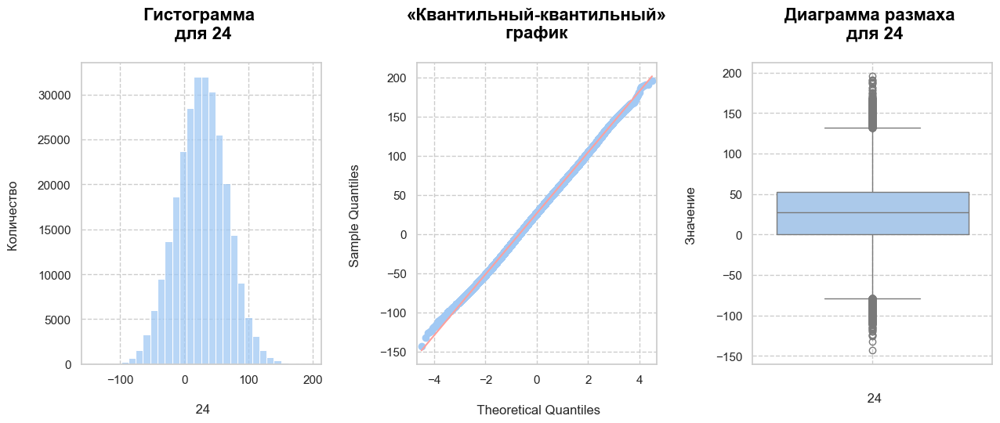

Датафрейм "df_base", колонка "25"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"39,735.000"
Мода,813.770
Среднее арифметическое,726.688
Дисперсия,"42,273.133"
Стандартное отклонение,205.604
Ошибка выборочного среднего,0.388
Минимум,-61.967
Квартиль 25%,813.770


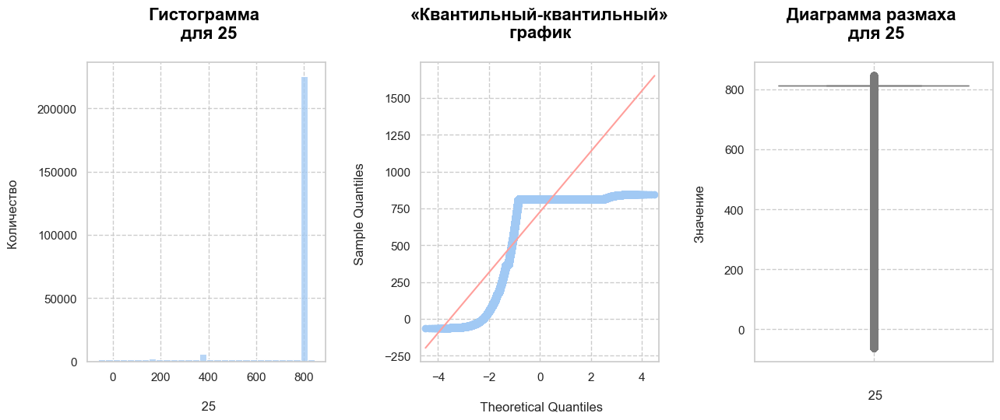

Датафрейм "df_base", колонка "26"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,709.000"
Мода,-86.443
Среднее арифметическое,-66.034
Дисперсия,"3,788.742"
Стандартное отклонение,61.553
Ошибка выборочного среднего,0.116
Минимум,-327.226
Квартиль 25%,-107.558


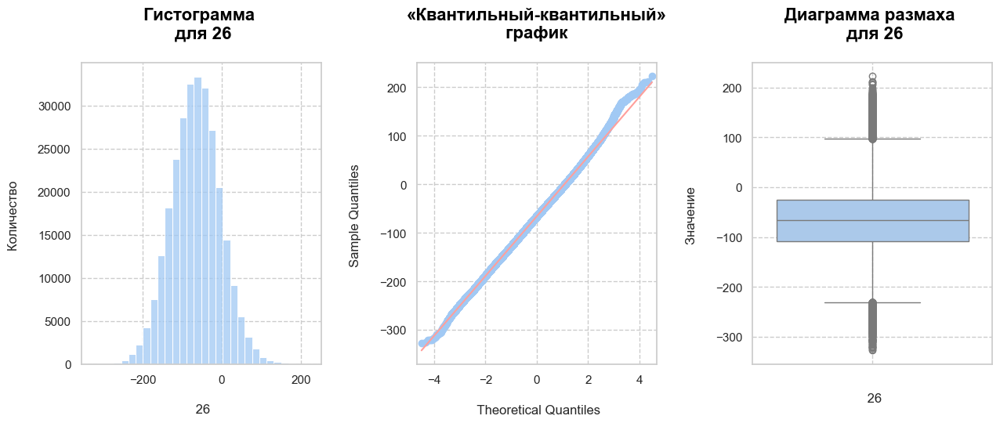

Датафрейм "df_base", колонка "27"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"255,928.000"
Мода,22.030
Среднее арифметическое,16.300
Дисперсия,21.686
Стандартное отклонение,4.657
Ошибка выборочного среднего,0.009
Минимум,-7.297
Квартиль 25%,13.256


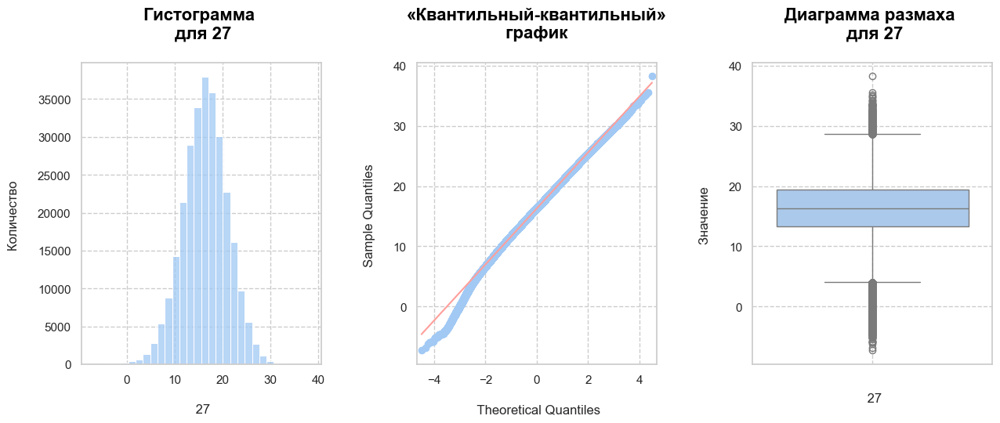

Датафрейм "df_base", колонка "28"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,273.000"
Мода,-73.180
Среднее арифметическое,-86.264
Дисперсия,"2,334.958"
Стандартное отклонение,48.321
Ошибка выборочного среднего,0.091
Минимум,-302.772
Квартиль 25%,-118.428


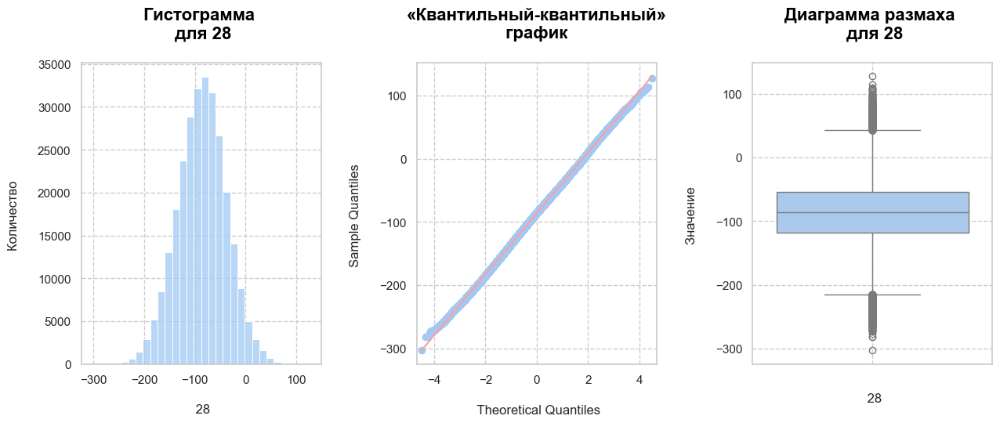

Датафрейм "df_base", колонка "29"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"245,382.000"
Мода,146.859
Среднее арифметическое,151.736
Дисперсия,101.844
Стандартное отклонение,10.092
Ошибка выборочного среднего,0.019
Минимум,107.650
Квартиль 25%,144.899


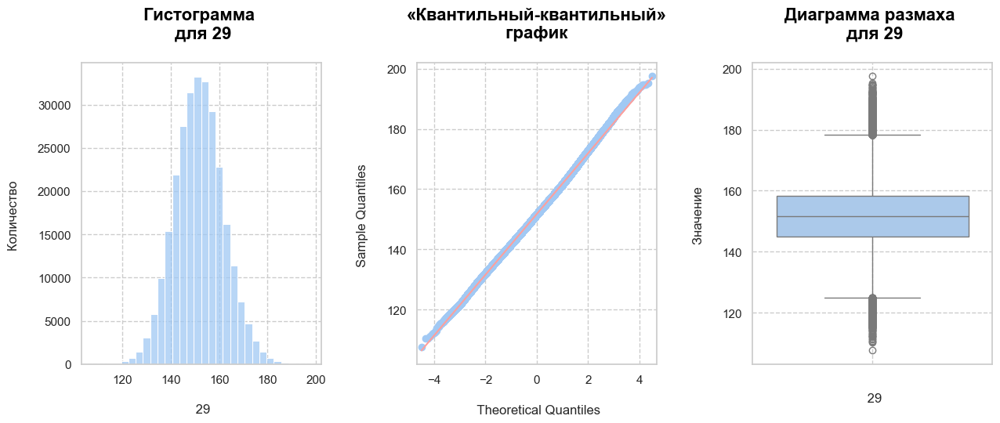

Датафрейм "df_base", колонка "30"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"258,031.000"
Мода,4.214
Среднее арифметическое,-11.590
Дисперсия,837.936
Стандартное отклонение,28.947
Ошибка выборочного среднего,0.055
Минимум,-146.495
Квартиль 25%,-30.716


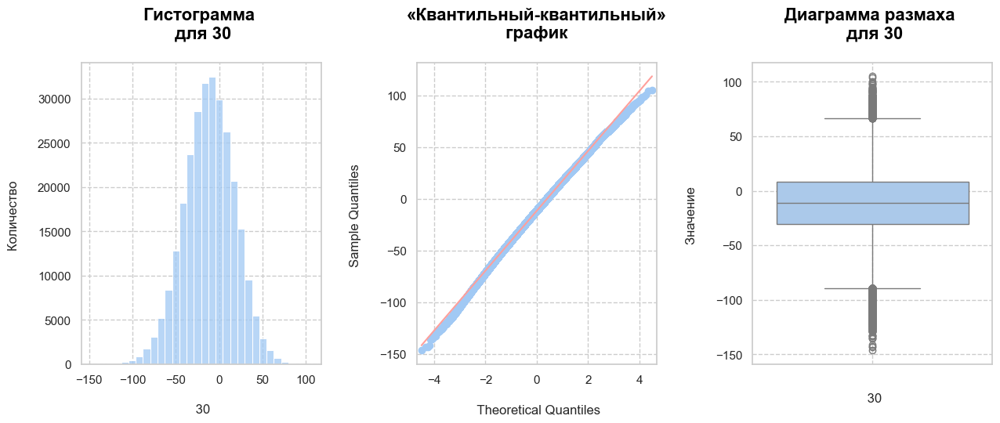

Датафрейм "df_base", колонка "31"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"255,111.000"
Мода,-163.975
Среднее арифметическое,-144.251
Дисперсия,"1,217.880"
Стандартное отклонение,34.898
Ошибка выборочного среднего,0.066
Минимум,-288.614
Квартиль 25%,-167.130


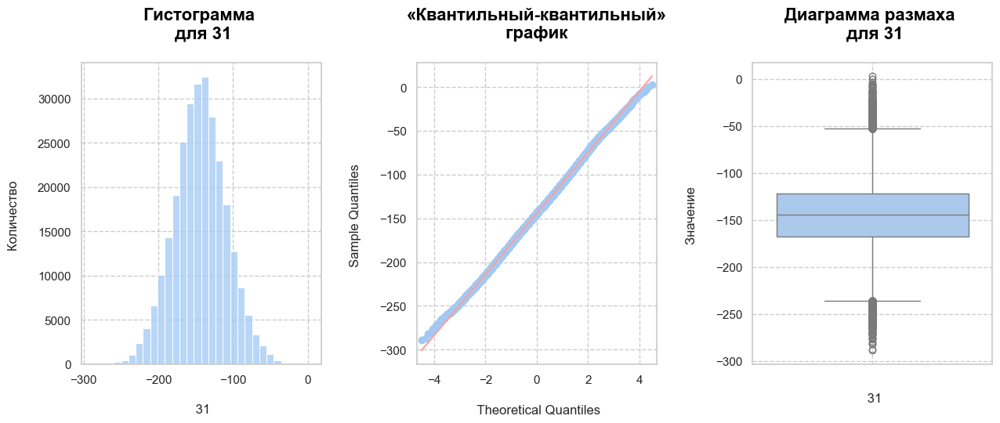

Датафрейм "df_base", колонка "32"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,230.000"
Мода,66.993
Среднее арифметическое,87.287
Дисперсия,772.116
Стандартное отклонение,27.787
Ошибка выборочного среднего,0.052
Минимум,-25.103
Квартиль 25%,68.453


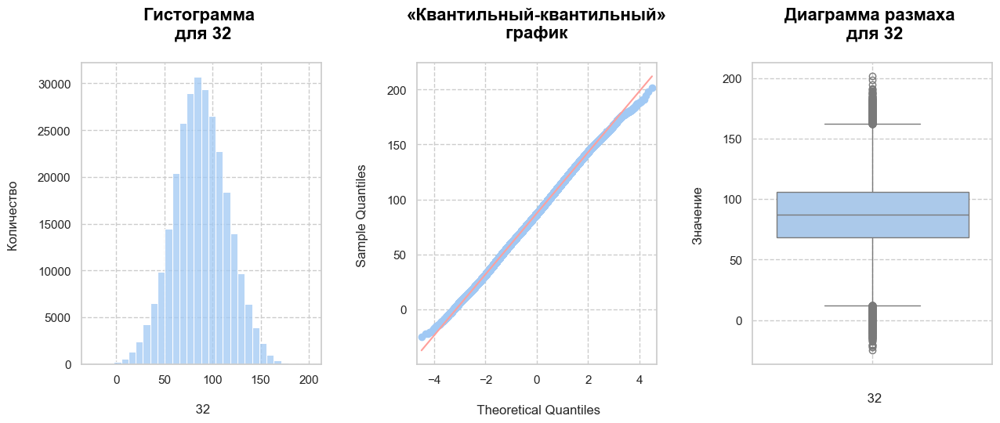

Датафрейм "df_base", колонка "33"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"2,741.000"
Мода,-529.295
Среднее арифметическое,-555.152
Дисперсия,"67,982.070"
Стандартное отклонение,260.734
Ошибка выборочного среднего,0.492
Минимум,"-1,045.312"
Квартиль 25%,-771.297


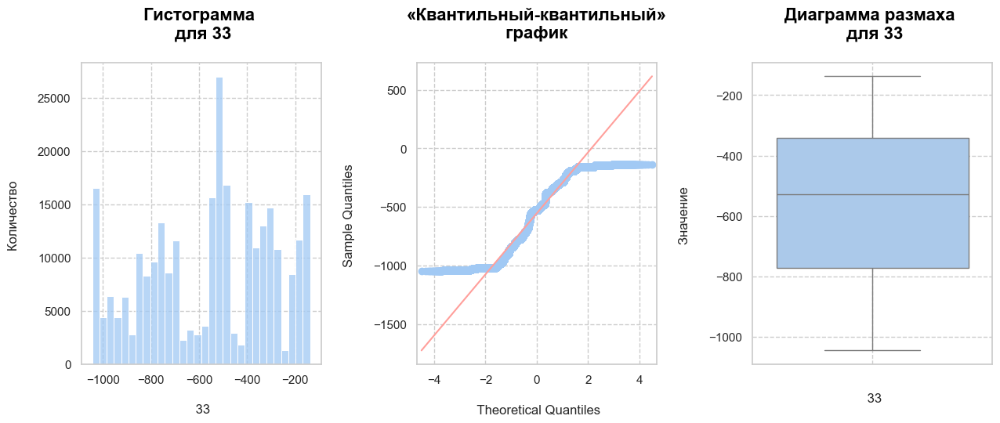

Датафрейм "df_base", колонка "34"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,740.000"
Мода,65.912
Среднее арифметическое,36.344
Дисперсия,"1,590.421"
Стандартное отклонение,39.880
Ошибка выборочного среднего,0.075
Минимум,-126.766
Квартиль 25%,9.458


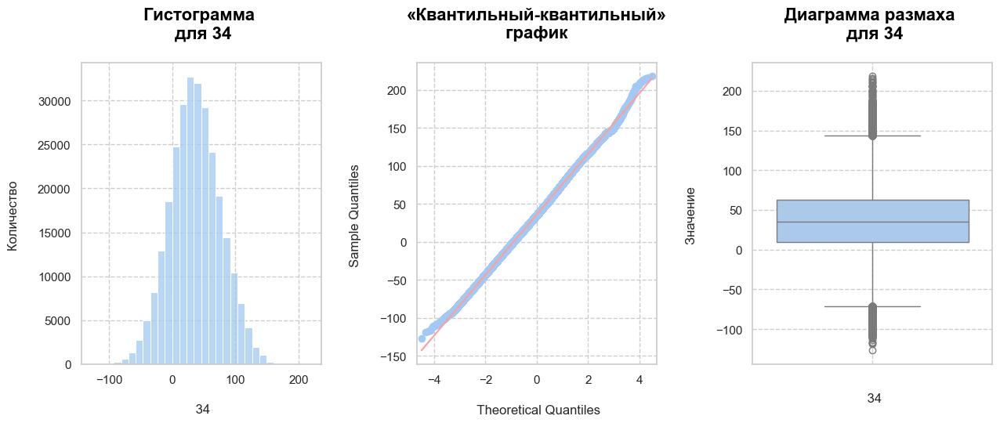

Датафрейм "df_base", колонка "35"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"255,927.000"
Мода,64.163
Среднее арифметическое,75.168
Дисперсия,460.343
Стандартное отклонение,21.456
Ошибка выборочного среднего,0.041
Минимум,-8.801
Квартиль 25%,60.944


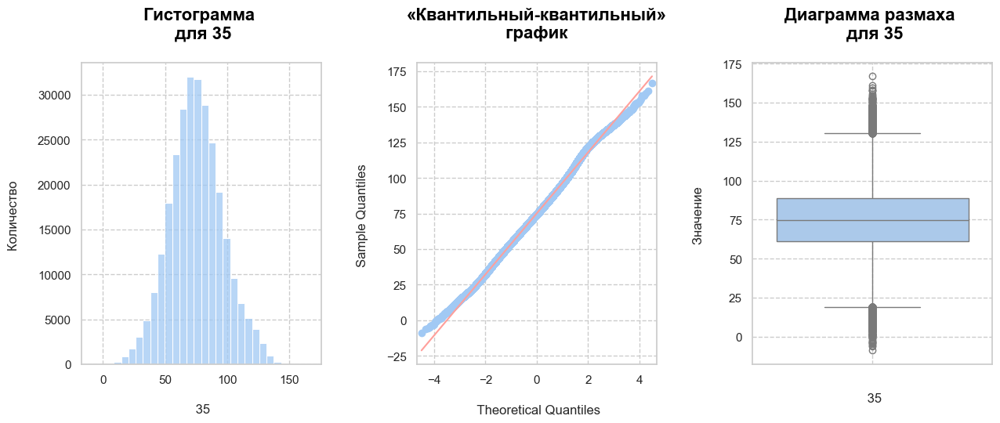

Датафрейм "df_base", колонка "36"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"258,028.000"
Мода,-22.224
Среднее арифметическое,-16.460
Дисперсия,667.070
Стандартное отклонение,25.828
Ошибка выборочного среднего,0.049
Минимум,-125.227
Квартиль 25%,-34.123


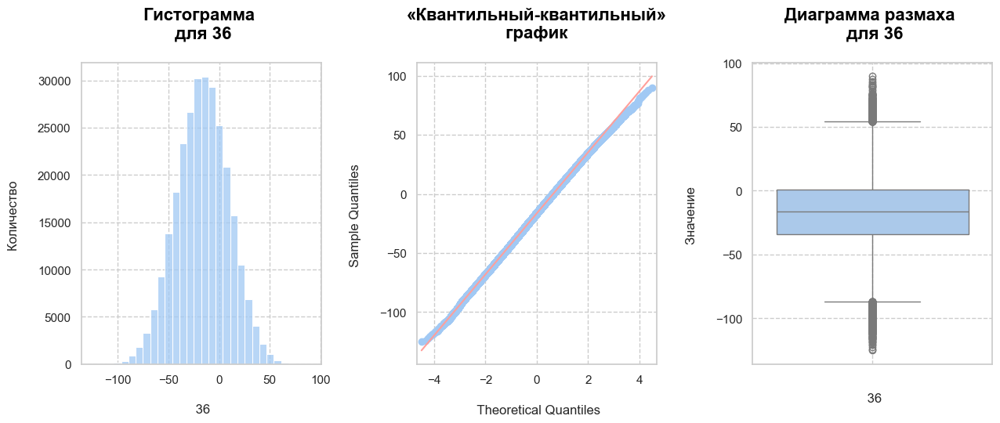

Датафрейм "df_base", колонка "37"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"245,139.000"
Мода,-150.042
Среднее арифметическое,-146.675
Дисперсия,99.126
Стандартное отклонение,9.956
Ошибка выборочного среднего,0.019
Минимум,-190.386
Квартиль 25%,-153.294


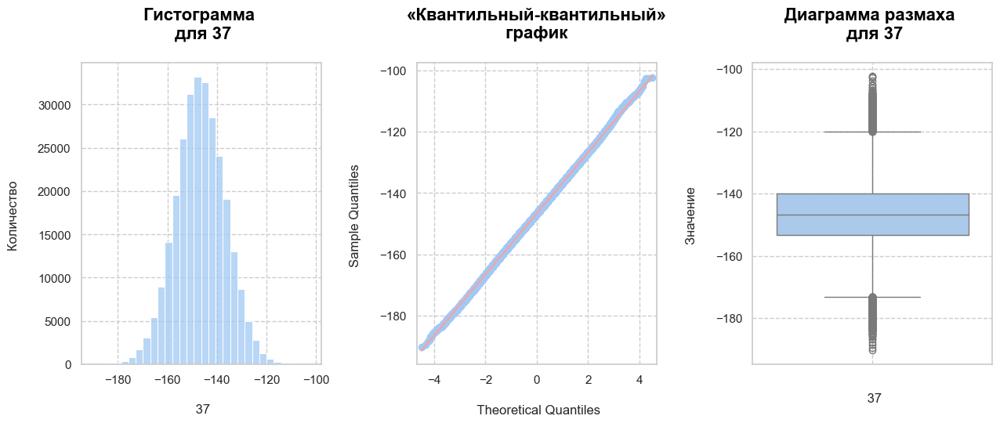

Датафрейм "df_base", колонка "38"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"252,621.000"
Мода,-114.467
Среднее арифметическое,-118.533
Дисперсия,172.232
Стандартное отклонение,13.124
Ошибка выборочного среднего,0.025
Минимум,-168.637
Квартиль 25%,-127.451


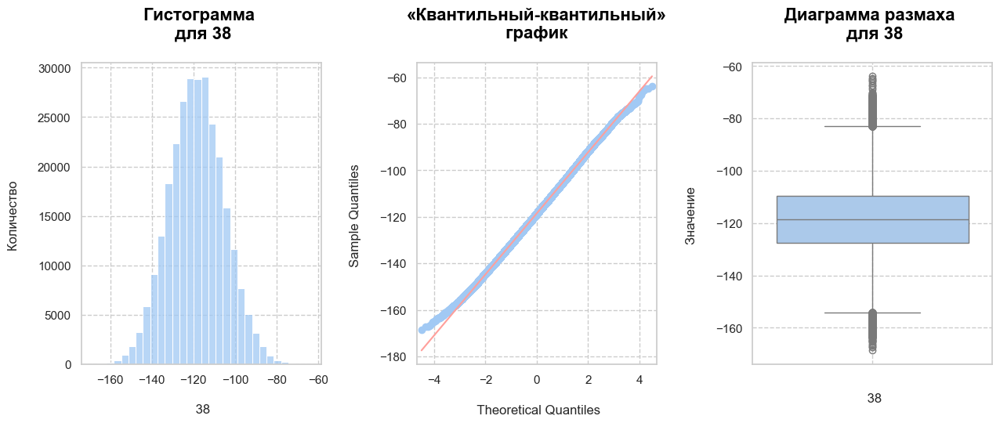

Датафрейм "df_base", колонка "39"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,974.000"
Мода,-62.501
Среднее арифметическое,-41.901
Дисперсия,368.898
Стандартное отклонение,19.207
Ошибка выборочного среднего,0.036
Минимум,-130.044
Квартиль 25%,-54.861


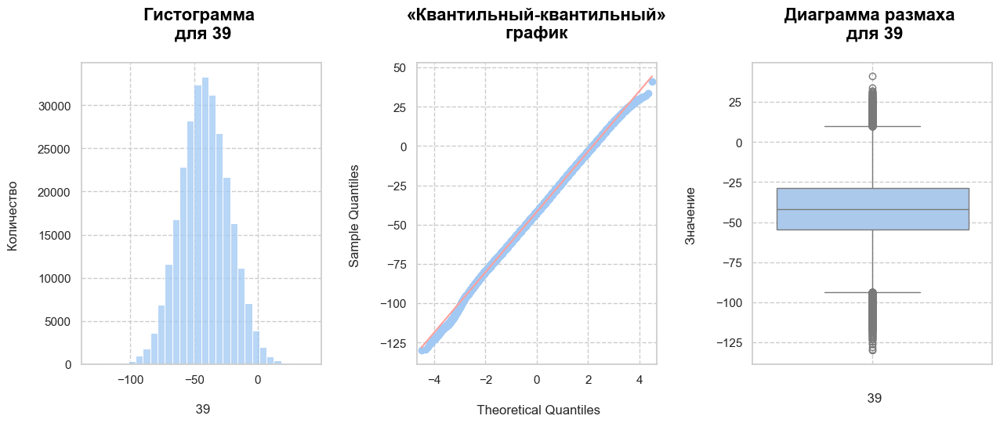

Датафрейм "df_base", колонка "40"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,616.000"
Мода,-10.340
Среднее арифметическое,-9.504
Дисперсия,67.047
Стандартное отклонение,8.188
Ошибка выборочного среднего,0.015
Минимум,-44.640
Квартиль 25%,-14.999


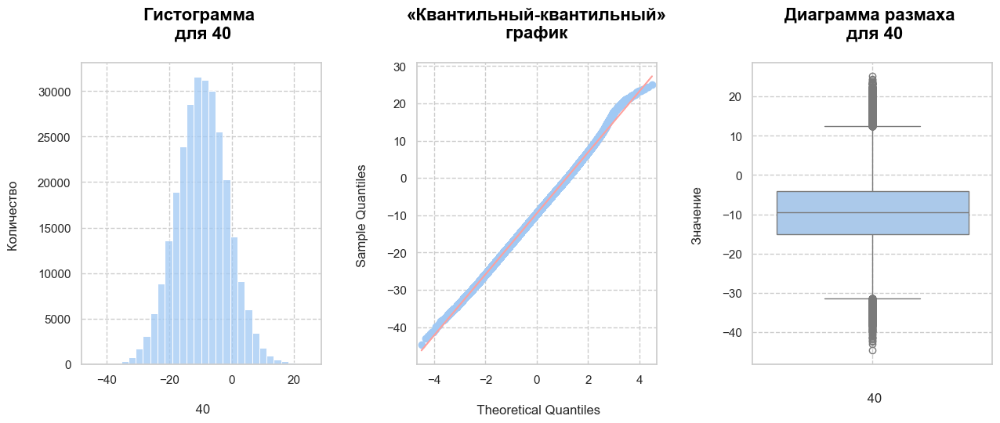

Датафрейм "df_base", колонка "41"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,825.000"
Мода,-2.363
Среднее арифметическое,4.063
Дисперсия,33.991
Стандартное отклонение,5.830
Ошибка выборочного среднего,0.011
Минимум,-19.546
Квартиль 25%,0.057


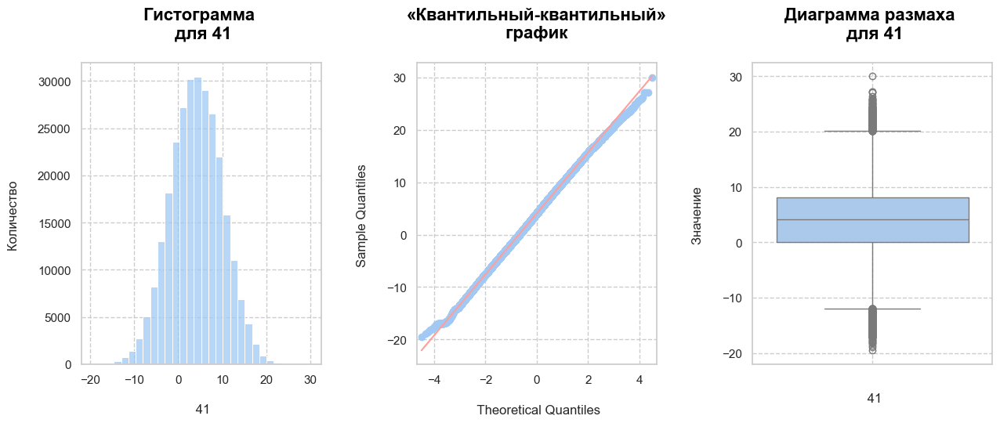

Датафрейм "df_base", колонка "42"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,093.000"
Мода,-142.977
Среднее арифметическое,-112.652
Дисперсия,"3,242.504"
Стандартное отклонение,56.943
Ошибка выборочного среднего,0.108
Минимум,-335.376
Квартиль 25%,-151.577


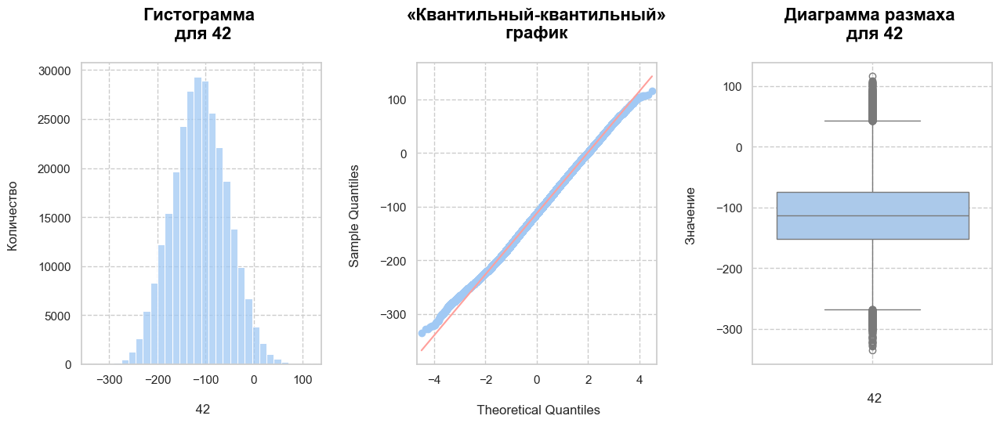

Датафрейм "df_base", колонка "43"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,533.000"
Мода,94.105
Среднее арифметическое,120.821
Дисперсия,"2,187.167"
Стандартное отклонение,46.767
Ошибка выборочного среднего,0.088
Минимум,-78.077
Квартиль 25%,88.159


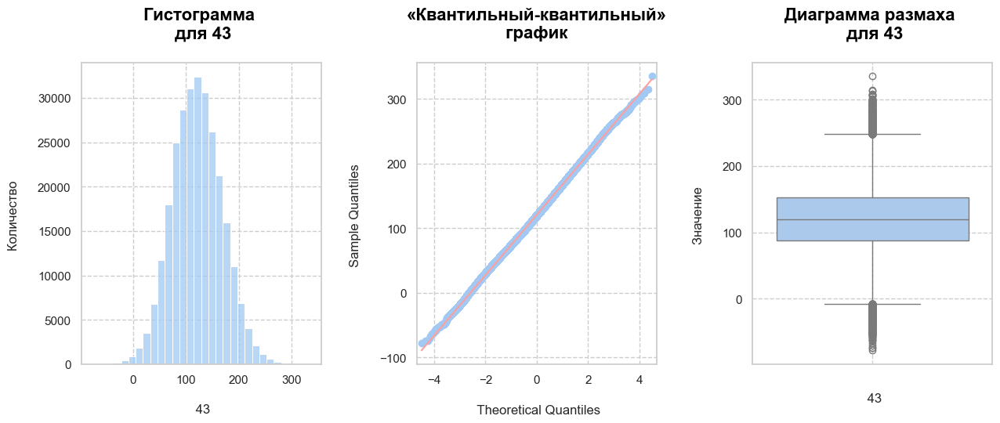

Датафрейм "df_base", колонка "44"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"20,885.000"
Мода,-61.441
Среднее арифметическое,-39.785
Дисперсия,217.093
Стандартное отклонение,14.734
Ошибка выборочного среднего,0.028
Минимум,-63.102
Квартиль 25%,-52.849


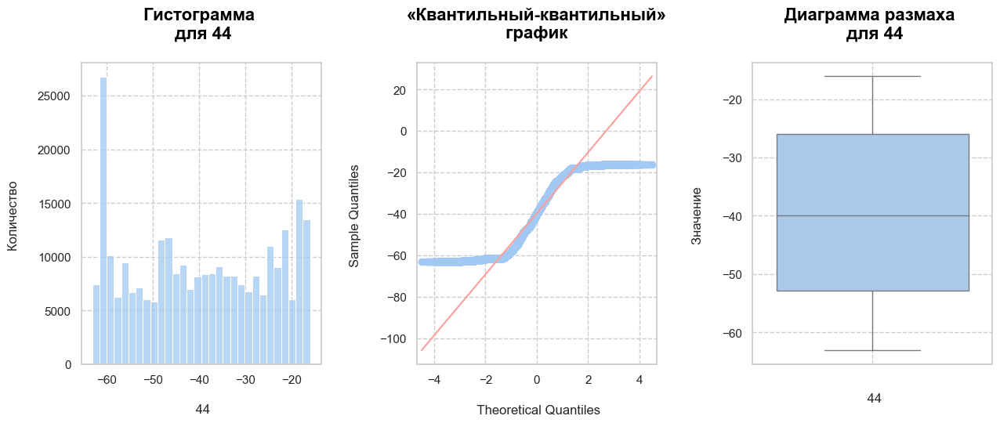

Датафрейм "df_base", колонка "45"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,265.000"
Мода,99.058
Среднее арифметическое,58.974
Дисперсия,"1,025.890"
Стандартное отклонение,32.030
Ошибка выборочного среднего,0.060
Минимум,-71.692
Квартиль 25%,37.111


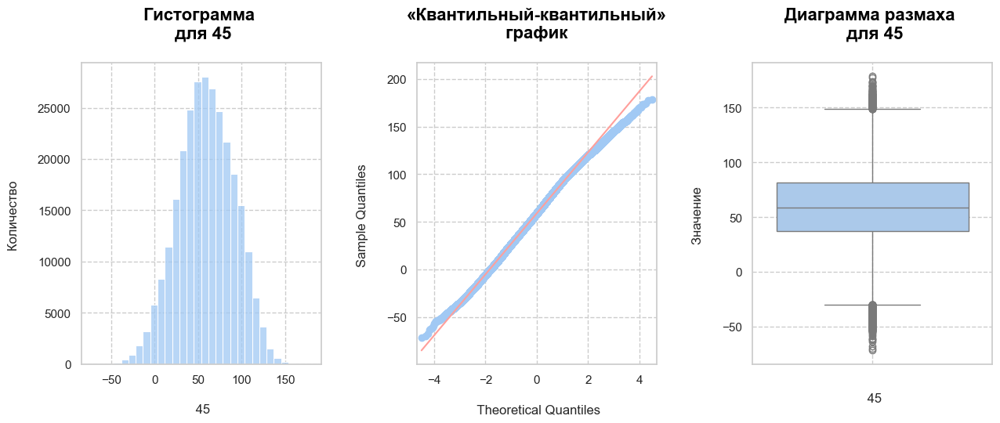

Датафрейм "df_base", колонка "46"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,565.000"
Мода,-27.232
Среднее арифметическое,-85.070
Дисперсия,"3,999.885"
Стандартное отклонение,63.245
Ошибка выборочного среднего,0.119
Минимум,-334.214
Квартиль 25%,-128.579


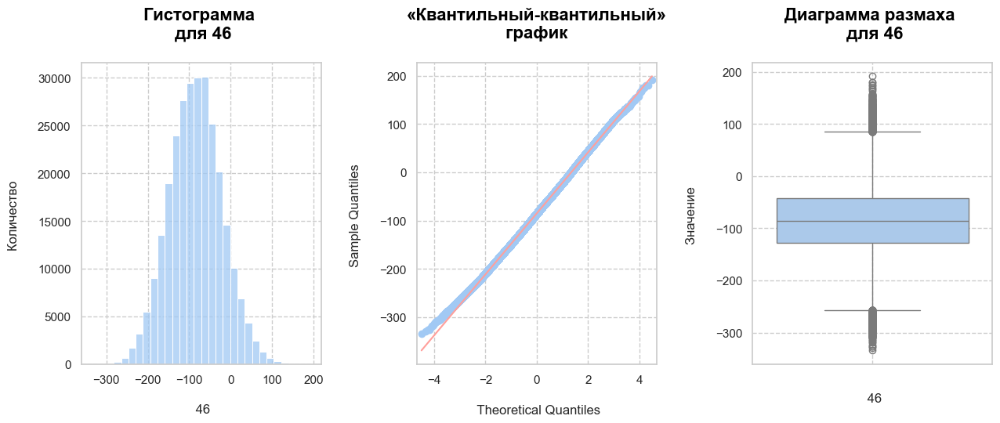

Датафрейм "df_base", колонка "47"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,604.000"
Мода,-43.340
Среднее арифметическое,-138.570
Дисперсия,"3,332.750"
Стандартное отклонение,57.730
Ошибка выборочного среднего,0.109
Минимум,-389.027
Квартиль 25%,-176.670


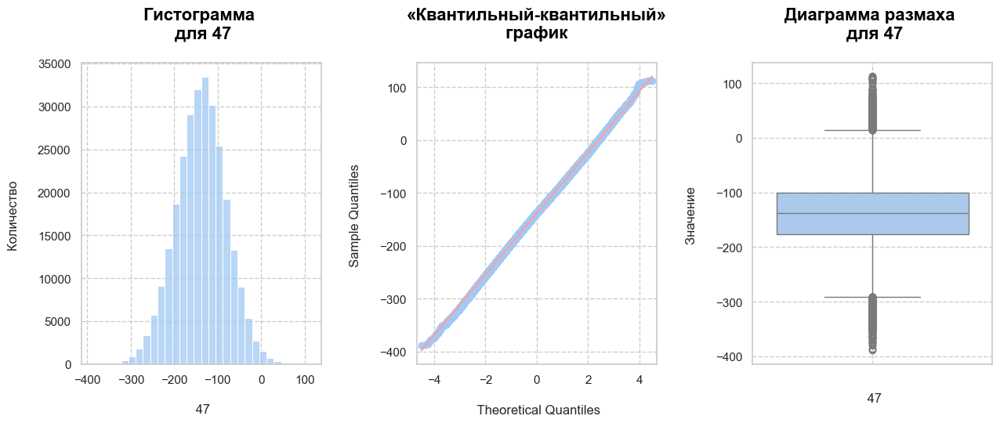

Датафрейм "df_base", колонка "48"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,713.000"
Мода,29.997
Среднее арифметическое,47.977
Дисперсия,"2,042.521"
Стандартное отклонение,45.194
Ошибка выборочного среднего,0.085
Минимум,-133.092
Квартиль 25%,17.906


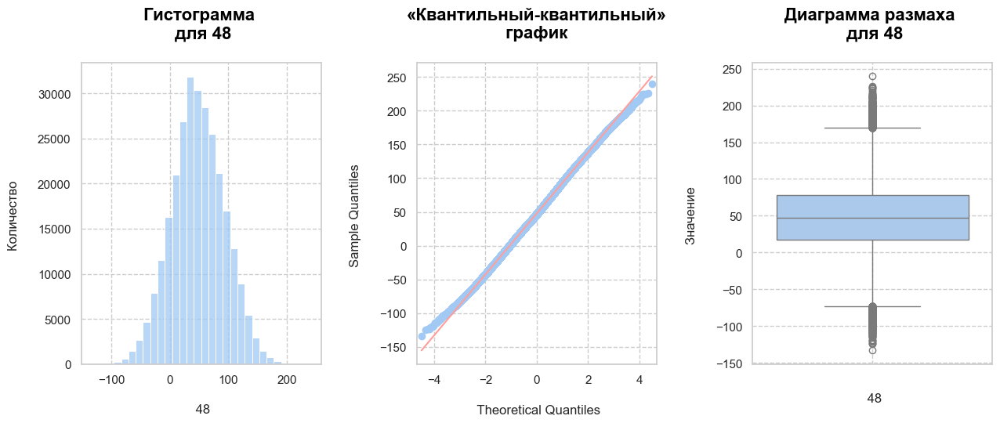

Датафрейм "df_base", колонка "49"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,916.000"
Мода,-9.606
Среднее арифметическое,-32.589
Дисперсия,"3,396.615"
Стандартное отклонение,58.280
Ошибка выборочного среднего,0.110
Минимум,-322.812
Квартиль 25%,-70.024


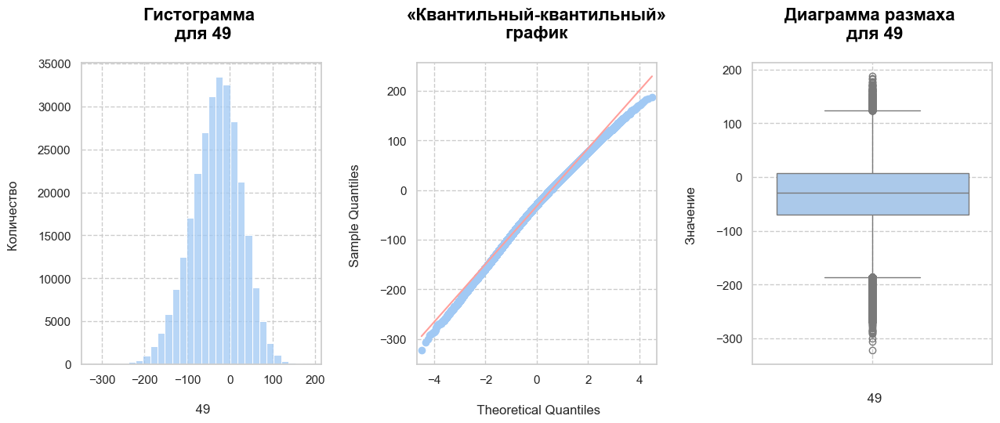

Датафрейм "df_base", колонка "50"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,993.000"
Мода,2.463
Среднее арифметическое,26.600
Дисперсия,"3,489.023"
Стандартное отклонение,59.068
Ошибка выборочного среднего,0.112
Минимум,-245.635
Квартиль 25%,-12.402


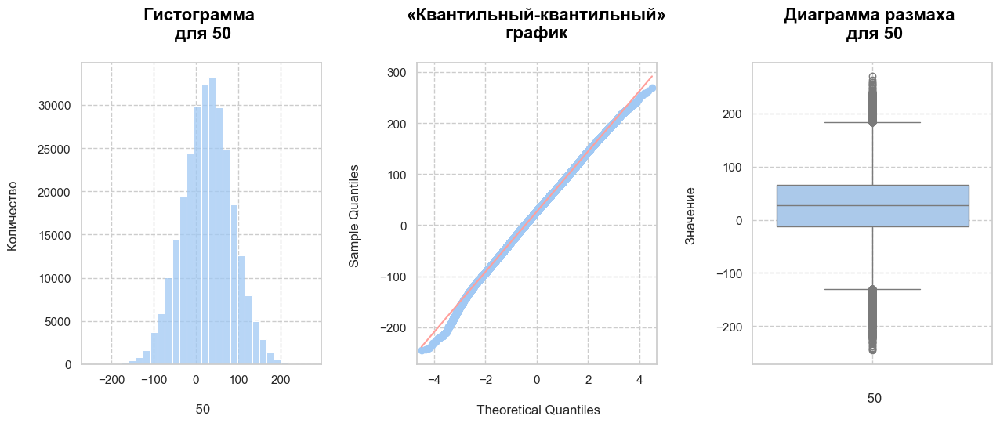

Датафрейм "df_base", колонка "51"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"258,109.000"
Мода,-17.678
Среднее арифметическое,-21.827
Дисперсия,"2,680.795"
Стандартное отклонение,51.776
Ошибка выборочного среднего,0.098
Минимум,-264.633
Квартиль 25%,-56.367


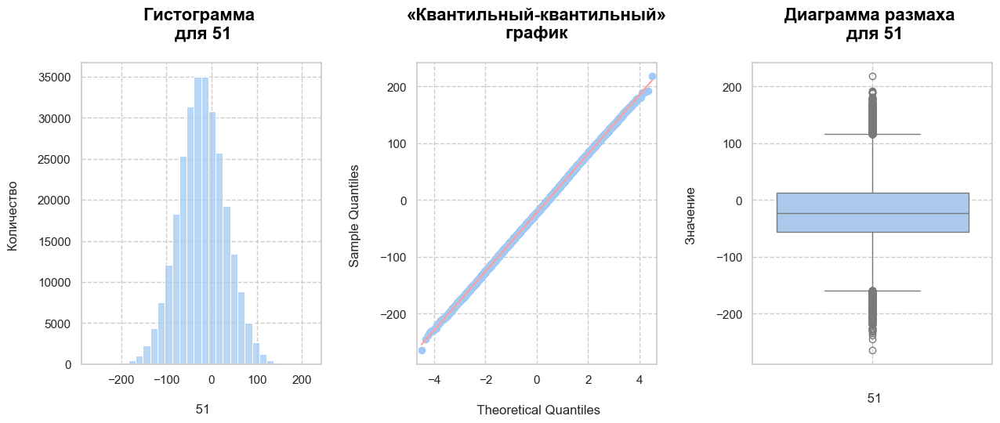

Датафрейм "df_base", колонка "52"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"254,030.000"
Мода,77.876
Среднее арифметическое,67.040
Дисперсия,170.626
Стандартное отклонение,13.062
Ошибка выборочного среднего,0.025
Минимум,16.127
Квартиль 25%,58.483


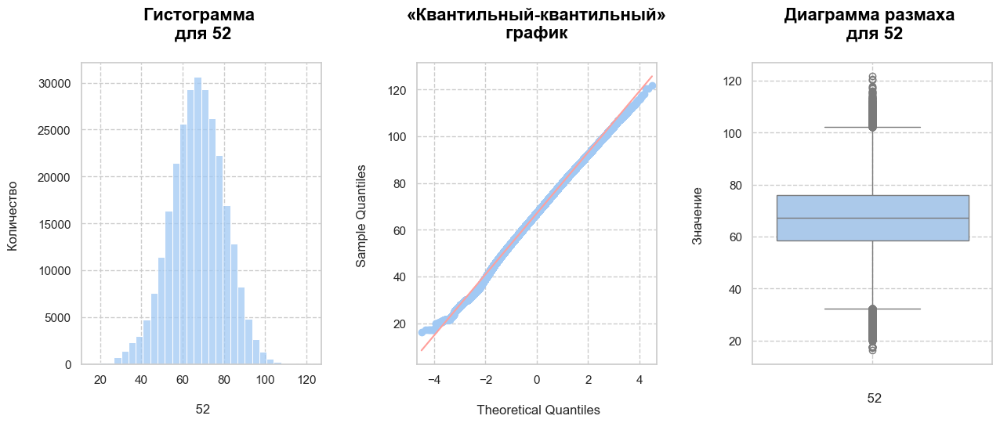

Датафрейм "df_base", колонка "53"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,941.000"
Мода,-76.697
Среднее арифметическое,-118.003
Дисперсия,"2,999.894"
Стандартное отклонение,54.771
Ошибка выборочного среднего,0.103
Минимум,-361.489
Квартиль 25%,-154.638


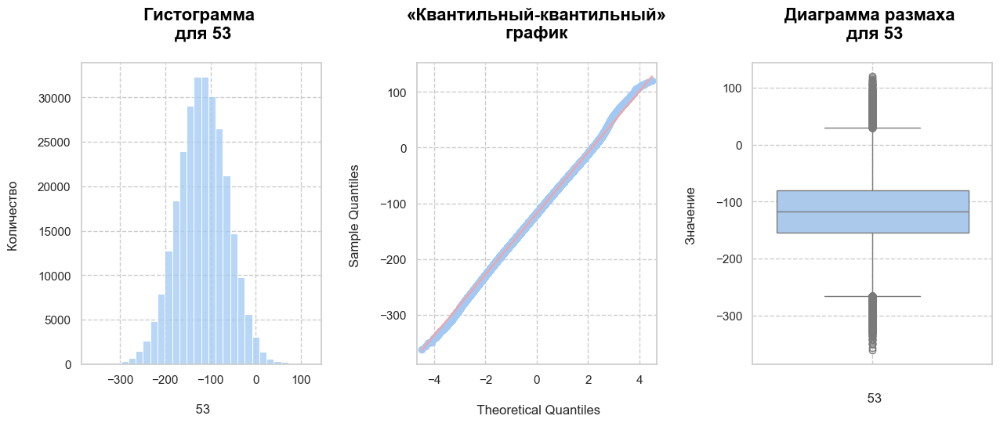

Датафрейм "df_base", колонка "54"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"244,403.000"
Мода,80.313
Среднее арифметическое,88.031
Дисперсия,22.787
Стандартное отклонение,4.774
Ошибка выборочного среднего,0.009
Минимум,66.851
Квартиль 25%,84.713


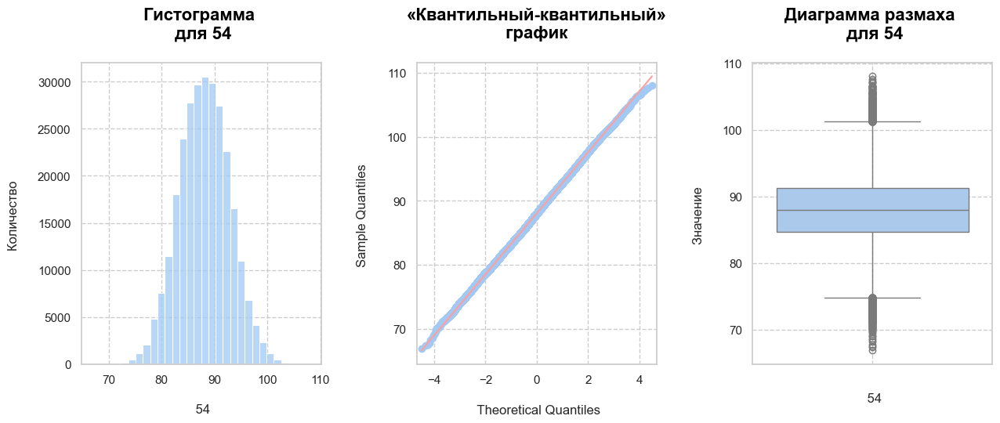

Датафрейм "df_base", колонка "55"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"253,656.000"
Мода,74.023
Среднее арифметическое,69.207
Дисперсия,142.867
Стандартное отклонение,11.953
Ошибка выборочного среднего,0.023
Минимум,18.997
Квартиль 25%,61.306


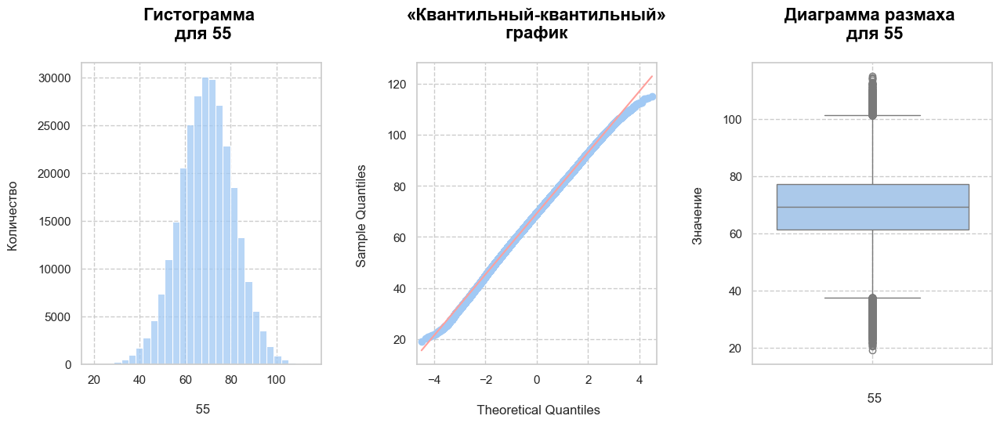

Датафрейм "df_base", колонка "56"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"242,801.000"
Мода,-134.760
Среднее арифметическое,-132.891
Дисперсия,61.151
Стандартное отклонение,7.820
Ошибка выборочного среднего,0.015
Минимум,-165.421
Квартиль 25%,-138.084


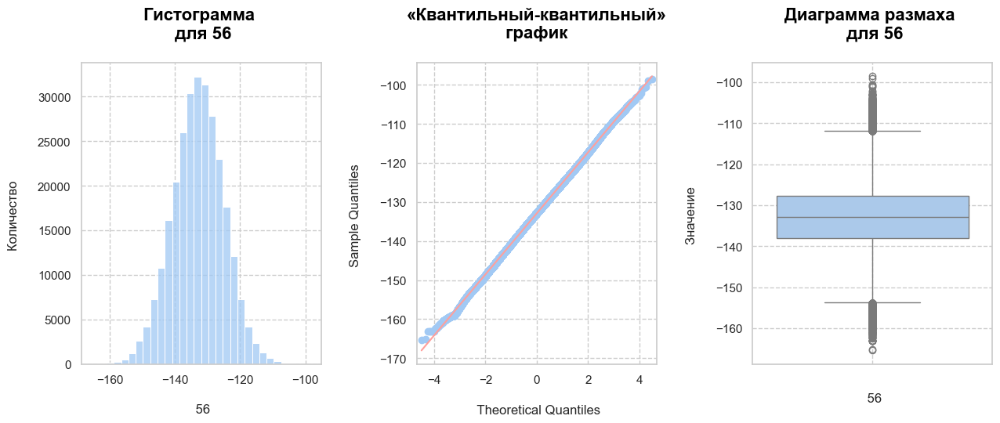

Датафрейм "df_base", колонка "57"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"258,263.000"
Мода,14.511
Среднее арифметическое,13.123
Дисперсия,"2,608.664"
Стандартное отклонение,51.075
Ошибка выборочного среднего,0.096
Минимум,-196.184
Квартиль 25%,-22.542


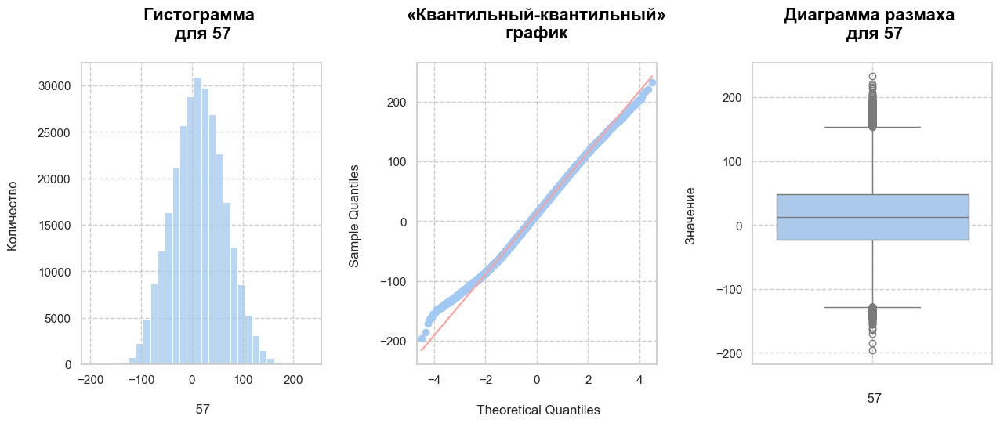

Датафрейм "df_base", колонка "58"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,953.000"
Мода,-146.788
Среднее арифметическое,-119.606
Дисперсия,"3,043.554"
Стандартное отклонение,55.168
Ошибка выборочного среднего,0.104
Минимум,-328.829
Квартиль 25%,-157.451


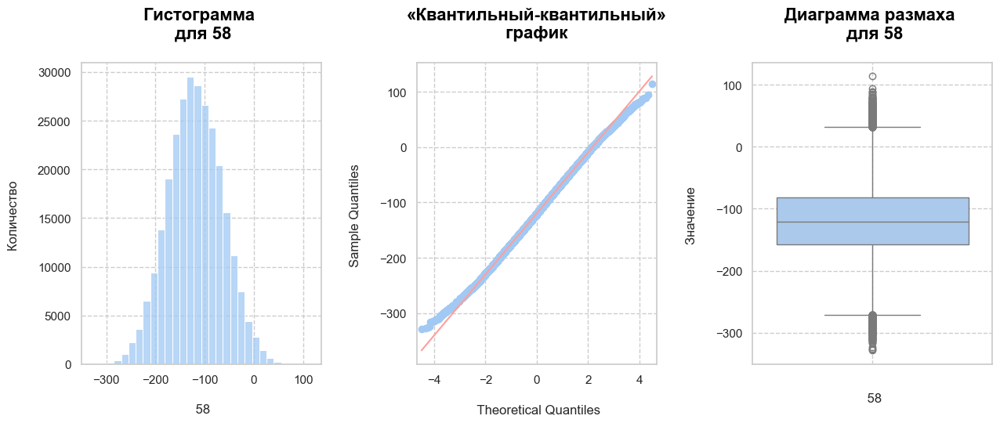

Датафрейм "df_base", колонка "59"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"279,007.000"
Мода,-675.113
Среднее арифметическое,-315.825
Дисперсия,"44,367.250"
Стандартное отклонение,210.635
Ошибка выборочного среднего,0.398
Минимум,-681.042
Квартиль 25%,-497.829


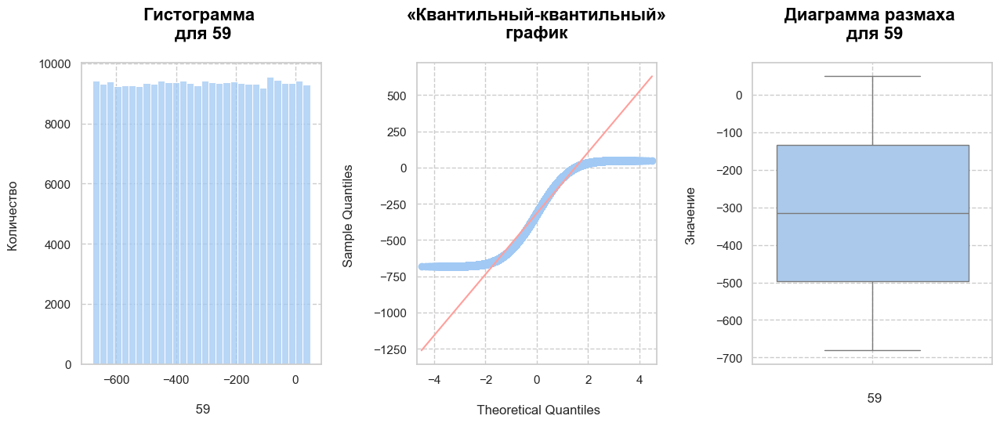

Датафрейм "df_base", колонка "60"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,717.000"
Мода,-5.997
Среднее арифметическое,-64.944
Дисперсия,"3,908.171"
Стандартное отклонение,62.515
Ошибка выборочного среднего,0.118
Минимум,-400.791
Квартиль 25%,-106.770


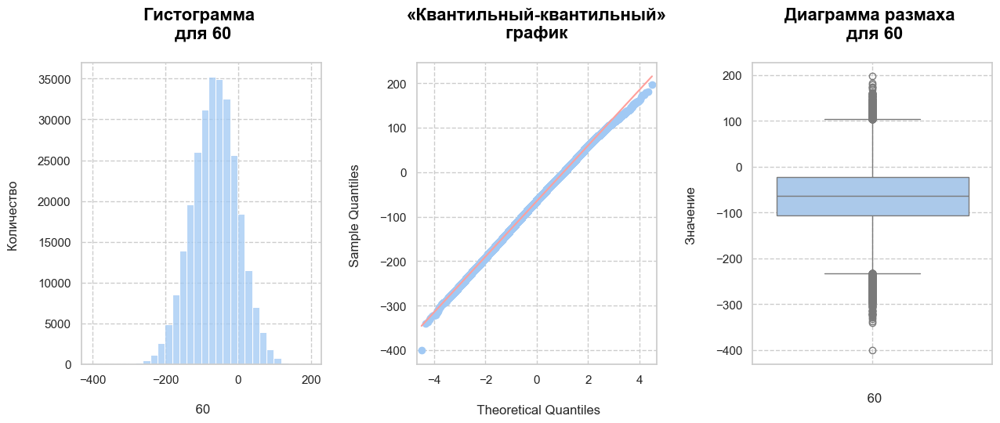

Датафрейм "df_base", колонка "61"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"246,906.000"
Мода,-119.457
Среднее арифметическое,-130.691
Дисперсия,91.588
Стандартное отклонение,9.570
Ошибка выборочного среднего,0.018
Минимум,-169.028
Квартиль 25%,-137.434


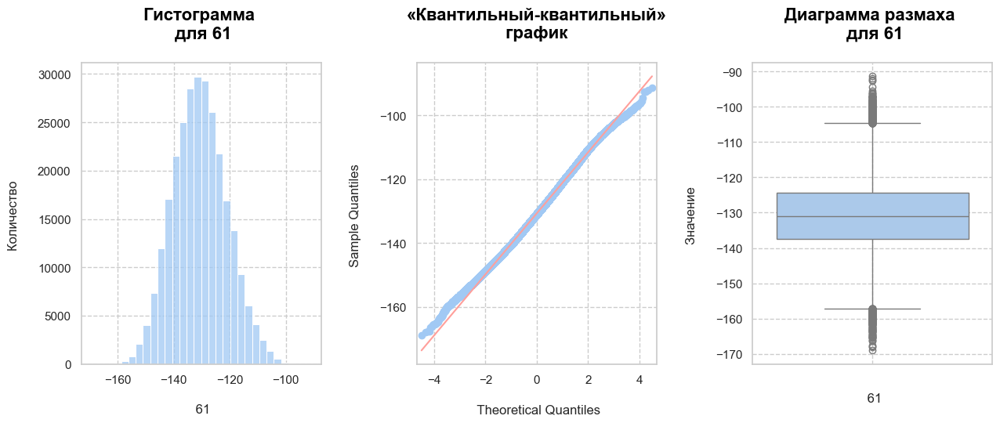

Датафрейм "df_base", колонка "62"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,611.000"
Мода,-24.285
Среднее арифметическое,-79.081
Дисперсия,929.313
Стандартное отклонение,30.485
Ошибка выборочного среднего,0.058
Минимум,-214.821
Квартиль 25%,-98.820


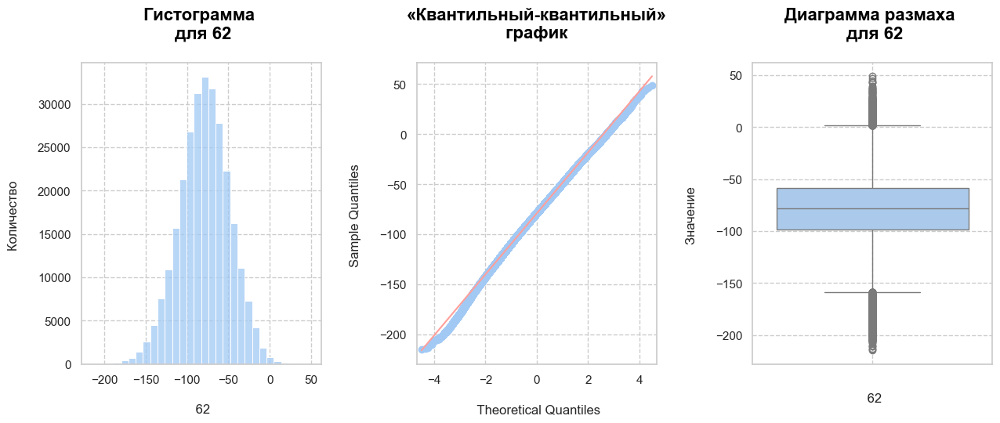

Датафрейм "df_base", колонка "63"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,562.000"
Мода,38.536
Среднее арифметическое,33.244
Дисперсия,835.278
Стандартное отклонение,28.901
Ошибка выборочного среднего,0.055
Минимум,-85.826
Квартиль 25%,16.946


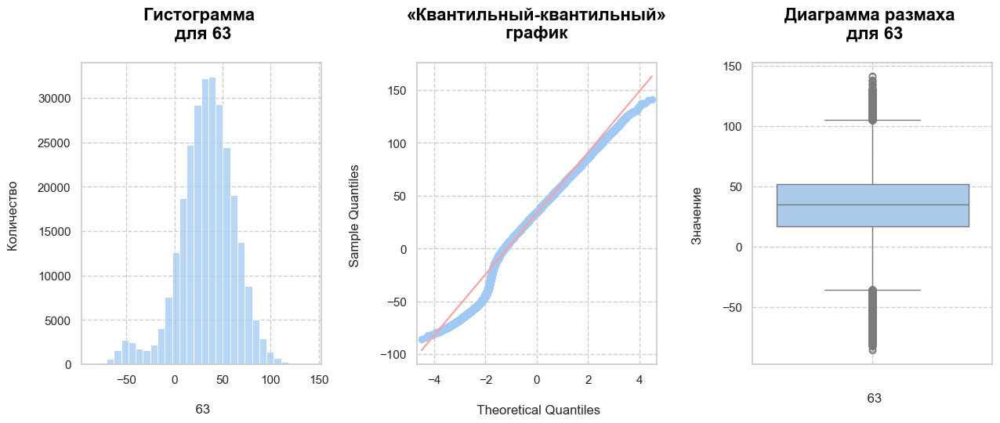

Датафрейм "df_base", колонка "64"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"255,489.000"
Мода,-199.946
Среднее арифметическое,-154.698
Дисперсия,"1,698.638"
Стандартное отклонение,41.215
Ошибка выборочного среднего,0.078
Минимум,-346.239
Квартиль 25%,-180.670


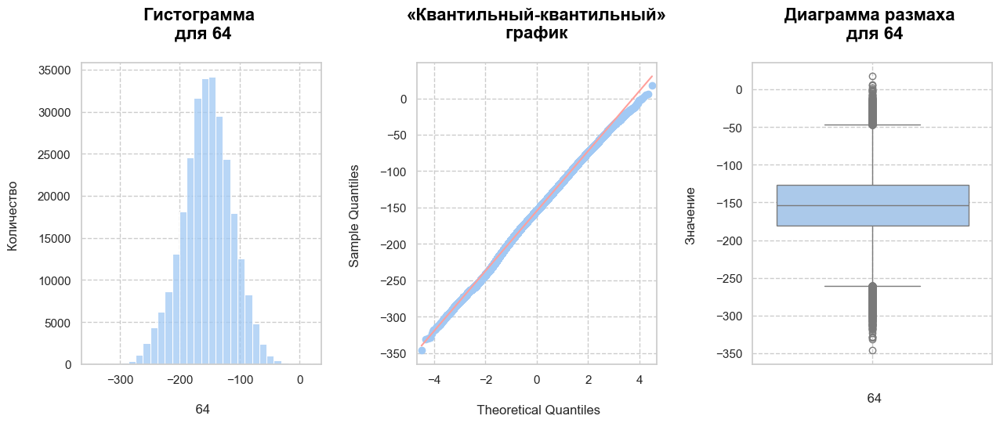

Датафрейм "df_base", колонка "65"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"256,657.000"
Мода,-21.533
Среднее арифметическое,13.696
Дисперсия,"9,799.768"
Стандартное отклонение,98.994
Ошибка выборочного среднего,0.187
Минимум,-157.594
Квартиль 25%,-71.738


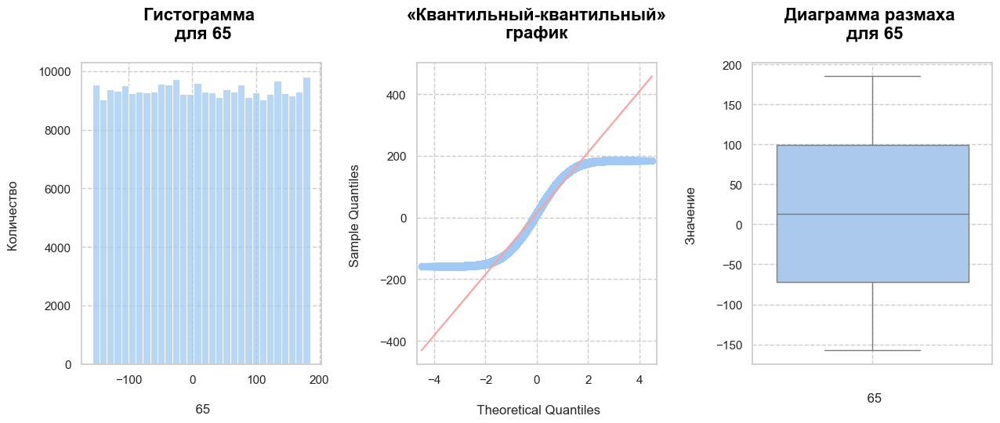

Датафрейм "df_base", колонка "66"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"224,081.000"
Мода,68.202
Среднее арифметическое,67.794
Дисперсия,3.332
Стандартное отклонение,1.825
Ошибка выборочного среднего,0.003
Минимум,59.836
Квартиль 25%,66.584


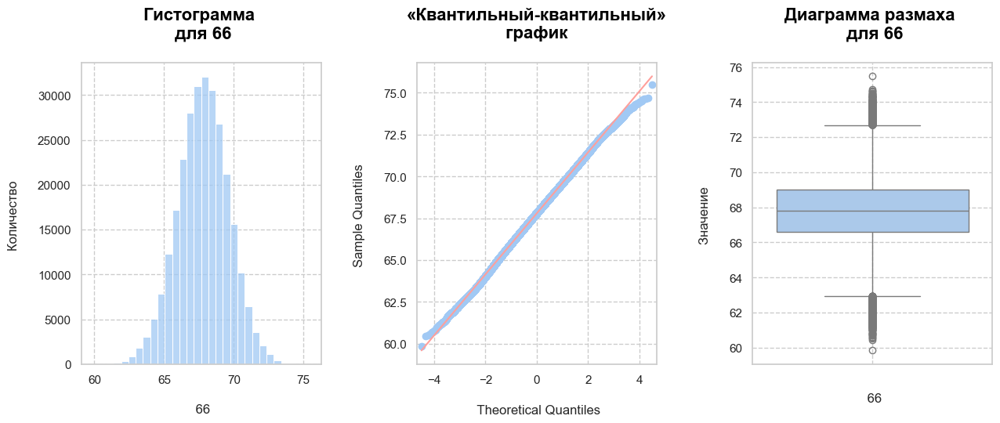

Датафрейм "df_base", колонка "67"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,894.000"
Мода,11.909
Среднее арифметическое,23.523
Дисперсия,"3,061.014"
Стандартное отклонение,55.326
Ошибка выборочного среднего,0.104
Минимум,-213.492
Квартиль 25%,-12.510


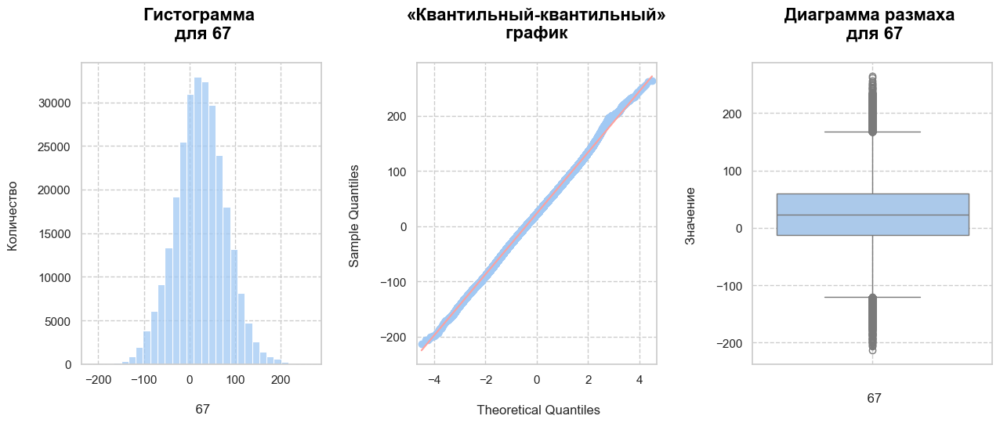

Датафрейм "df_base", колонка "68"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,492.000"
Мода,112.320
Среднее арифметическое,74.872
Дисперсия,"3,759.750"
Стандартное отклонение,61.317
Ошибка выборочного среднего,0.116
Минимум,-190.483
Квартиль 25%,33.796


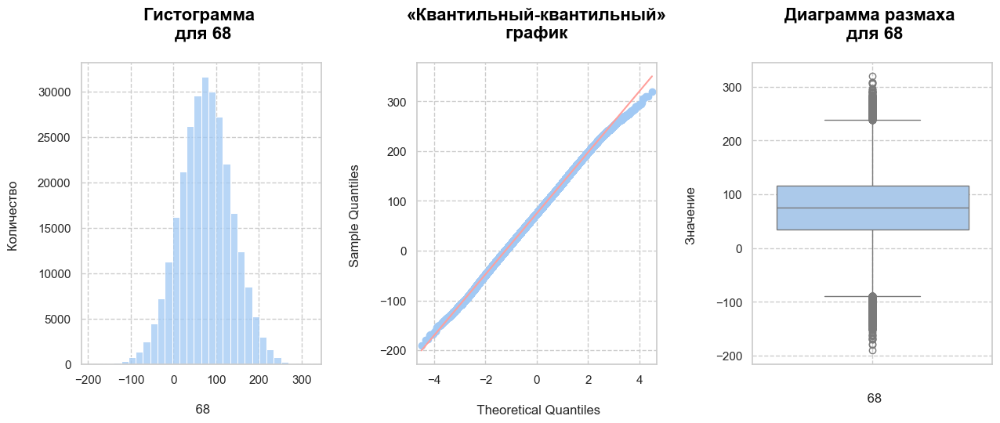

Датафрейм "df_base", колонка "69"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"254,869.000"
Мода,122.295
Среднее арифметическое,115.600
Дисперсия,450.216
Стандартное отклонение,21.218
Ошибка выборочного среднего,0.040
Минимум,18.601
Квартиль 25%,101.672


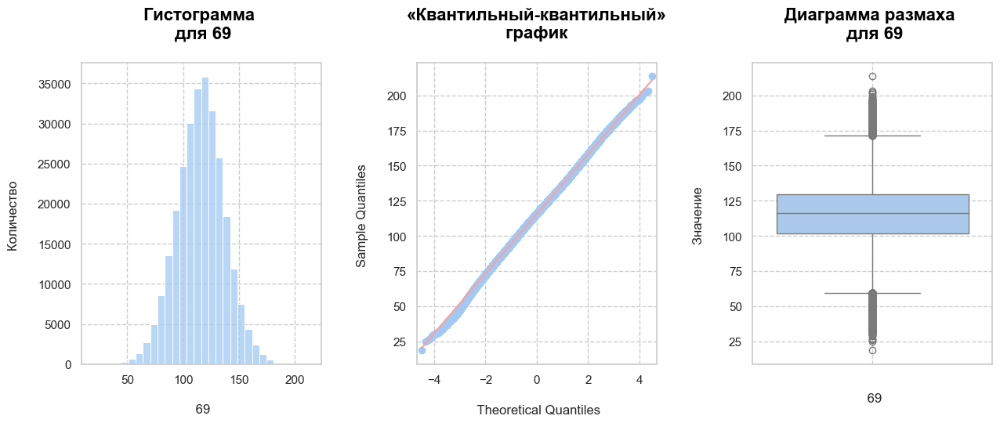

Датафрейм "df_base", колонка "70"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"160,803.000"
Мода,"-1,074.465"
Среднее арифметическое,-798.033
Дисперсия,"148,517.766"
Стандартное отклонение,385.380
Ошибка выборочного среднего,0.728
Минимум,"-1,297.925"
Квартиль 25%,"-1,074.465"


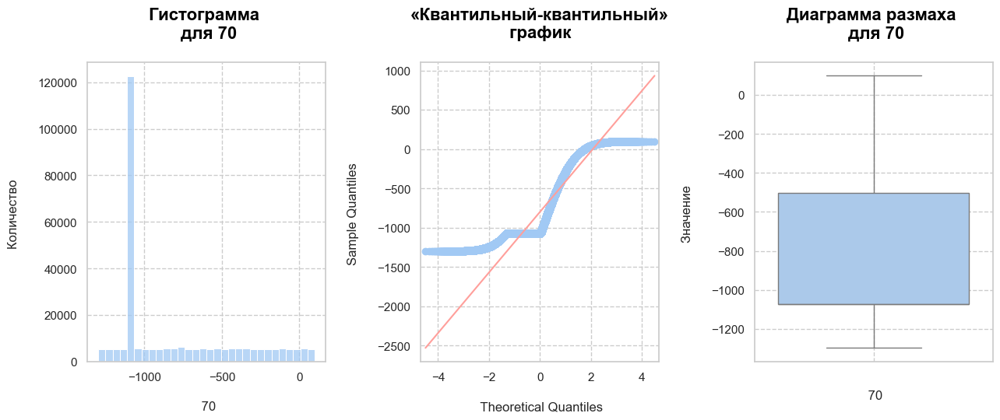

Датафрейм "df_base", колонка "71"

Описание столбца (числовой, type: float32):


c:\Users\user\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 280535.
  res = hypotest_fun_out(*samples, **kwds)


,Значения
Количество,"280,535.000"
Пропуски,0.000
Уникальных,"257,474.000"
Мода,-46.379
Среднее арифметическое,-47.712
Дисперсия,"1,741.172"
Стандартное отклонение,41.727
Ошибка выборочного среднего,0.079
Минимум,-209.936
Квартиль 25%,-75.637


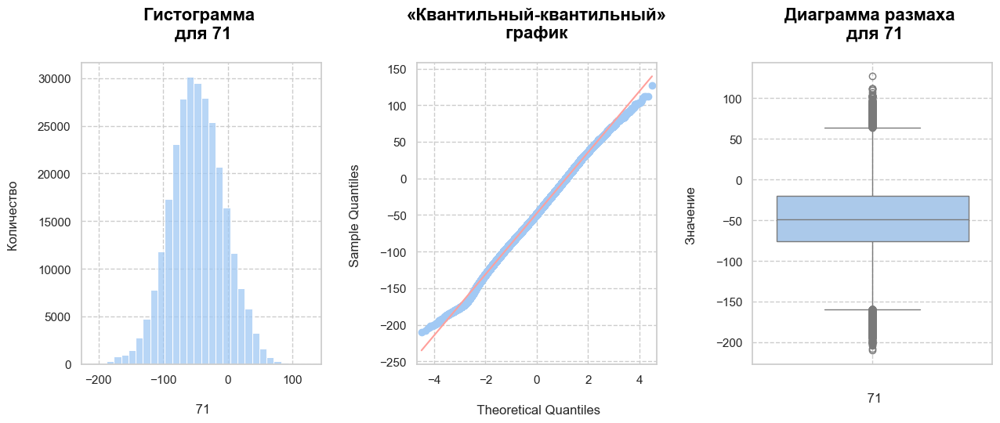

In [14]:
# вывожу на экран индивидуальный анализ для каждой колонки 
for col in df_base.columns:
    print(color.BLUE + color.BOLD + f'Датафрейм "df_base", колонка "{str(col)}"' + color.END)
    describe_data(df_base, col)

**Промежуточные выводы:**
- подавляющее большинство признаков (89%) имеют нормальное распределение;
- признак `6` распределён практически равномерно, видны 2 моды;
- признаки `21` и `25` - практически константа с модой в значениях 1500 и 800, соответственно. Исключим их из датасета;
- признак `33` имеет мультимодальное распределение;
- признак `44` распределён практически равномерно с пиком в значении около -65;
- признаки `59` и `65` имеют равномерное распределение;
- признак `70` - также практически константа с модой в значении -1100. Исключим его из всех датафреймов.

In [15]:
# исключаю признаки 21, 25 и 70
df_base = df_base.drop(['21', '25', '70'], axis=1)
display(df_base.sample(3))
df_train = df_train.drop(['21', '25', '70'], axis=1)
display(df_train.sample(3))
df_validation = df_validation.drop(['21', '25', '70'], axis=1)
display(df_validation.sample(3))

df_base,Id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71
131267,373023-base,-116.428,9.695,-60.633,-113.770,43.181,-85.013,-530.125,-22.869,132.121,207.804,-168.477,42.419,-56.883,27.386,115.188,-11.257,-6.562,30.485,-36.164,-78.615,-109.041,10.895,84.603,37.614,-27.210,15.469,8.001,151.955,41.068,-195.252,108.232,-143.384,29.249,97.896,29.011,-141.026,-124.772,-56.928,-11.530,12.655,-94.817,209.439,-50.057,57.050,-13.937,-122.645,46.915,-7.978,71.111,-19.459,52.313,-75.212,90.374,66.001,-123.142,11.017,-166.767,-196.431,-121.233,-129.446,-84.555,62.234,-132.644,132.565,66.283,75.579,113.819,122.926,-62.726
199685,1067876-base,-66.372,3.299,-67.834,-155.356,183.043,-75.145,-433.456,120.034,127.632,140.209,-135.732,-61.225,-57.475,-9.753,180.676,-25.073,7.900,-0.665,-138.150,-80.579,-84.962,0.647,33.310,43.923,-107.048,18.361,-93.520,147.286,-8.722,-112.744,21.679,-303.939,-16.050,111.325,-26.718,-143.361,-91.282,-15.315,-10.260,-0.322,-203.797,165.103,-23.113,84.718,-153.483,-181.285,42.710,-106.796,-10.032,8.436,81.463,-60.187,86.592,61.491,-135.907,-42.975,-111.884,-373.734,-71.101,-118.889,-77.330,19.034,-140.623,37.320,69.217,14.507,63.686,94.041,-66.673
108226,1287101-base,-82.862,9.470,-59.509,-154.190,97.533,-25.561,-615.345,69.307,122.531,83.366,-185.697,-112.306,-26.648,71.743,128.033,-4.114,40.911,-104.828,-105.348,-79.673,-156.700,-75.978,68.234,38.372,-9.993,15.946,-10.841,149.233,28.807,-100.707,79.867,-537.184,39.149,118.145,-33.642,-154.579,-130.035,-44.623,-21.336,-2.624,-182.812,41.109,-18.252,101.578,13.095,-134.195,87.352,-24.397,21.827,1.821,75.053,-86.918,88.823,61.339,-131.167,-32.369,-101.462,-672.235,-18.250,-144.384,-64.031,-38.859,-112.795,-47.738,69.299,20.973,138.678,120.240,-96.651


df_train,Id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71,Target
6654,167473-query,-70.508,0.258,-95.502,-134.844,163.888,-58.933,24.676,63.360,120.424,118.530,-166.205,-92.003,-165.588,-8.139,92.813,-9.927,12.454,-161.090,-137.134,-80.272,-122.487,-62.761,51.141,-7.068,-39.940,17.351,-52.946,164.236,-38.084,-135.031,104.554,-447.850,27.693,56.052,1.752,-143.422,-134.627,-21.863,-2.988,2.727,-84.481,149.328,-61.441,81.691,-92.417,-79.001,163.775,-22.214,-119.220,-42.111,76.240,-107.875,88.551,68.481,-128.594,-47.837,-142.409,-269.633,3.361,-135.980,-87.548,41.795,-142.855,126.728,66.366,63.956,50.928,80.046,-39.917,2288144-base
5532,41142-query,-71.897,16.475,-122.583,-94.005,157.993,-39.156,-328.962,-37.751,117.360,118.135,-142.987,-86.703,59.712,-8.561,133.695,-23.970,0.364,37.553,-110.040,-79.452,-65.105,-26.653,98.402,-10.834,-44.173,23.496,-132.475,157.110,-46.606,-170.372,101.136,-529.295,27.190,79.718,16.386,-136.585,-108.493,-3.510,-0.489,8.729,-128.717,153.647,-20.873,63.995,-30.813,-240.442,15.206,78.183,96.307,41.602,90.637,-151.488,85.766,60.373,-135.172,-109.119,-143.116,-612.807,17.983,-112.039,-54.022,16.406,-171.711,-29.626,68.858,30.619,117.787,119.076,-11.123,555308-base
4424,7169-query,-83.790,9.031,-28.550,-131.214,83.853,-87.670,-424.939,-97.807,123.312,138.154,-257.387,-154.480,-89.876,40.006,124.080,-35.735,46.508,-28.292,-181.145,-79.874,-111.239,-113.270,19.184,-1.081,-108.658,11.031,-73.338,153.092,12.500,-144.925,99.579,-970.272,-1.624,38.526,3.559,-166.975,-104.483,-81.385,-8.443,5.583,-118.489,156.189,-41.083,43.698,-178.677,-181.775,86.792,-4.623,-16.325,52.625,58.141,-199.392,90.066,80.824,-129.156,88.444,-201.037,-187.668,-98.369,-121.366,-83.373,10.398,-89.142,36.327,69.087,-82.893,159.634,114.053,-37.064,694903-base


df_validation,Id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71
8472,45366-query,-110.626,6.594,23.651,-131.964,146.952,-108.660,33.474,15.487,127.363,173.818,-136.764,-120.617,-59.614,51.895,130.114,-24.254,2.971,-29.866,-173.001,-79.201,-154.792,-21.876,35.120,8.654,-46.121,12.480,-78.020,150.245,-15.865,-103.306,94.731,-190.858,88.065,62.362,9.434,-152.330,-113.943,-73.013,-15.315,11.617,-157.787,63.649,-17.003,45.884,-59.114,-58.898,58.242,-39.682,39.556,-52.588,64.548,-71.942,83.046,96.250,-129.919,42.123,-131.990,-617.802,-116.669,-147.020,-42.615,24.889,-149.633,182.437,64.672,8.856,37.090,97.105,-39.909
7277,51822-query,-40.909,9.668,-56.885,-131.929,113.092,-95.328,-110.122,-36.498,121.524,93.984,-159.682,77.198,-61.877,15.290,182.925,13.316,-31.585,1.877,-169.643,-78.044,-101.813,-37.928,62.434,23.597,-2.268,17.263,-109.454,142.484,51.167,-169.020,61.777,-499.366,50.227,52.730,-50.715,-116.353,-113.071,-41.901,-12.024,15.041,-141.855,200.893,-25.215,31.382,-113.435,-105.459,17.054,-2.294,-20.720,-115.063,57.161,-203.843,88.588,76.557,-118.723,20.936,-190.516,-334.584,-220.083,-128.246,-90.712,30.373,-132.625,-20.696,68.208,64.265,-30.824,118.740,-56.486
171,169167-query,-54.077,8.221,-11.972,-135.813,109.781,-94.720,-759.626,18.997,118.248,184.114,-175.103,-32.860,-12.635,-19.201,188.889,-23.116,-24.972,-24.549,-166.245,-79.323,-111.233,23.886,107.310,19.696,-134.085,18.180,-86.161,159.813,-26.601,-213.881,99.074,-655.729,65.984,50.718,-16.535,-162.198,-105.485,-66.814,-10.774,2.166,-60.416,101.830,-30.130,52.025,-74.880,-93.915,74.148,52.241,64.277,-70.993,59.967,-1.549,88.219,62.712,-130.735,-77.639,-44.934,-489.999,-117.207,-133.435,-132.622,15.051,-120.668,93.136,69.735,-42.751,20.798,80.904,-148.207


Сравним попарно данные в датафреймах df_base и df_train.

                                             |          | [  0%]   00:00 -> (? left)


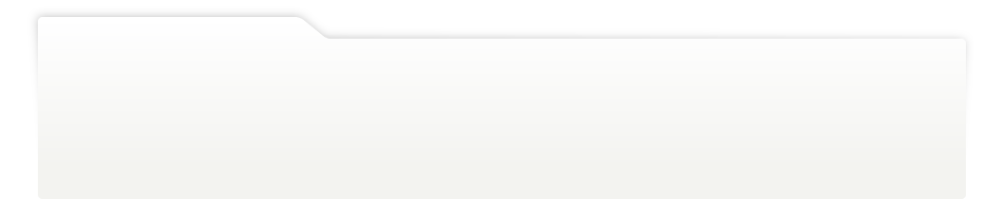
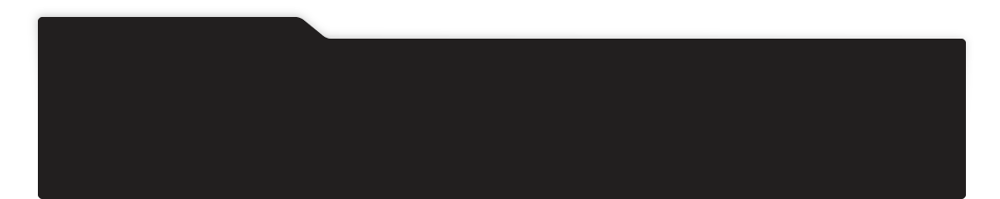
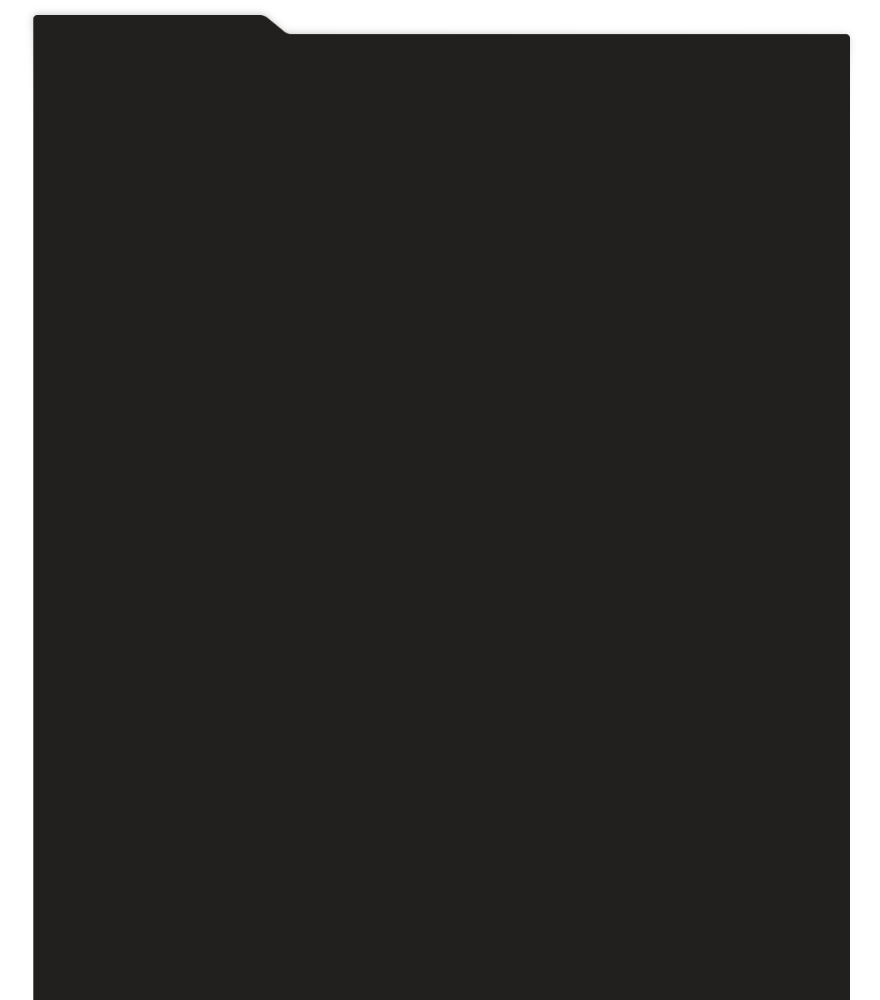
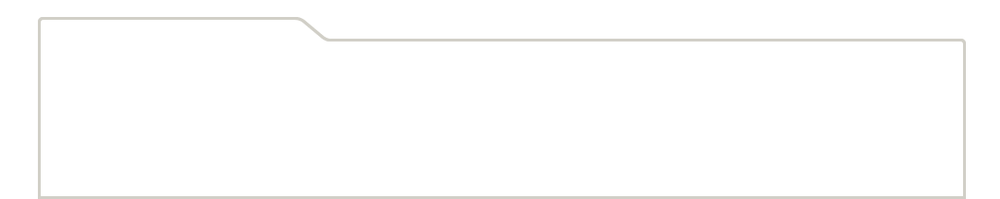
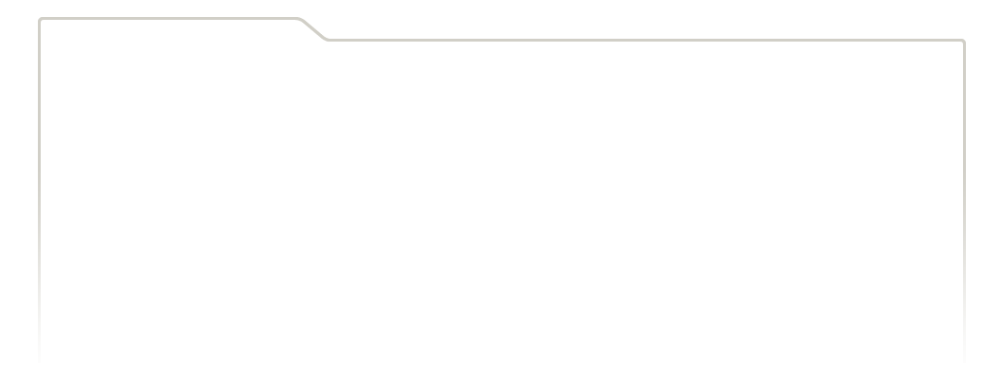
...
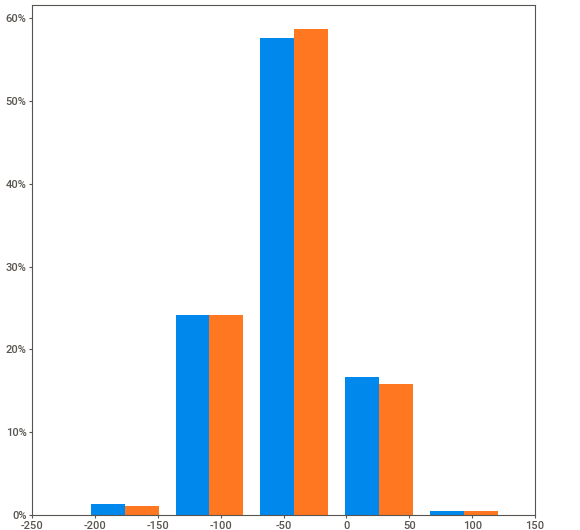
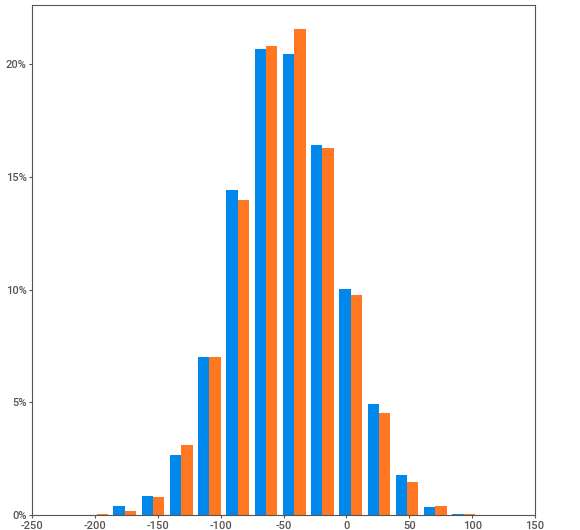
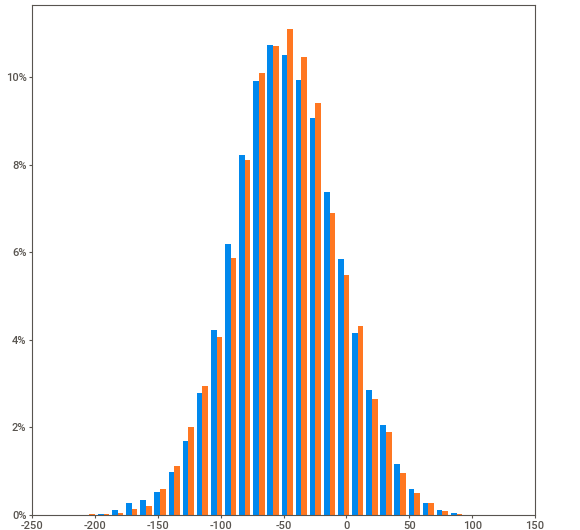
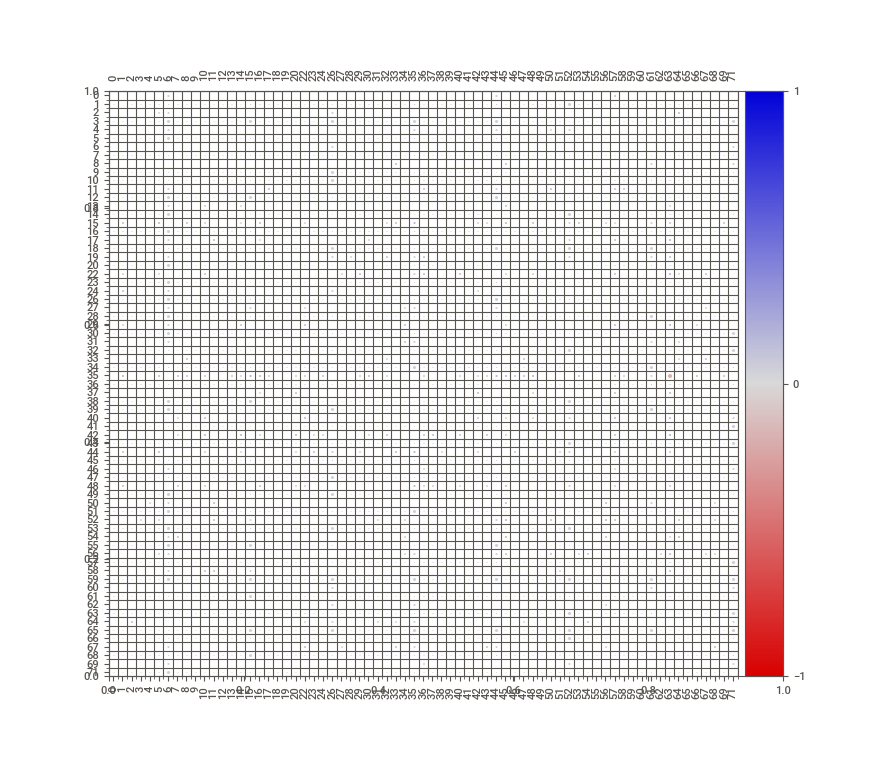
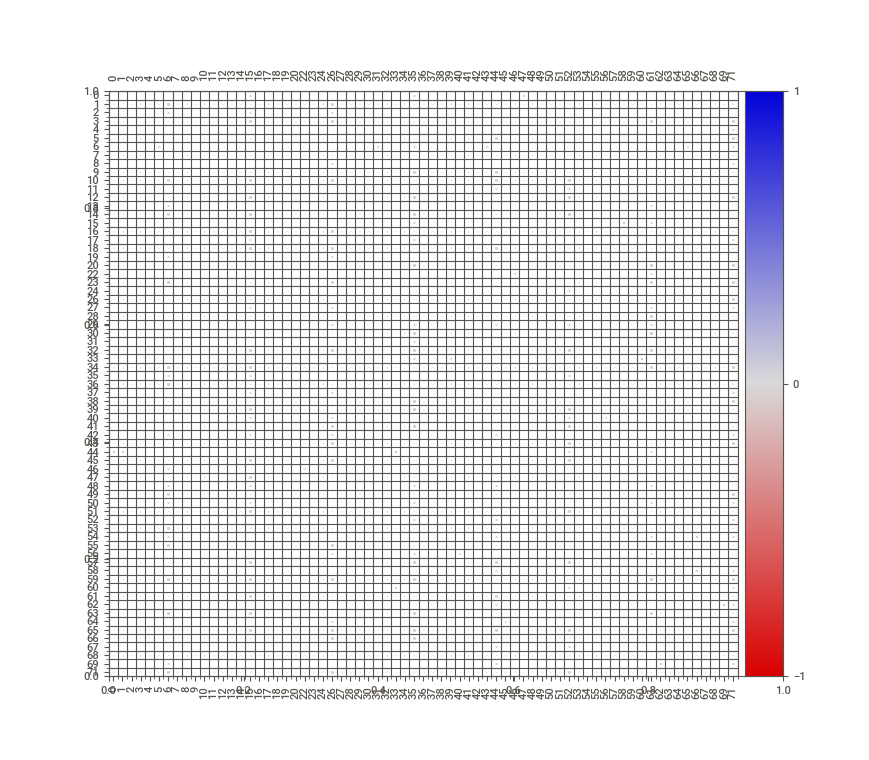

In [16]:
# использую библиотеку sweetviz, применяю функцию compare()
comp_df = sv.compare(
    [
        df_base.drop([
          'Id'
        ], axis=1),
        'Базовые'
    ],
    [
        df_train.drop([
          'Id',
          'Target'
        ], axis=1),
        'Тренировочные'
    ]
)

# применяю метод show_notebook() для вывода сравнения на экран
comp_df.show_notebook(scale=0.95)

Сравним попарно данные в датафреймах df_train и df_validation.

                                             |          | [  0%]   00:00 -> (? left)


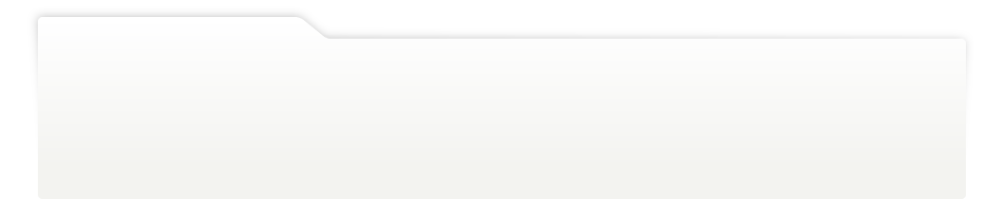
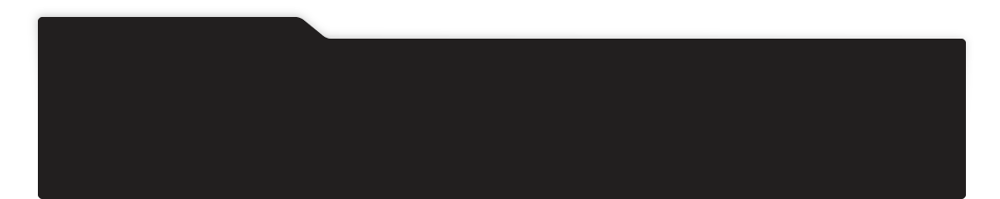
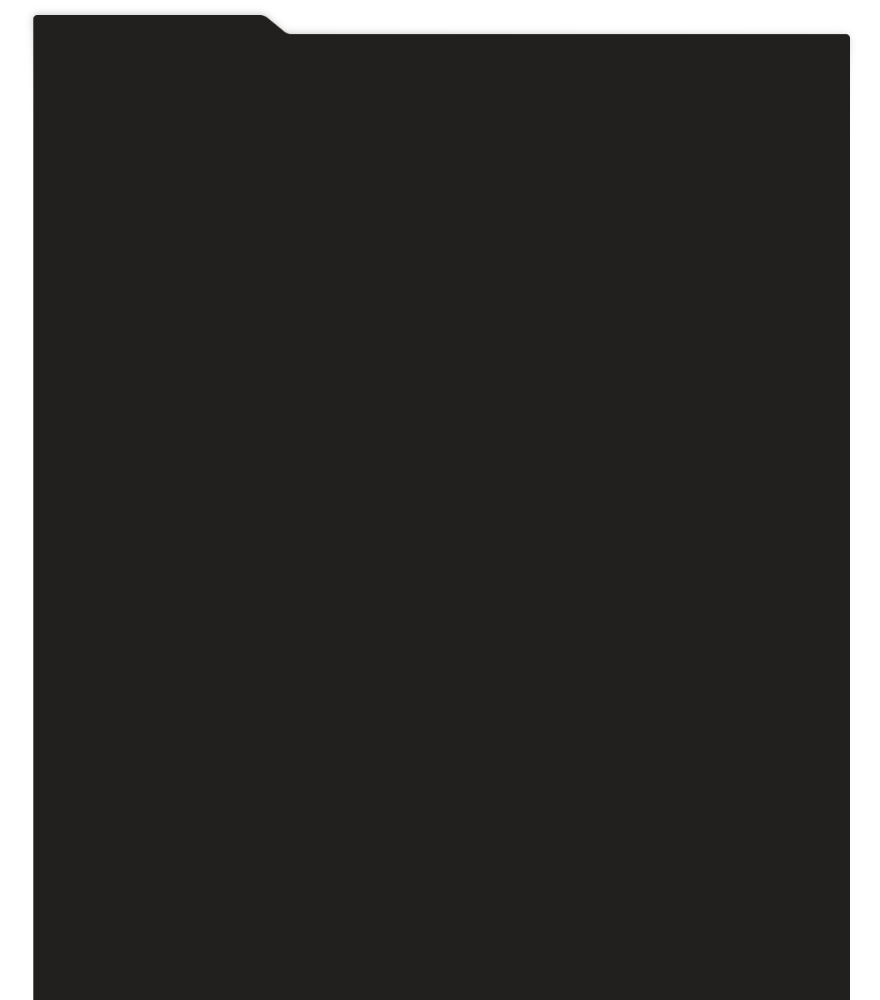
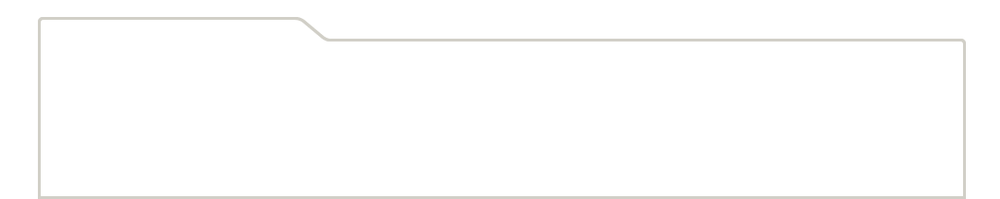
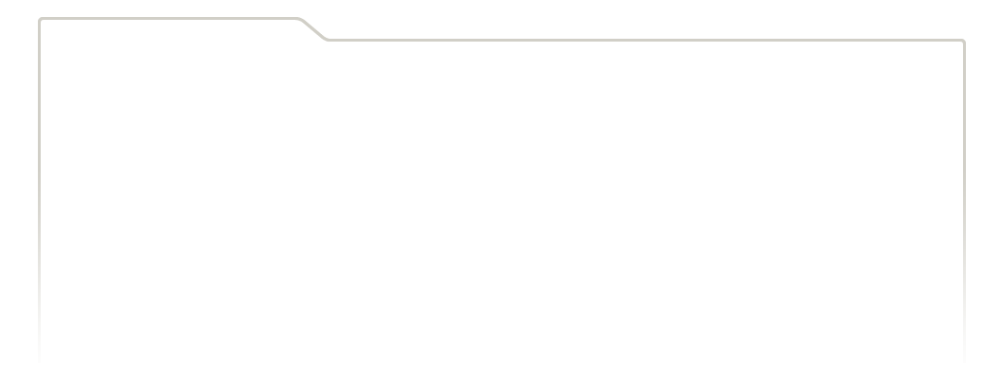
...
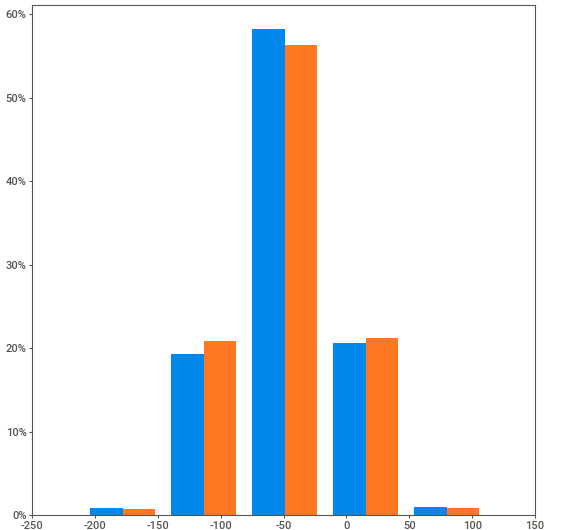
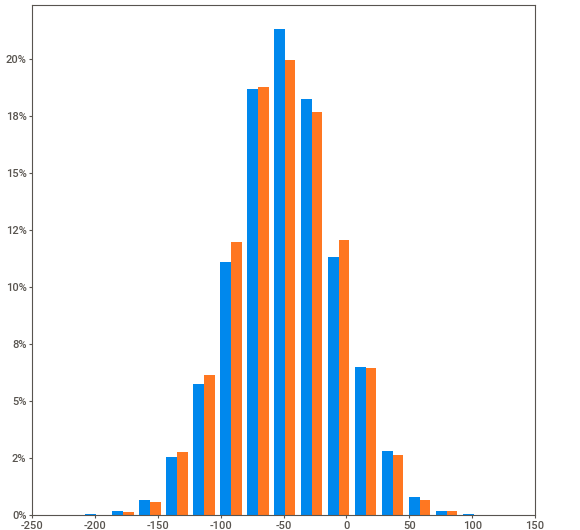
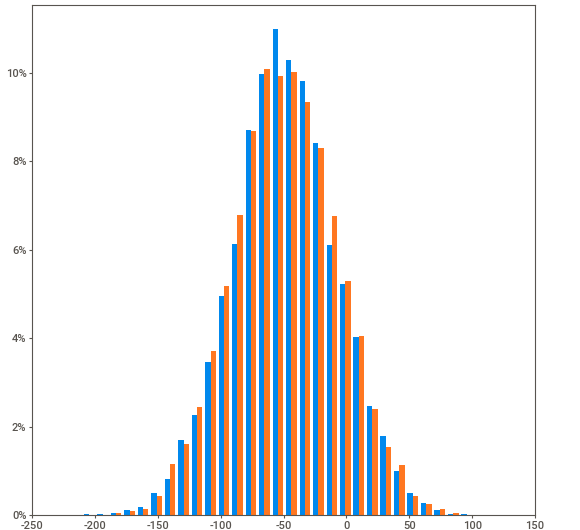
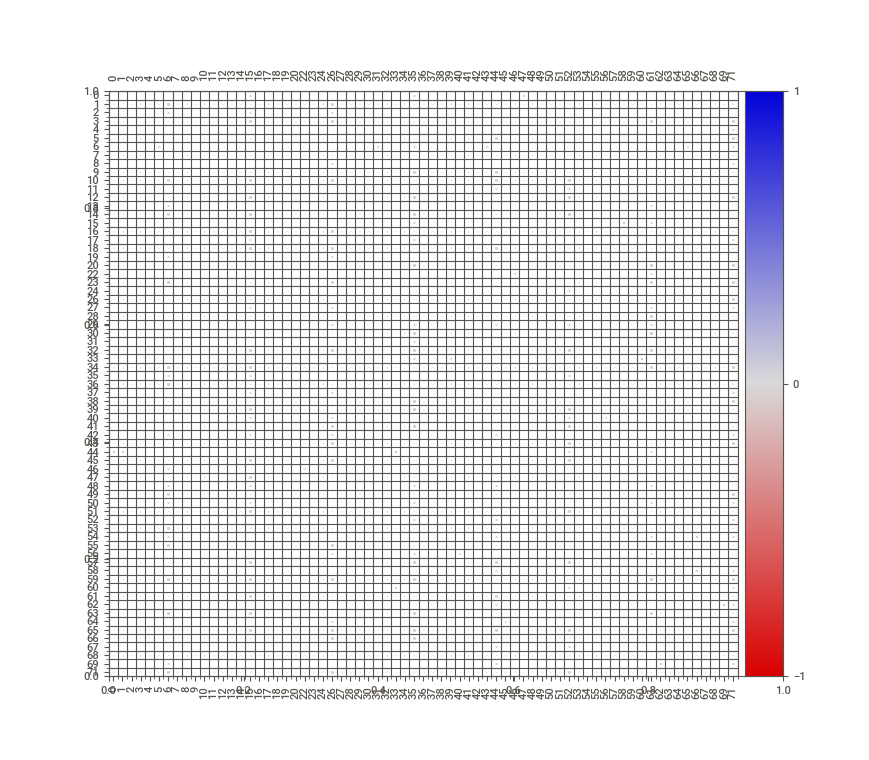
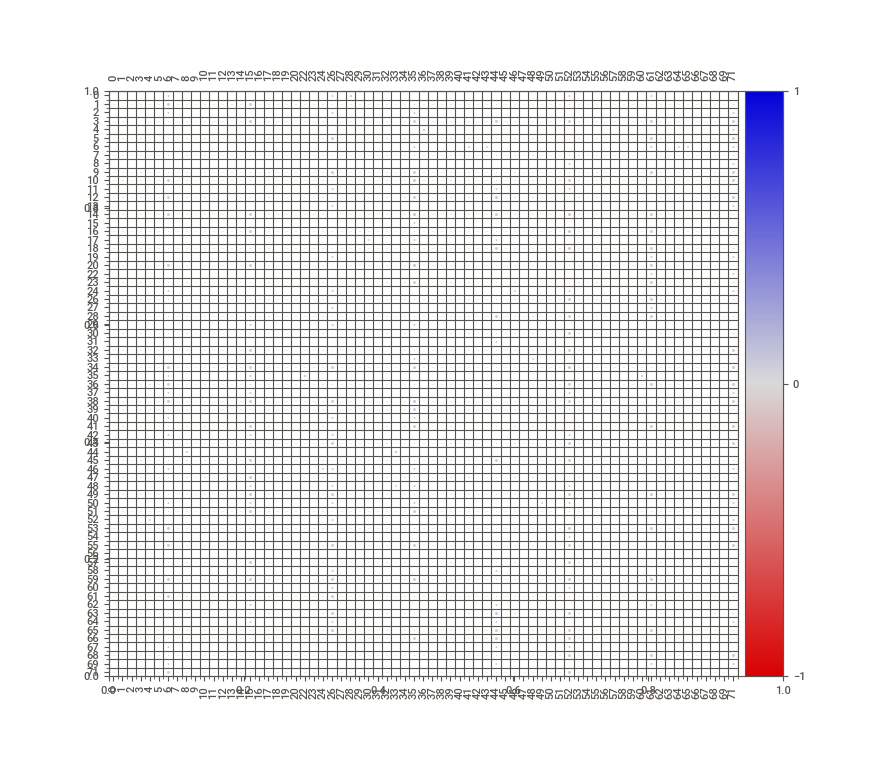

In [17]:
# использую библиотеку sweetviz, применяю функцию compare()
comp_df = sv.compare(
    [
        df_train.drop([
          'Id',
          'Target'
        ], axis=1),
        'Тренировочные'
    ],
    [
        df_validation.drop([
          'Id'
        ], axis=1),
        'Валидационные'
    ]
)

# применяю метод show_notebook() для вывода сравнения на экран
comp_df.show_notebook(scale=0.95)

**Промежуточные выводы:**
- попарное визуальное сравнение признаков для датафреймов [df_base <> df_train] и [df_train <>> df_validation] показали, что распределния данных в каждой колонке практически идентично. Тренировочная и валидационная выборки репрезентативно представлены.

### Анализ корреляции признаков

Проведём корреляционный анализ.<br>
Изучим взаимосвязи между признаками с применением хи-квадрат статистики.<br>

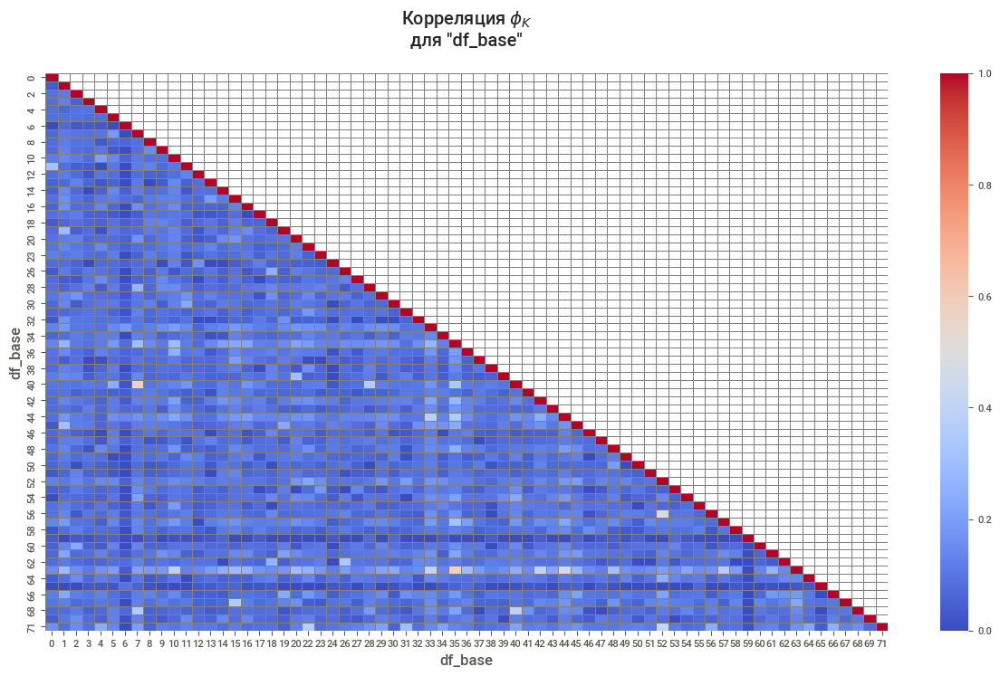

c:\Users\user\anaconda3\Lib\site-packages\phik\data_quality.py:59: UserWarning: The number of unique values of variable Target is large: 8924. Are you sure this is not an interval variable? Analysis for pairs of variables including Target can be slow.
  warnings.warn(


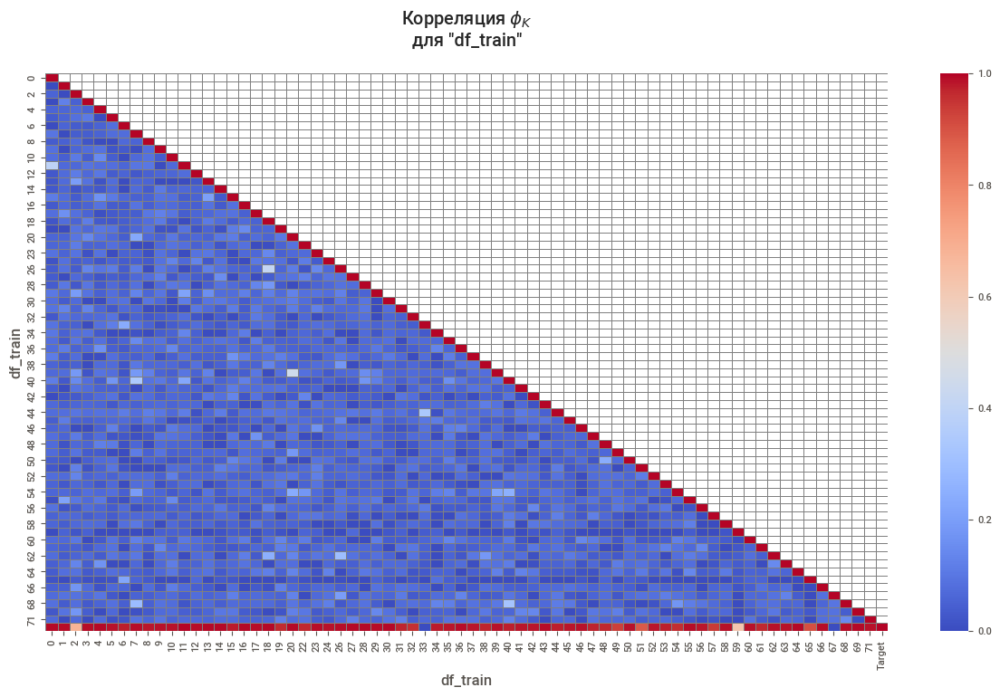

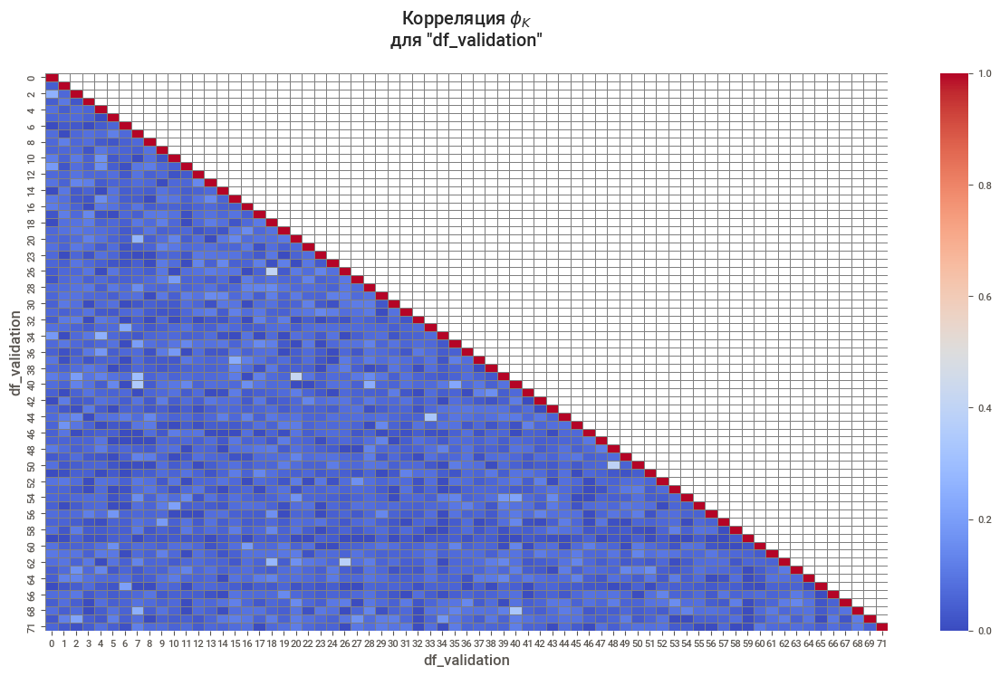

In [18]:
# с помощью цикла вывожу матрицу корреляций для 3 датафреймов
for df in [df_base, df_train, df_validation]:

    # создаю переменную с результатами корреляционного анализа
    check_corr = (df
                .drop('Id', axis=1)
                .sample(9000)
                .phik_matrix(interval_cols=df.select_dtypes(include='number'))
                )

    # создаю тепловую карту корреляционного анализа
    fig, ax = plt.subplots(figsize=(15, 8))

    # создаю маски для отображения нижнего "треугольника зависимостей" и основной диагонали
    mask = np.triu(np.ones_like(check_corr))
    mask[np.diag_indices_from(mask)] = False

    sns.heatmap(
        check_corr,
        # annot=True,
        # fmt='.2g',
        vmin=0,
        vmax=1,
        cmap='coolwarm',
        linewidths=0.5,
        linecolor='grey',
        square=False,
        mask=mask,
        ax=ax
        )
    ax.set_title(f'Корреляция $\phi_K$ \n для "{df.columns.name}" \n')

    plt.show()

**Промежуточные выводы:**
- матрицы корреляций для 3 датасетов не показали столбцов с мультиколинеарностью;
- признак 63 имеет более тесную связь с другими столбцами, но эта связь преимущественно ниже 0.5.

После исключения признаков, снова проверим датафрейм на наличие явных дубликатов.

In [19]:
# вывожу на экран явные дубликаты
print(color.BLUE + color.BOLD + 
      f'Количество явных дубликатов в датафрейме "df_base": {df_base.duplicated().sum()}'
     + color.END)
print(color.BLUE + color.BOLD + 
      f'Количество явных дубликатов в датафрейме "df_train": {df_train.duplicated().sum()}'
     + color.END)
print(color.BLUE + color.BOLD + 
      f'Количество явных дубликатов в датафрейме "df_validation": {df_validation.duplicated().sum()}'
     + color.END)

Количество явных дубликатов в датафрейме "df_base": 0
Количество явных дубликатов в датафрейме "df_train": 0
Количество явных дубликатов в датафрейме "df_validation": 265


Новых явных дубликатов нет.

## Подготовка данных

Используем масштабирование, чтобы каждая переменная имела одинаковую важность при обучении и настройке алгоритмов. В противном случае переменные с самыми широкими диапазонами имели бы слишком большое влияние.

In [20]:
# подготавливаю данные для датафрейма "df_base"
df_base_clus = df_base.drop(['Id'], axis=1)
df_base_pr = StandardScaler().fit_transform(df_base_clus)
df_base_pr = normalize(df_base_pr)
df_base_pr = pd.DataFrame(df_base_pr, columns=df_base_clus.columns)
print(color.BLUE + color.BOLD + 'Датафрейм df_base после подготовки:' + color.END)
display(df_base_pr.sample(3))

# подготавливаю данные для датафрейма "df_train"
df_train_clus = df_train.drop(['Id', 'Target'], axis=1)
df_train_pr = StandardScaler().fit_transform(df_train_clus)
df_train_pr = normalize(df_train_pr)
df_train_pr = pd.DataFrame(df_train_pr, columns=df_train_clus.columns)
print(color.BLUE + color.BOLD + 'Датафрейм df_train после подготовки:' + color.END)
display(df_train_pr.sample(3))

# подготавливаю данные для датафрейма "df_validation"
df_validation_clus = df_validation.drop(['Id'], axis=1)
df_validation_pr = StandardScaler().fit_transform(df_validation_clus)
df_validation_pr = normalize(df_validation_pr)
df_validation_pr = pd.DataFrame(df_validation_pr, columns=df_validation_clus.columns)
print(color.BLUE + color.BOLD + 'Датафрейм df_train после подготовки:' + color.END)
display(df_validation_pr.sample(3))

Датафрейм df_base после подготовки:


df_base,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71
275365,0.026,-0.079,0.087,-0.133,0.133,0.149,0.181,-0.138,0.110,-0.045,-0.004,-0.144,-0.102,0.150,0.082,0.006,-0.122,-0.113,0.247,-0.021,-0.066,-0.153,0.112,0.011,-0.246,-0.091,-0.021,0.228,0.016,-0.147,-0.132,-0.126,0.035,0.162,-0.010,-0.111,0.072,-0.050,-0.084,-0.111,-0.097,-0.102,-0.170,0.175,-0.364,-0.034,-0.083,-0.114,-0.047,-0.008,0.128,-0.015,0.039,-0.137,-0.057,0.011,0.048,-0.156,-0.029,0.156,0.060,-0.152,-0.035,0.105,-0.072,-0.007,0.070,-0.097,0.209
23166,0.163,0.189,0.014,-0.250,-0.049,-0.039,-0.148,-0.170,-0.082,0.080,-0.092,-0.150,0.137,0.026,-0.133,0.131,-0.005,0.065,-0.146,-0.051,-0.094,-0.067,-0.050,0.083,-0.053,0.155,0.081,0.026,0.140,-0.015,-0.069,-0.115,0.015,-0.052,0.171,0.194,-0.144,0.190,-0.159,0.131,0.103,-0.194,-0.177,0.018,-0.178,-0.083,-0.186,0.156,-0.019,-0.107,0.034,0.082,0.108,0.140,-0.220,0.218,0.045,-0.032,0.077,-0.104,-0.096,-0.102,0.122,-0.088,0.047,-0.192,-0.015,-0.044,-0.050
13661,0.038,-0.013,-0.156,0.041,-0.100,-0.005,0.028,-0.232,0.070,-0.055,0.042,0.173,0.016,0.006,-0.041,-0.039,-0.081,0.055,-0.111,0.134,0.028,-0.037,-0.058,0.010,-0.045,0.044,0.036,-0.090,0.125,0.107,-0.049,0.111,-0.330,0.044,-0.122,-0.191,-0.163,0.249,0.169,-0.107,-0.136,-0.103,0.166,-0.082,-0.034,-0.114,-0.089,0.077,0.065,-0.182,-0.057,-0.347,-0.022,-0.081,0.079,0.106,-0.207,-0.007,0.032,0.054,-0.131,-0.107,-0.050,-0.043,0.267,-0.067,-0.111,0.120,0.122


Датафрейм df_train после подготовки:


df_train,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71
6476,-0.193,0.266,-0.039,-0.004,0.093,-0.160,0.093,0.036,-0.121,0.059,-0.188,0.073,0.055,-0.027,-0.157,-0.099,-0.101,0.015,-0.239,0.118,0.067,-0.097,-0.124,0.010,-0.202,0.059,-0.075,-0.055,0.046,0.019,-0.123,0.156,-0.012,-0.119,-0.307,0.046,0.064,-0.051,0.015,0.010,0.137,-0.083,0.123,0.200,0.032,-0.242,0.118,0.110,0.046,-0.007,-0.060,0.097,0.095,-0.037,-0.009,0.417,0.008,0.078,-0.077,-0.060,0.067,0.077,0.018,-0.147,-0.013,-0.003,0.018,-0.100,0.036
365,-0.039,0.069,-0.147,-0.223,0.064,-0.118,0.103,0.236,-0.003,0.053,-0.194,-0.100,-0.141,0.098,-0.014,0.141,-0.080,0.355,0.001,-0.016,-0.162,0.098,0.008,-0.082,-0.241,0.064,-0.090,0.053,-0.227,-0.152,-0.009,-0.055,-0.117,0.141,-0.052,-0.195,0.048,0.078,-0.095,-0.052,0.106,-0.109,0.033,0.000,0.055,-0.013,0.066,0.007,0.064,0.144,-0.139,-0.194,0.020,-0.131,0.034,0.104,-0.033,0.170,0.016,-0.088,-0.192,-0.085,0.030,-0.028,-0.075,0.095,0.020,-0.065,-0.268
5107,0.207,0.194,0.147,-0.137,0.179,-0.038,-0.139,0.134,0.156,-0.223,0.055,0.022,0.054,-0.182,-0.087,-0.135,-0.146,-0.115,0.044,0.164,0.043,-0.118,0.091,0.035,0.067,-0.122,0.126,0.224,-0.062,0.114,0.024,0.122,0.162,0.020,0.028,0.011,-0.071,-0.099,-0.126,-0.057,-0.118,0.030,-0.150,0.083,0.004,0.040,0.039,0.013,0.029,0.005,-0.035,-0.291,0.141,0.246,0.275,-0.093,0.003,-0.101,0.097,-0.057,0.158,0.113,-0.016,0.083,-0.048,0.058,0.103,0.063,0.114


Датафрейм df_train после подготовки:


df_validation,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71
6401,-0.009,0.200,0.010,-0.038,-0.051,0.064,-0.137,0.035,0.079,0.011,-0.016,0.126,0.023,-0.020,0.071,0.086,0.059,0.066,0.160,-0.352,0.107,-0.029,-0.030,0.391,0.232,-0.059,0.189,0.065,0.217,-0.067,-0.083,-0.067,-0.214,-0.098,-0.013,-0.058,0.025,0.153,0.079,0.013,0.049,-0.016,-0.134,0.133,-0.120,-0.015,0.042,-0.118,0.019,0.039,-0.011,0.198,-0.016,-0.005,0.012,0.011,0.066,-0.153,0.105,-0.277,-0.164,-0.084,-0.096,0.077,0.185,-0.113,0.022,-0.023,0.013
3974,0.124,-0.064,0.069,-0.057,0.107,0.020,0.183,-0.120,0.161,0.066,0.049,-0.026,0.096,0.089,0.006,-0.084,-0.083,0.021,-0.244,0.047,0.049,0.004,-0.023,0.188,0.045,0.009,0.111,-0.307,0.219,0.181,0.030,-0.140,-0.049,-0.086,-0.179,0.038,-0.005,0.019,0.025,-0.075,-0.086,-0.046,-0.137,0.019,0.045,0.217,0.215,-0.177,0.066,-0.175,-0.038,0.133,0.001,-0.127,-0.091,-0.054,0.320,0.133,-0.018,0.115,-0.084,0.130,-0.071,0.027,0.085,-0.180,0.078,0.018,0.203
5750,0.124,0.126,0.082,0.022,-0.031,-0.002,-0.050,-0.039,0.048,-0.051,-0.160,-0.137,-0.068,-0.045,-0.051,0.242,-0.067,-0.030,0.039,0.071,-0.017,-0.006,-0.192,-0.042,-0.043,0.000,-0.130,-0.160,0.083,0.121,-0.011,-0.084,-0.074,-0.172,-0.009,0.014,0.067,-0.004,0.342,-0.088,-0.147,-0.200,0.004,-0.115,0.040,-0.042,-0.258,0.035,-0.140,0.207,-0.098,0.074,-0.043,0.149,-0.218,-0.094,-0.045,-0.146,0.053,0.202,0.011,0.027,-0.026,-0.108,-0.069,-0.079,0.152,-0.299,0.208


## Мэтчинг без кластеризации

Выполним поиск похожих товаров из датафрейма df_base для всех товаров в датафрейме df_train.<br>
Нам известны наиболее схожие товары благодаря отбору экспертов в колонке `Target`. Сравним результаты работы алгоритма kNN на разных метриках расстояния и верные ответы.

In [21]:
# с помощью цикла выполняю поиск схожих товаров
# и перебираю разные метрики расстояния
metric = []
match_l_result = []
time_list = []
for m in ['euclidean', 'cosine', 'minkowski', 'manhattan']:
    
    # учитываю стартовое время
    start_time = time.time()
    
    # инициализирую и обучаю алгоритм NearestNeighbors
    knn = NearestNeighbors(n_neighbors = 3, metric=m, algorithm='auto')
    knn.fit(df_base_pr)

    # выполняю мэтчинг для данных из df_train
    # нахожу похожие векторы и расстояния между целевым и похожим векторами
    distances, indicies = knn.kneighbors(df_validation_pr)

    # копирую датафрейм df_train для записи результатов
    df_validation_direct = df_validation.copy()
    df_val_answ_direct = df_validation_answer.copy()

    # создаю колонку Match и сохраняю в неё результаты мэтчинга
    df_val_answ_direct['Match'] = list(df_base.loc[[x[0] for x in indicies], 'Id'])

    # создаю колонку, включающую результат сравнения между колонками Target и Match
    df_val_answ_direct['Result'] = (df_val_answ_direct['Expected'] == df_val_answ_direct['Match']) * 1

    # учитываю конечное время
    end_time = time.time()

    # рассчитываю время затраченное на поиск похожих товаров
    matching_time = end_time - start_time

    # сохраняю результаты
    metric.append(m)
    match_l_result.append(round(df_val_answ_direct['Result'].mean() * 100, 3))
    time_list.append(round(matching_time, 2))

# вывожу процент верно найденных товаров
print('\n'+ color.BOLD + color.BLUE + 'Процент верно найденных товаров:' + color.END)
display(pd.DataFrame(data={
    'Расстояние' : metric,
    'Результат' : match_l_result,
    'Время подбора, сек.' : time_list
}))


Процент верно найденных товаров:


,Расстояние,Результат,"Время подбора, сек."
0,euclidean,66.200,4.390
1,cosine,66.200,26.540
2,minkowski,66.200,5.550
3,manhattan,69.280,33.050


Наиболее результативной метрикой расстояния оказалось расстояние 'Manhattan', получили порядка 70% верно определённых товаров.

## Кластеризация

Проведём кластеризацию для датафрейма df_base.<br>
Для этого попробуем в работе 3 алгоритма: KMeans, DBSCAN и AgglomerativeClustering.

### KMeans

Найдём лучшее количество кластеров для алгоритма KMeans, при котором кластеры имеют меньшую схожесть.<br>
Используем метод локтя (поиск точки искривления графика), метод силуэта (максимальное значение функции), индекс Дэвиса-Боулдина (минимальное значение функции).
Из неоднократного поиска количества кластеров и применения разных расстояний для метода силуэта, можно сделать вывод, что оптимального количества кластеров нет, что сэмплирование в 3000 объектов даёт схожую картину результатов как и для всего датафрейма и что стоит использовать расстояние Минковского (расстояние по умолчанию).

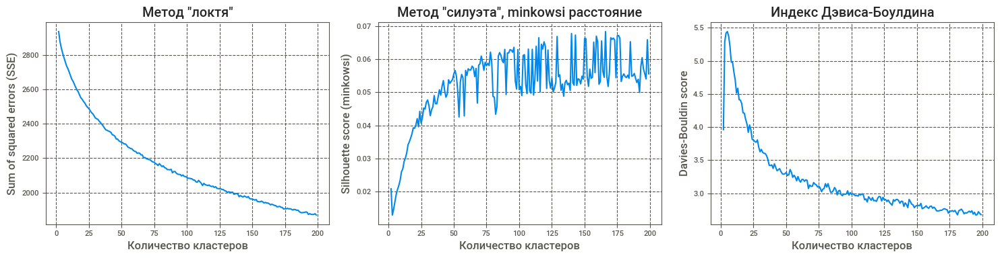

In [22]:
# задаю диапазон количества кластеров  
range_n_clusters = list(range(2, 200))

# создаю пустые списки для сохранение значений метрик
sse = []
s_score_mi=[]
db_score=[]

# сэмплирую датафрейм
eval_df = df_base_pr.sample(3000)

# произвожу расчёт метрик kmeans для разного количества кластеров
for n in range_n_clusters:
    kmeans = KMeans(
        n_clusters=n,
        init='k-means++',
        max_iter=100,
        n_init=5,
        algorithm='lloyd',
        random_state=RANDOM_STATE
    )
    labels = kmeans.fit_predict(eval_df)
    
    sse.append(kmeans.inertia_)
    s_score_mi.append(silhouette_score(eval_df, labels, metric='minkowski'))
    db_score.append(davies_bouldin_score(eval_df, labels))

# визуализирую результат
# делаю сетку для 3 графиков методом subplots
fig, axs = plt.subplots(1, 3, sharex=False, sharey=False, figsize=(15, 4))

# строю графики
axs[0].plot(range_n_clusters, sse)
axs[0].set_title('Метод "локтя"')
axs[0].set_xlabel('Количество кластеров')
axs[0].set_ylabel('Sum of squared errors (SSE)')
axs[0].grid(linestyle='--')

axs[1].plot(range_n_clusters, s_score_mi)
axs[1].set_title('Метод "силуэта", minkowsi расстояние')
axs[1].set_xlabel('Количество кластеров')
axs[1].set_ylabel('Silhouette score (minkowsi)')
axs[1].grid(linestyle='--')

axs[2].plot(range_n_clusters, db_score)
axs[2].set_title('Индекс Дэвиса-Боулдина')
axs[2].set_xlabel('Количество кластеров')
axs[2].set_ylabel('Davies-Bouldin score')
axs[2].grid(linestyle='--')

plt.tight_layout()
plt.show()

Метод локтя в диапазоне от  2 до 200 кластеров не показал явной точки перелома.<br>
Метод силуэта демонстрирует, что ярковыраженного оптимального количества кластеров нет, но наиболее высокие значения в диапазоне 150-170.<br>
Индекс Дэвиса-Боулдина также продолжает постоянно снижаться на всём рассматриваемом диапазоне количества кластеров без явного минимума.<br>
Продолжим изучение методов кластеризации и их результатов для датафрейма df_base.

### DBSCAN
Параметры, необходимые для алгоритма DBSCAN:
- eps — определяет окрестности вокруг точки данных. Если расстояние между двумя точками меньше или равно eps, то они считаются соседями.
- minPts — минимальное количество соседей (точек данных) в радиусе eps. Чем больше набор данных, тем большее значение minPts должно быть выбрано.

Считается, что minPts нужно задавать как 2 * [кол-во признаков].<br>
Оптимальное значение параметра ε установить сложнее. Воспользуемся поиском расстояния до k ближайщих соседей.

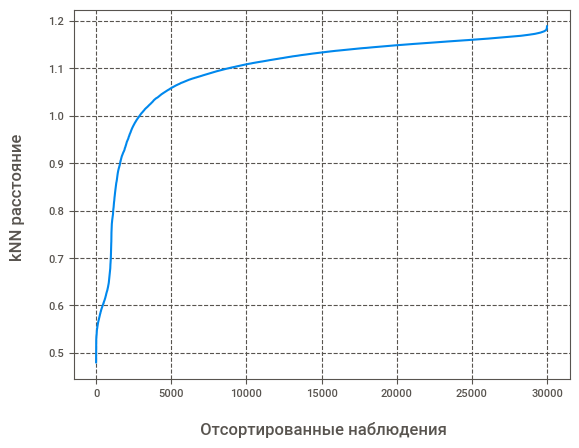

In [23]:
# сэмплирую датафрейм
eval_df = df_base_pr.sample(30000)

# устанавливаю значение n_neighbors равно [кол-во признаков] * 2
# для расчёта расстояния до соседей каждого наблюдения в датафрейме
nbrs = NearestNeighbors(n_neighbors = eval_df.shape[1] * 2).fit(eval_df)

# нахожу ближайшие вектора и расстояния до них для каждого наблюдения датафрейма
neigh_dist, neigh_ind = nbrs.kneighbors(eval_df)

# сортирую расстояния в возрастающем порядке
sort_neigh_dist = np.sort(neigh_dist, axis = 0)

# найдём расстояние до k-го соседа у каждого наблюдения и выведем график
k_dist = sort_neigh_dist[:, -1]

plt.plot(k_dist)
plt.ylabel('kNN расстояние \n')
plt.xlabel('\n Отсортированные наблюдения')
plt.grid(linestyle='--')

plt.show()

Чтобы исключить визуальное определение искомого расстояния, воспользуемся библиотекой kneed и методом KneeLocator().

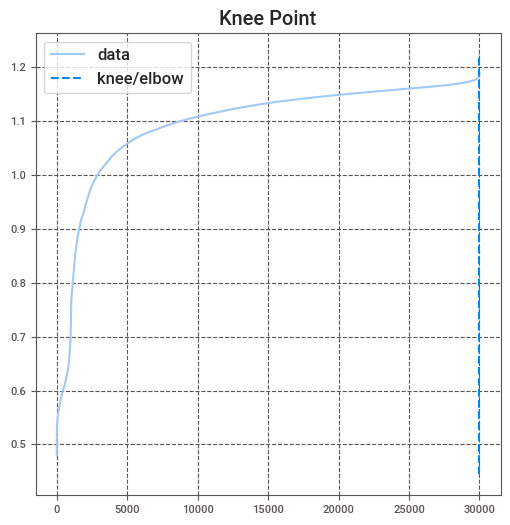

Точка искривления по оси y: 1.188
Количество соседей: 138


In [24]:
# исключаю визуальную идентификацию и применяю библиотеку kneed
kneedle = KneeLocator(
    x = range(1, len(neigh_dist) + 1), 
    y = k_dist, S = 1.0,
    curve = "concave", 
    direction = "increasing", 
    online=True
)

# вывожу график на экран
kneedle.plot_knee()
plt.grid(linestyle='--')
plt.show()

# получаю оценку точку искривления
print(color.BOLD + color.BLUE + 'Точка искривления по оси y: ' + color.END + str(round(kneedle.knee_y, 3)))
print(color.BOLD + color.BLUE + 'Количество соседей: ' + color.END + str(eval_df.shape[1] * 2))

С помощью представленных инструментов получаем следующие параметры:
- eps = 1.185
- minPts = 138

Попробуем также подобрать параметры с помощью цикла и метода силуэта - ищем при каких параметрах достигается максимальное значение функции.

In [25]:
# определяю диапазон изменений параметров
eps_list=np.arange(start=1.1, stop=1.3, step=0.025)
min_sample_list=np.arange(start=df_base_pr.shape[1] * 2 - 2, stop=df_base_pr.shape[1] * 2 + 3, step=1)

# создаю пустые списки для сохранения результатов
sil_score_list = []
trial_parameters_list = []

# циклом перебираю параметры
for eps_trial in eps_list:
    for min_sample_trial in min_sample_list:
        
        # инициализирую DBSCAN
        dbscan = DBSCAN(eps=eps_trial, min_samples=min_sample_trial, metric='euclidean', n_jobs=-1)
        
        if (len(np.unique(dbscan.fit_predict(eval_df)))>1):
            # выполняю расчёт метрики силуэта
            sil_score = silhouette_score(eval_df, dbscan.fit_predict(eval_df))
        
            # формирую значение переменной trial_parameters и заношу данные в списки
            trial_parameters = 'eps: ' + str(round(eps_trial, 3)) +'; min_sample: ' + str(min_sample_trial)
            sil_score_list.append(sil_score)
            trial_parameters_list.append(trial_parameters)

# формирую датафрейм с результатами
silhouette_scores_data = pd.DataFrame(data={
    'score' : sil_score_list,
    'parameters' : trial_parameters_list
})

# нахожу лучшие гиперпараметры сортировкой результатов
pd.options.display.float_format ='{:,.6f}'.format
display(silhouette_scores_data.sort_values(by='score', ascending=False).head(7))
pd.options.display.float_format ='{:,.3f}'.format

,score,parameters
4,0.001212,eps: 1.1; min_sample: 140
3,0.001174,eps: 1.1; min_sample: 139
2,0.001168,eps: 1.1; min_sample: 138
1,0.001145,eps: 1.1; min_sample: 137
0,0.001134,eps: 1.1; min_sample: 136
9,0.000365,eps: 1.125; min_sample: 140
7,0.000354,eps: 1.125; min_sample: 138


Получаем следующие параметры:
- eps = 1.1
- minPts = 140

Рассмотрим какое количество кластеров сформируется алгоритмом DBSCAN.

In [26]:
# инициализирую DBSCAN
dbscan = DBSCAN(
        eps=1.1, 
        min_samples=140, 
        metric='euclidean', 
        n_jobs=-1
    ).fit(eval_df)

# получаю список присвоенной метрики кластера каждому объекту
labels = dbscan.labels_

# вывожу список уникальных кластеров
print(color.BOLD + color.BLUE + 'Список уникальных кластеров: ' + color.END + str(set(labels)))

Список уникальных кластеров: {0, -1}


В результате алгоритм DBSCAN сформировал всего 1 кластер с меткой 0, остальные объекты отнесены к шуму (не могут быть отнесены ни к какому кластеру) с меткой -1.

### AgglomerativeClustering

Разобъём датафрейм df_base на кластеры с помощью агломеративной иерархической кластеризации.

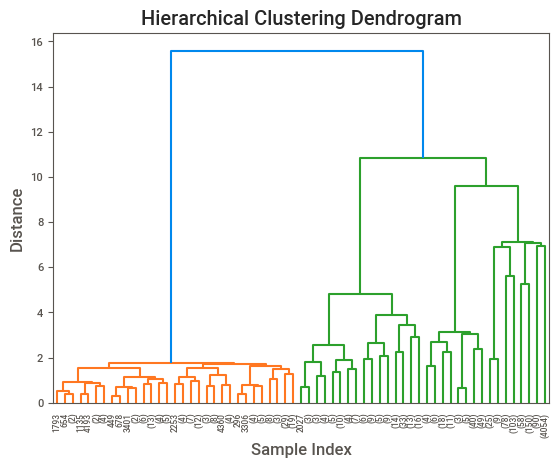

In [27]:
# сэмплирую датафрейм
eval_df = df_base_pr.sample(5000)

# выполняю иерархическую кластеризацию с методом Ward
linkage_matrix = linkage(eval_df, method='ward')

# визуализирую дендограмму до 5 уровня
dendrogram(linkage_matrix, truncate_mode='level', p=5)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

Из графика не очевидно на сколько кластеров можно поделить датафрейм, поэтому проведём поиск по диапазону значений от 2 до 199. В качестве метрики используем метод силуэта.

In [28]:
# задаю диапазон количества кластеров
n_clusters_range = list(range(100, 200))

# создаю пустой список для сохранение значений метрики
sil_score_list = []

# Determine the optimal number of clusters using the silhouette score
for n_clusters in n_clusters_range:
    agl_clustering = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    labels = agl_clustering.fit_predict(eval_df)
    sil_score = silhouette_score(eval_df, labels)

    # формирую значение переменной trial_parameters и заношу метрику в список
    sil_score_list.append(sil_score)

# формирую датафрейм с результатами
silhouette_scores_data = pd.DataFrame(data={
    'Кол-во кластеров' : n_clusters_range,
    'Метрика' : sil_score_list
    
})

# нахожу лучшие гиперпараметры сортировкой результатов
pd.options.display.float_format ='{:,.6f}'.format
display(silhouette_scores_data.sort_values(by='Метрика', ascending=False).head(7))
pd.options.display.float_format ='{:,.3f}'.format

,Кол-во кластеров,Метрика
99,199,0.047084
98,198,0.046840
95,195,0.046783
96,196,0.046727
94,194,0.046577
97,197,0.046565
93,193,0.046504


Получили, что метрика силуэта максимальна, при разбиении данных на 199 кластеров. Метрика постоянно растёт, и это повторяет результаты KMeans.

**Промежуточные выводы:**

Все три метода кластеризации не выявили однозначно рекомендуемого количества делений датафрейма на кластеры.<br>
Данные однородны и равномерно распространены по n-мерному пространству признаков.

## Мэтчинг с кластеризацией

Так как нет рекомендуемого количества кластеров для разбиения датафрейма, допустим деление на 5 областей. Проведём кластеризацию для 5 кластеров.
Получим центройды созданных кластеров и определим ближайщий центройд для каждого объекта в df_train. Далее циклом переберём все кластеры. 
Затем с помощью метода NearestNeighbors найдём похожий товар из каждого кластера df_base для каждого объекта df_train, где ближайший центройд соответствует своему кластеру.

In [29]:
# учитываю стартовое время
start_time = time.time()

# делаю копию датафреймов для проведения мэтчинга с кластеризацией
df_base_pr_clusters = df_base_pr.copy()
df_validation_pr_clusters = df_validation_pr.copy()

# инициализирую KMeans
kmeans = KMeans(
    n_clusters=10,
    init='random',
    n_init=5,
    max_iter=150,
    algorithm='lloyd',
    random_state=RANDOM_STATE
)

# получаю принадлежность к кластеру для каждого объекта
labels = kmeans.fit_predict(df_base_pr_clusters)

# добавляю метку кластера в датафрейм df_base_pr и валидирую результат
df_base_pr_clusters['cluster'] = labels
print('\n'+ color.BOLD + color.BLUE + 'Датафрейм "df_base_pr_clusters" с номером кластера:' + color.END)
display(df_base_pr_clusters.head())

# получаю центройды кластеров
centroids = kmeans.cluster_centers_

# создаю функцию для определения ближайщего центройда
def centroid_distance(row):
    distances_to_centroids = np.linalg.norm(centroids - row.values, axis=1)
    closest_centroid_index = np.argmin(distances_to_centroids)
    
    return closest_centroid_index

# применяю функцию и создаю новый столбец с индексом центройда
df_validation_pr_clusters['cluster'] = df_validation_pr_clusters.apply(centroid_distance, axis=1)
print('\n'+ color.BOLD + color.BLUE + 'Датафрейм "df_validation_pr_clusters" с индексом ближайшего центройда:' + color.END)
display(df_validation_pr_clusters.head())

# создаю пустые списки для сохранения результатов подбора
validation_index = []
base_match = []

# циклом перебираю все кластера
for c in range(0, len(centroids)):
    # формирую отфильтрованные датафреймы
    df_from = df_base_pr_clusters.loc[df_base_pr_clusters['cluster'] == c, df_base_pr_clusters.columns != 'cluster']
    df_for = df_validation_pr_clusters.loc[df_validation_pr_clusters['cluster'] == c, df_validation_pr_clusters.columns != 'cluster']
    
    # проверяю, что для каждого клстера имеются значения
    if df_from.shape[0] > 1 and df_for.shape[0] > 1:
        # инициализирую и обучаю алгоритм NearestNeighbors
        knn = NearestNeighbors(n_neighbors = 3, metric='euclidean')
        knn.fit(df_from)

        # выполняю мэтчинг для данных из df_train
        # нахожу дистанцию и метку похожих товаров внутри кластера
        distances, indicies = knn.kneighbors(df_for)

        # сохраняю результаты
        validation_index = validation_index + list(df_for.index)
        base_match = base_match + list([x[0] for x in indicies])

# создаю датафрейм с результатми
df_cluster_result = pd.DataFrame(data={
    'validation_index' : validation_index,
    'base_match' : base_match
})

# добавляю Target и Id для сравнения
df_cluster_result = df_cluster_result.merge(df_validation_answer['Expected'], how='left', left_on='validation_index', right_on=df_validation_answer.index)
df_cluster_result = df_cluster_result.merge(df_base['Id'], how='left', left_on='base_match', right_on=df_base.index)

# добавляю колонку с результатом сравнения Target и Id
df_cluster_result['Result'] = (df_cluster_result['Expected'] == df_cluster_result['Id']) * 1

# учитываю конечное время
end_time = time.time()

# рассчитываю время затраченное на поиск похожих товаров
matching_time = end_time - start_time

# вывожу на экран получившийся датафрейм
print('\n'+ color.BOLD + color.BLUE + 'Датафрейм с результатами подбора:' + color.END)
display(df_cluster_result.sample(5))

# вывожу процент верно подобранных товаров
print(f'Процент верно подобранных товаров {round(df_cluster_result["Result"].mean() * 100, 3)}')

# вывожу на экран время на выполнение мэтчинга с кластеризацией
print(f'Время на выполнение мэтчинга с кластеризацией: {round(matching_time, 2)} сек.')


Датафрейм "df_base_pr_clusters" с номером кластера:


df_base,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71,cluster
0,0.179,0.155,0.170,0.076,0.104,0.254,0.021,-0.128,0.079,-0.130,0.041,0.154,-0.159,0.108,0.090,0.088,0.200,0.248,-0.012,-0.136,-0.045,-0.128,0.029,0.158,-0.026,-0.003,-0.026,0.082,0.143,-0.196,-0.096,0.010,0.207,0.075,-0.016,-0.192,-0.119,0.004,-0.010,0.077,-0.035,-0.102,0.167,-0.060,-0.102,-0.009,0.004,0.174,-0.102,0.086,0.089,-0.021,0.095,-0.047,-0.112,0.268,0.051,-0.127,-0.042,0.018,0.025,-0.009,0.165,-0.041,-0.048,0.158,-0.205,0.201,0.057,7
1,0.064,-0.076,0.077,0.061,-0.029,0.005,-0.077,-0.278,-0.259,0.143,-0.123,0.233,-0.180,-0.025,-0.045,-0.110,-0.169,-0.054,-0.065,-0.083,0.096,-0.145,-0.046,-0.096,0.214,-0.112,0.089,0.169,-0.198,0.099,-0.065,-0.083,0.180,0.059,-0.026,-0.010,0.093,-0.020,-0.080,-0.115,0.139,0.196,-0.133,0.005,-0.033,0.061,0.028,0.047,-0.227,-0.108,0.042,-0.250,0.092,-0.059,-0.068,-0.141,-0.062,-0.130,-0.183,-0.035,-0.118,-0.051,-0.048,-0.150,-0.004,-0.032,-0.165,0.100,-0.072,7
2,0.003,-0.197,-0.011,-0.065,-0.036,-0.040,0.156,0.105,0.012,-0.033,-0.018,0.034,0.059,-0.101,-0.070,-0.308,0.196,0.084,0.016,0.024,-0.277,-0.004,0.015,-0.002,-0.138,0.112,-0.089,-0.287,0.092,0.063,0.268,-0.203,-0.168,-0.007,0.113,-0.113,0.229,0.041,-0.053,0.234,0.158,-0.003,-0.099,0.044,-0.169,0.099,-0.044,0.096,-0.222,-0.075,0.027,0.060,0.095,0.069,0.026,0.062,-0.079,-0.042,-0.040,0.118,0.076,0.032,0.060,-0.065,0.005,0.244,-0.011,-0.021,0.067,2
3,-0.092,0.176,-0.005,-0.069,-0.081,0.097,0.131,0.034,-0.005,-0.026,-0.051,0.003,0.124,0.101,-0.100,0.083,0.170,-0.024,0.110,-0.024,-0.172,-0.286,0.046,0.019,0.007,-0.065,0.134,-0.144,0.088,-0.020,-0.031,0.008,-0.099,0.302,-0.216,-0.267,-0.011,0.082,0.017,-0.027,-0.100,-0.091,0.174,0.117,0.163,0.034,0.047,0.084,0.015,-0.081,0.031,-0.022,0.157,0.020,-0.041,-0.124,-0.087,0.048,-0.058,-0.225,-0.034,-0.379,0.020,-0.204,0.077,-0.005,0.099,0.135,-0.076,1
4,0.058,0.082,0.014,-0.095,-0.163,-0.039,-0.113,0.087,-0.026,0.130,-0.041,-0.016,-0.110,0.017,-0.013,-0.120,0.075,0.018,-0.171,0.232,-0.100,0.064,-0.141,0.001,-0.039,0.132,-0.023,-0.236,0.108,-0.058,0.078,0.120,-0.162,0.094,-0.097,-0.135,0.149,-0.097,-0.159,-0.100,-0.240,-0.233,-0.138,0.048,0.150,0.113,-0.109,0.038,0.127,-0.019,-0.025,0.139,-0.186,0.002,-0.077,0.026,0.041,-0.015,0.174,-0.006,0.201,0.088,0.015,0.205,0.115,-0.151,-0.272,0.107,0.139,5



Датафрейм "df_validation_pr_clusters" с индексом ближайшего центройда:


df_validation,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,71,cluster
0,0.115,0.022,0.046,0.066,-0.068,-0.312,0.128,0.003,0.046,-0.028,0.033,-0.247,-0.189,-0.047,0.084,0.029,-0.153,-0.004,-0.174,-0.338,0.019,0.228,0.102,0.091,0.119,-0.004,0.019,0.156,0.025,0.097,0.108,0.046,0.008,0.002,-0.104,0.070,0.045,-0.138,-0.091,0.060,0.200,0.077,0.043,-0.022,0.087,-0.036,-0.187,0.092,0.149,0.118,-0.099,0.157,0.166,-0.163,0.133,-0.057,0.140,-0.114,0.215,0.016,-0.083,0.194,0.089,0.045,0.044,0.020,0.021,0.112,0.077,7
1,-0.093,0.055,0.095,0.186,0.072,-0.058,-0.155,0.044,-0.166,-0.058,-0.075,0.006,0.018,-0.011,-0.283,-0.052,0.151,0.177,0.065,-0.143,0.185,-0.050,0.031,0.074,0.134,0.217,-0.242,0.073,-0.010,-0.104,-0.238,-0.052,-0.062,0.055,0.184,0.209,0.009,-0.080,0.078,0.153,-0.012,-0.054,-0.061,-0.027,0.228,0.335,-0.129,-0.043,-0.140,-0.058,-0.173,-0.028,0.012,0.121,0.029,-0.023,0.015,-0.072,-0.104,0.021,0.127,0.063,0.158,0.118,0.001,-0.021,0.073,-0.021,-0.086,8
2,-0.152,-0.272,-0.064,-0.054,0.116,0.164,-0.042,0.059,-0.020,-0.121,0.147,0.174,-0.032,0.149,-0.027,0.177,-0.092,-0.052,0.002,-0.079,0.112,-0.008,-0.101,-0.078,-0.011,-0.006,-0.012,-0.166,0.159,0.020,0.010,-0.064,0.094,0.032,0.134,-0.012,0.042,0.138,0.009,-0.264,-0.155,0.085,0.037,0.026,-0.328,0.092,0.024,0.119,0.244,-0.005,0.030,-0.002,0.092,0.172,-0.084,-0.042,0.290,0.121,-0.160,0.152,-0.134,0.056,0.059,-0.019,0.021,0.183,0.120,0.105,0.049,0
3,-0.028,-0.073,0.014,0.091,-0.134,-0.151,0.044,-0.208,0.219,0.154,-0.161,0.094,0.097,-0.124,0.035,-0.155,-0.115,0.104,0.019,-0.116,0.106,-0.186,-0.078,-0.124,0.072,0.040,-0.005,0.112,-0.001,0.029,-0.002,0.097,-0.126,0.005,0.094,0.024,-0.070,0.036,-0.009,-0.046,-0.022,0.099,-0.159,0.159,-0.163,0.231,0.140,-0.018,0.012,0.130,-0.019,0.032,0.172,0.029,-0.324,0.041,-0.159,-0.006,0.224,-0.130,-0.133,0.093,-0.082,-0.174,0.007,0.269,0.110,0.014,-0.134,8
4,0.081,0.068,-0.089,-0.019,-0.260,0.086,-0.060,-0.043,0.062,0.013,0.026,0.073,-0.318,-0.027,-0.035,0.109,-0.059,0.031,0.023,-0.045,0.097,-0.099,-0.154,-0.090,0.007,-0.112,0.007,-0.192,0.071,0.097,-0.027,0.182,0.013,-0.172,-0.198,0.001,0.235,-0.071,-0.039,-0.249,-0.076,-0.120,-0.134,-0.013,0.166,0.080,-0.228,-0.022,-0.034,0.272,0.066,0.021,-0.123,0.261,-0.047,-0.005,-0.030,-0.011,0.154,0.048,-0.132,0.047,-0.029,0.107,-0.000,-0.173,0.128,-0.177,0.001,7



Датафрейм с результатами подбора:


,validation_index,base_match,Expected,Id,Result
6285,6259,37392,395744-base,3904895-base,0
5291,2631,907,229174-base,3020716-base,0
2602,8124,14267,17253-base,421991-base,0
7884,3315,41620,1421404-base,2084373-base,0
6662,7636,190,3512205-base,75837-base,0


Процент верно подобранных товаров 0.0
Время на выполнение мэтчинга с кластеризацией: 6.21 сек.


<div class="alert alert-info">
<b>Комментарий студента</b>

Уважаемый ревьюер, пожалуйста, подскажи в чём может быть ошибка моего подхода в поиске лучшего товара с кластеризацией?<br>
Я пробовал много разных вариантов, но не выходит получить даже 1% accuracy.

</div>

## Мэтчинг с помощью FAISS

In [30]:
# формирую словарь из индексов объектов и значнеий ID из датафрейма df_base
base_index = {k : v for k, v in zip(df_base.index.to_list(), df_base['Id'])}

# задаю количество признаков
dims = df_base_pr.shape[1]

# задаю кол-во искомых похожих товаров
candidate_number = 5

# создаю пустые списки для сохранения результатов
n_cells_list = []
nprobe_list = []
acc5_list = []
time_list = []

# циклом перебираю разное кол-во кластеров и кластеров-соседей для поиска
for n in range(5, 50, 5):
    for p in range (1, 5):
        
        # учитываю стартовое время
        start_time = time.time()

        # задаю количество кластеров
        n_cells = n

        # инициализирую индекс FAISS
        quantiser = faiss.IndexFlatL2(dims)
        idx_l2 = faiss.IndexIVFFlat(quantiser, dims, n_cells)

        # выполняю обучение индекса
        idx_l2.train(np.ascontiguousarray(df_base_pr.values).astype('float32'))

        # добавляю вектора в индекс
        idx_l2.add(np.ascontiguousarray(df_base_pr.values).astype('float32'))

        # задаю кол-во кластеров для поиска
        idx_l2.nprobe = p

        # произвожу поиск
        # dist, idx = idx_l2.search(np.ascontiguousarray(df_train_pr.values).astype('float32'), candidate_number)
        dist, idx = idx_l2.search(np.ascontiguousarray(df_validation_pr.values).astype('float32'), candidate_number)

        # произвожу расчёт метрики accuracy@5
        acc = 0
        # for target, el in zip(df_train['Target'].values.tolist(), idx.tolist()):
        for target, el in zip(df_validation_answer['Expected'].values.tolist(), idx.tolist()):
            acc += int(target in [base_index[v] for v in el])
        
        # учитываю конечное время
        end_time = time.time()

        # рассчитываю время затраченное на поиск похожих товаров
        matching_time = end_time - start_time
        
        # заношу результаты в списки
        n_cells_list.append(n)
        nprobe_list.append(p)
        acc5_list.append(round(100 * acc / len(idx), 2))
        time_list.append(round(matching_time, 2))

# формирую датафрейм с результатами
faiss_results_df = pd.DataFrame(data={
    'Деление на кластеры' : n_cells_list,
    'Поиск в кластерах' : nprobe_list,
    'Accuracy@5, %' : acc5_list,
    'Время на подбор, сек.' : time_list
})

# нахожу лучшие гиперпараметры сортировкой результатов
display(faiss_results_df.sort_values(by='Accuracy@5, %', ascending=False).head(7))

,Деление на кластеры,Поиск в кластерах,"Accuracy@5, %","Время на подбор, сек."
3,5,4,76.220,18.550
11,15,4,75.430,7.510
7,10,4,75.420,10.240
2,5,3,75.160,14.580
15,20,4,74.780,5.250
19,25,4,74.550,4.180
6,10,3,74.370,7.810


Подбор похожих товаров с помощью алгоритма FAISS с индексом IVF (Inverted File) показал лучшую метрику Accuracy@5 при делении данных df_base на 5 кластерах и поиске в 4 ближайщих к лучшему центройду кластерах. Метрика составила 76,2% и рассчитана за порядка 20 секунд.

## Общий вывод

1. Заказчик предоставил данные в 4 файлах:
    - `base.csv` - анонимизированный набор товаров. Каждый товар представлен как уникальный id (0-base, 1-base, 2-base) и вектор признаков размерностью 72.
    - `train.csv` - обучающий датасет. Каждая строчка - один товар, для которого известен уникальный id (0-query, 1-query, …), вектор признаков И id товара из base.csv, который максимально похож на него (по мнению экспертов).
    - `validation.csv` - датасет с товарами (уникальный id и вектор признаков), для которых надо найти наиболее близкие товары из base.csv
    - `validation_answer.csv` - правильные ответы к предыдущему файлу 'validation.csv'.
    Каждый объект множества описывается какими-то анонимизированными признаками.
<br><br>

2. Были поставлены задачи:
    - разработать алгоритм, который для всех товаров из множества A предложит несколько вариантов наиболее похожих товаров из множества B;
    - оценить качество алгоритма по метрике accuracy@5:<br><br>
        $accuracy@5 = 100 * \frac{n}{5}$,<br><br>
        где n - количество верно определённых похожих объектов из 5 возможных.
<br><br>

3. Выполнена загрузка файлов, все значения корректно распределены по столбцам:
    - `df_base` состоит из 291 813 строк и 73 столбцов, не имеет пропусков, все колонки кроме id типа float64.
    - `df_train` состоит из 9 999 строк и 74 столбцов, не имеет пропусков, все колонки кроме id и target типа float64.
    - `df_validation` состоит из 10 000 строк и 73 столбцов, не имеет пропусков, все колонки кроме id типа float64.
    - `df_validation_answer` состоит из 10 000 строк и 2 столбцов, не имеет пропусков, все колонки типа object.
<br><br>

4. В процессе предобработки данных:
    - наименования колонок не требовали преобразования;
    - пропусков не обнаружено;
    - исправлены типы данных;
    - обнаружены и исключены явные дубликаты;
    - неявные дубликаты или аномалии отсутствуют;
    - добавление новых столбцов не потребовалось.
<br><br>

5. Предобработка не потребовала значительного удаления информации, потому более 96% данных представлено к дальнейшему анализу.
<br><br>

6. Результаты исследовательского анализа данных:
    - подавляющее большинство признаков (89%) имеют нормальное распределение;
    - признак `6` распределён практически равномерно, видны 2 моды;
    - признаки `21` и `25` - практически константа с модой в значениях 1500 и 800, соответственно. Исключим их из датасета;
    - признак `33` имеет мультимодальное распределение;
    - признак `44` распределён практически равномерно с пиком в значении около -65;
    - признаки `59` и `65` имеют равномерное распределение;
    - признак `70` - также практически константа с модой в значении -1100. Исключим его из всех датафреймов;
    - попарное визуальное сравнение признаков для датафреймов [df_base <> df_train] и [df_train <>> df_validation] показали, что распределния данных в каждой колонке практически идентично. Тренировочная и валидационная выборки репрезентативно представлены;
    - матрицы корреляций для 3 датасетов не показали столбцов с мультиколинеарностью;
    - признак 63 имеет более тесную связь с другими столбцами, но эта связь преимущественно ниже 0.5.
<br><br>

7. Осуществлена подготвка датафреймов: данные масштабированы и нормализованы.
<br><br>

8. Проведён поиск похожих товаров без кластеризации датафрейма df_base с помощью алгоритма kNN и метода NearestNeighbors.<br>
Верно определно 70% товаров для датасета df_train с применением расстояния Manhattan за 28 секунд.
<br><br>

9. Выполнен анализ датафрейма df_base на возможность разбиения его на кластеры. рассматривались методы KMeans, DBSCAN и AgglomerativeClustering. Для оценки результатов применялись метод локтя, метод силуэта и индекс Дэвиса-Боулдина. Все три метода кластеризации не выявили однозначно рекомендуемого количества делений датафрейма на кластеры. Данные однородны и равномерно распространены по n-мерному пространству признаков.
<br><br>

10. Несмотря на выводы из анализа кластеризации, осуществлён мэтчинг товаров с разбиением на 5 кластеров. Скорость выполнения подбора значительно сократилась, но метрика accuracy составляет 0%.
<br><br>

11. Выполнен поиск похожих товаров с помощью алгоритма FAISS с индексом IVF (Inverted File). Он показал лучшую метрику Accuracy@5 при делении данных df_base на 5 кластерах и поиске в 4 ближайщих к лучшему центройду кластерах. Метрика составила 76,2% и рассчитана за 20 секунд.